## Germany & neighbors PV Cut Scenario due to Volcanic Eruption with 130 €/t CO2 price. Transmission Expansion is not allowed

In [1]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import xarray as xr
import seaborn as sns
import os

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


# Base Scenario

## Import Network

In [2]:
country = 'DE'
buses = '20'
le = '1.0'

In [3]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\elec_s_20_ec_lv1.0_168h.nc")

INFO:pypsa.io:Imported network elec_s_20_ec_lv1.0_168h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [4]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [5]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 20 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 27 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 28 entries
Component 'Load' has 20 entries
Component 'Generator' has 261 entries
Component 'StorageUnit' has 65 entries


In [6]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [7]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

#### Import solved model, if no changes to the model have been made

In [8]:
def import_nc_file(directory, filename):
    # Construct the full path to the .nc file
    file_path = os.path.join(directory, filename)
    
    # Open the NetCDF file using xarray
    ds = pypsa.Network(file_path)
    
    return ds
directory = os.getcwd()
dir = 'c:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes'


In [9]:
#solve network
n.optimize(solver_name='gurobi')
#filename = "base_DE_20nodes_1.5_solved_168h.nc"
#n = import_nc_file(dir, filename)
contingency = 'pv'
n.name = f'base_{contingency}'

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 10/10 [00:00<00:00, 88.49it/s]
INFO:linopy.io: Writing time: 0.85s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bo7sne7z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bo7sne7z.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59446 rows, 27740 columns, 108191 nonzeros


INFO:gurobipy:obj: 59446 rows, 27740 columns, 108191 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59446 rows, 27740 columns and 108191 nonzeros


INFO:gurobipy:Optimize a model with 59446 rows, 27740 columns and 108191 nonzeros


Model fingerprint: 0x4867858d


INFO:gurobipy:Model fingerprint: 0x4867858d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 43455 rows and 7595 columns


INFO:gurobipy:Presolve removed 43455 rows and 7595 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 15991 rows, 20145 columns, 56294 nonzeros


INFO:gurobipy:Presolved: 15991 rows, 20145 columns, 56294 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.04s


INFO:gurobipy:Ordering time: 0.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 40


INFO:gurobipy: Dense cols : 40


 AA' NZ     : 1.541e+05


INFO:gurobipy: AA' NZ     : 1.541e+05


 Factor NZ  : 7.916e+05 (roughly 20 MB of memory)


INFO:gurobipy: Factor NZ  : 7.916e+05 (roughly 20 MB of memory)


 Factor Ops : 1.275e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.275e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.04123457e+12 -8.56320024e+13  8.67e+05 5.53e+03  2.75e+10     0s


INFO:gurobipy:   0   4.04123457e+12 -8.56320024e+13  8.67e+05 5.53e+03  2.75e+10     0s


   1   3.77755593e+12 -4.64742522e+13  5.36e+05 5.40e+04  1.26e+10     0s


INFO:gurobipy:   1   3.77755593e+12 -4.64742522e+13  5.36e+05 5.40e+04  1.26e+10     0s


   2   2.33273514e+12 -2.65915705e+13  9.31e+04 1.06e+04  2.64e+09     0s


INFO:gurobipy:   2   2.33273514e+12 -2.65915705e+13  9.31e+04 1.06e+04  2.64e+09     0s


   3   1.74283839e+12 -7.90582083e+12  7.94e+03 5.84e+02  3.34e+08     0s


INFO:gurobipy:   3   1.74283839e+12 -7.90582083e+12  7.94e+03 5.84e+02  3.34e+08     0s


   4   8.54313312e+11 -2.09811340e+12  6.28e+02 1.10e+02  7.52e+07     0s


INFO:gurobipy:   4   8.54313312e+11 -2.09811340e+12  6.28e+02 1.10e+02  7.52e+07     0s


   5   5.42603268e+11 -1.30569331e+12  3.06e+02 5.99e+01  4.52e+07     1s


INFO:gurobipy:   5   5.42603268e+11 -1.30569331e+12  3.06e+02 5.99e+01  4.52e+07     1s


   6   2.84922201e+11 -4.38105256e+11  1.14e+02 5.14e+00  1.71e+07     1s


INFO:gurobipy:   6   2.84922201e+11 -4.38105256e+11  1.14e+02 5.14e+00  1.71e+07     1s


   7   1.39262928e+11 -1.32132968e+11  2.88e+01 1.95e-09  6.28e+06     1s


INFO:gurobipy:   7   1.39262928e+11 -1.32132968e+11  2.88e+01 1.95e-09  6.28e+06     1s


   8   9.36632915e+10 -5.35941417e+10  1.17e+01 1.13e-09  3.39e+06     1s


INFO:gurobipy:   8   9.36632915e+10 -5.35941417e+10  1.17e+01 1.13e-09  3.39e+06     1s


   9   7.68474755e+10  8.79582750e+09  6.63e+00 3.92e-10  1.56e+06     1s


INFO:gurobipy:   9   7.68474755e+10  8.79582750e+09  6.63e+00 3.92e-10  1.56e+06     1s


  10   6.81168149e+10  2.71008394e+10  4.32e+00 1.86e-10  9.41e+05     1s


INFO:gurobipy:  10   6.81168149e+10  2.71008394e+10  4.32e+00 1.86e-10  9.41e+05     1s


  11   5.86286080e+10  3.83567708e+10  2.01e+00 1.69e-10  4.65e+05     1s


INFO:gurobipy:  11   5.86286080e+10  3.83567708e+10  2.01e+00 1.69e-10  4.65e+05     1s


  12   5.40901067e+10  4.45885139e+10  9.92e-01 8.82e-11  2.18e+05     1s


INFO:gurobipy:  12   5.40901067e+10  4.45885139e+10  9.92e-01 8.82e-11  2.18e+05     1s


  13   5.28660247e+10  4.74917776e+10  7.38e-01 8.63e-11  1.23e+05     1s


INFO:gurobipy:  13   5.28660247e+10  4.74917776e+10  7.38e-01 8.63e-11  1.23e+05     1s


  14   5.16534209e+10  4.81442864e+10  4.89e-01 7.75e-11  8.04e+04     1s


INFO:gurobipy:  14   5.16534209e+10  4.81442864e+10  4.89e-01 7.75e-11  8.04e+04     1s


  15   5.07564397e+10  4.84088235e+10  3.12e-01 5.54e-11  5.38e+04     1s


INFO:gurobipy:  15   5.07564397e+10  4.84088235e+10  3.12e-01 5.54e-11  5.38e+04     1s


  16   5.00583567e+10  4.86472434e+10  1.70e-01 5.91e-11  3.23e+04     1s


INFO:gurobipy:  16   5.00583567e+10  4.86472434e+10  1.70e-01 5.91e-11  3.23e+04     1s


  17   4.96263065e+10  4.88892762e+10  8.57e-02 6.05e-11  1.69e+04     1s


INFO:gurobipy:  17   4.96263065e+10  4.88892762e+10  8.57e-02 6.05e-11  1.69e+04     1s


  18   4.94403936e+10  4.90375655e+10  5.03e-02 7.12e-11  9.22e+03     1s


INFO:gurobipy:  18   4.94403936e+10  4.90375655e+10  5.03e-02 7.12e-11  9.22e+03     1s


  19   4.93051316e+10  4.90769371e+10  2.46e-02 8.47e-11  5.22e+03     1s


INFO:gurobipy:  19   4.93051316e+10  4.90769371e+10  2.46e-02 8.47e-11  5.22e+03     1s


  20   4.92697825e+10  4.91048735e+10  1.78e-02 7.56e-11  3.78e+03     1s


INFO:gurobipy:  20   4.92697825e+10  4.91048735e+10  1.78e-02 7.56e-11  3.78e+03     1s


  21   4.92180350e+10  4.91344274e+10  8.46e-03 1.05e-10  1.91e+03     1s


INFO:gurobipy:  21   4.92180350e+10  4.91344274e+10  8.46e-03 1.05e-10  1.91e+03     1s


  22   4.91830205e+10  4.91544332e+10  2.23e-03 7.15e-11  6.54e+02     1s


INFO:gurobipy:  22   4.91830205e+10  4.91544332e+10  2.23e-03 7.15e-11  6.54e+02     1s


  23   4.91700359e+10  4.91629427e+10  1.98e-04 1.01e-10  1.62e+02     1s


INFO:gurobipy:  23   4.91700359e+10  4.91629427e+10  1.98e-04 1.01e-10  1.62e+02     1s


  24   4.91689099e+10  4.91666509e+10  5.48e-05 6.67e-11  5.17e+01     1s


INFO:gurobipy:  24   4.91689099e+10  4.91666509e+10  5.48e-05 6.67e-11  5.17e+01     1s


  25   4.91684460e+10  4.91677821e+10  1.53e-05 2.13e-10  1.52e+01     1s


INFO:gurobipy:  25   4.91684460e+10  4.91677821e+10  1.53e-05 2.13e-10  1.52e+01     1s


  26   4.91682958e+10  4.91681806e+10  4.18e-06 9.61e-11  2.64e+00     2s


INFO:gurobipy:  26   4.91682958e+10  4.91681806e+10  4.18e-06 9.61e-11  2.64e+00     2s


  27   4.91682427e+10  4.91682323e+10  7.14e-06 7.27e-11  2.38e-01     2s


INFO:gurobipy:  27   4.91682427e+10  4.91682323e+10  7.14e-06 7.27e-11  2.38e-01     2s


  28   4.91682392e+10  4.91682372e+10  9.58e-07 1.28e-10  4.56e-02     2s


INFO:gurobipy:  28   4.91682392e+10  4.91682372e+10  9.58e-07 1.28e-10  4.56e-02     2s


  29   4.91682385e+10  4.91682382e+10  1.35e-07 1.92e-10  6.91e-03     2s


INFO:gurobipy:  29   4.91682385e+10  4.91682382e+10  1.35e-07 1.92e-10  6.91e-03     2s


  30   4.91682384e+10  4.91682383e+10  1.22e-08 8.27e-11  7.01e-04     2s


INFO:gurobipy:  30   4.91682384e+10  4.91682383e+10  1.22e-08 8.27e-11  7.01e-04     2s


  31   4.91682384e+10  4.91682384e+10  8.00e-08 9.56e-11  5.92e-05     2s


INFO:gurobipy:  31   4.91682384e+10  4.91682384e+10  8.00e-08 9.56e-11  5.92e-05     2s


  32   4.91682384e+10  4.91682384e+10  4.77e-09 1.79e-10  2.06e-06     2s


INFO:gurobipy:  32   4.91682384e+10  4.91682384e+10  4.77e-09 1.79e-10  2.06e-06     2s


  33   4.91682384e+10  4.91682384e+10  3.35e-10 6.41e-11  1.48e-08     2s


INFO:gurobipy:  33   4.91682384e+10  4.91682384e+10  3.35e-10 6.41e-11  1.48e-08     2s


  34   4.91682384e+10  4.91682384e+10  1.46e-10 1.66e-10  1.04e-10     2s


INFO:gurobipy:  34   4.91682384e+10  4.91682384e+10  1.46e-10 1.66e-10  1.04e-10     2s


INFO:gurobipy:


Barrier solved model in 34 iterations and 1.78 seconds (0.56 work units)


INFO:gurobipy:Barrier solved model in 34 iterations and 1.78 seconds (0.56 work units)


Optimal objective 4.91682384e+10


INFO:gurobipy:Optimal objective 4.91682384e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    9915 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:    9915 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


     191 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     191 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2499722e-09      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2499722e-09      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4993    4.9168238e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    4993    4.9168238e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 4993 iterations and 1.94 seconds (0.62 work units)


INFO:gurobipy:Solved in 4993 iterations and 1.94 seconds (0.62 work units)


Optimal objective  4.916823836e+10


INFO:gurobipy:Optimal objective  4.916823836e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27740 primals, 59446 duals
Objective: 4.92e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

### Export model for later use

In [10]:
file = f"{country}_{buses}_{le}_base_solved_168h.nc"
output_path = os.path.join(dir, file)

n.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network DE_20_1.0_base_solved_168h.nc has links, generators, storage_units, buses, lines, loads, global_constraints, carriers


<xarray.Dataset> Size: 269kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, links_i: 28,
                                           links_t_p0_i: 12, links_t_p1_i: 12,
                                           generators_i: 261,
                                           generators_t_p_max_pu_i: 81,
                                           generators_t_p_i: 98,
                                           ...
                                           lines_t_p1_i: 27,
                                           lines_t_loss_i: 27, loads_i: 20,
                                           loads_t_p_set_i: 20,
                                           loads_t_p_i: 20,
                                           global_constraints_i: 1,
                                           carriers_i: 21)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * links_i                               (links_i) object 224B '14801' ... '...
  * links_t_p0_i                          (links_t_p0_i) object 96B '14805' ....
  * links_t_p1_i                          (links_t_p1_i) object 96B '14805' ....
  * generators_i                          (generators_i) object 2kB 'AT1 0 CC...
    ...                                    ...
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
  * loads_i                               (loads_i) object 160B 'AT1 0' ... '...
  * loads_t_p_set_i                       (loads_t_p_set_i) object 160B 'AT1 ...
  * loads_t_p_i                           (loads_t_p_i) object 160B 'AT1 0' ....
  * global_constraints_i                  (global_constraints_i) object 8B 'l...
  * carriers_i                            (carriers_i) object 168B 'AC' ... '...
Data variables: (12/98)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    global_constraints_carrier_attribute  (global_constraints_i) object 8B 'A...
    global_constraints_sense              (global_constraints_i) object 8B '<='
    global_constraints_constant           (global_constraints_i) float64 8B 1...
    carriers_co2_emissions                (carriers_i) float64 168B 0.0 ... 0.0
    carriers_color                        (carriers_i) object 168B '#70af1d' ...
    carriers_nice_name                    (carriers_i) object 168B 'AC' ... '...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                base_pv
    network_objective:           49168238361.87465
    network_objective_constant:  18417213809.827305
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {"version": "0.10.0", "tutorial": false, "lo...

In [11]:
tot_cos_base=n.objective/1e9

marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


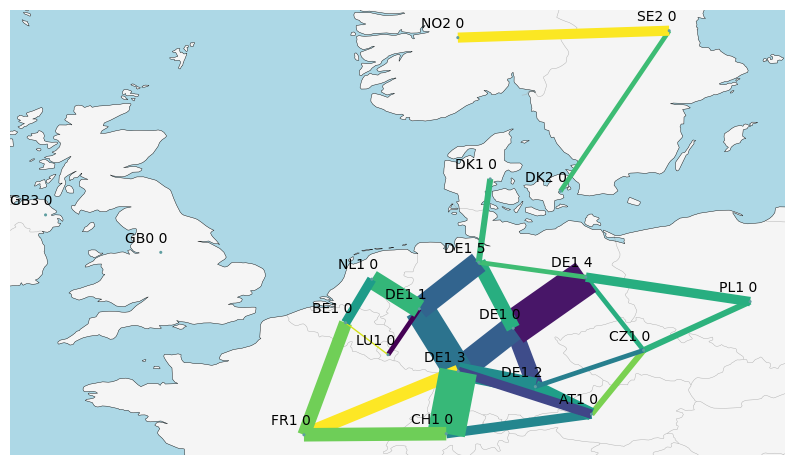

In [12]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show


## Installed Capacity Map Plot

In [13]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


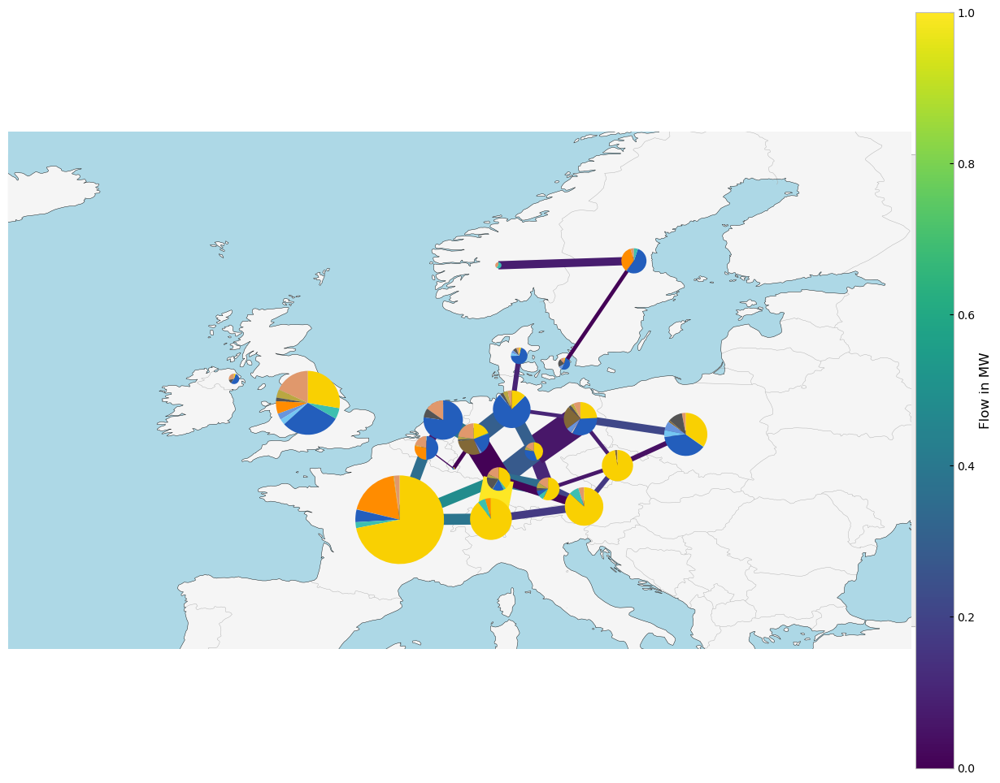

In [14]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_cap,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [15]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


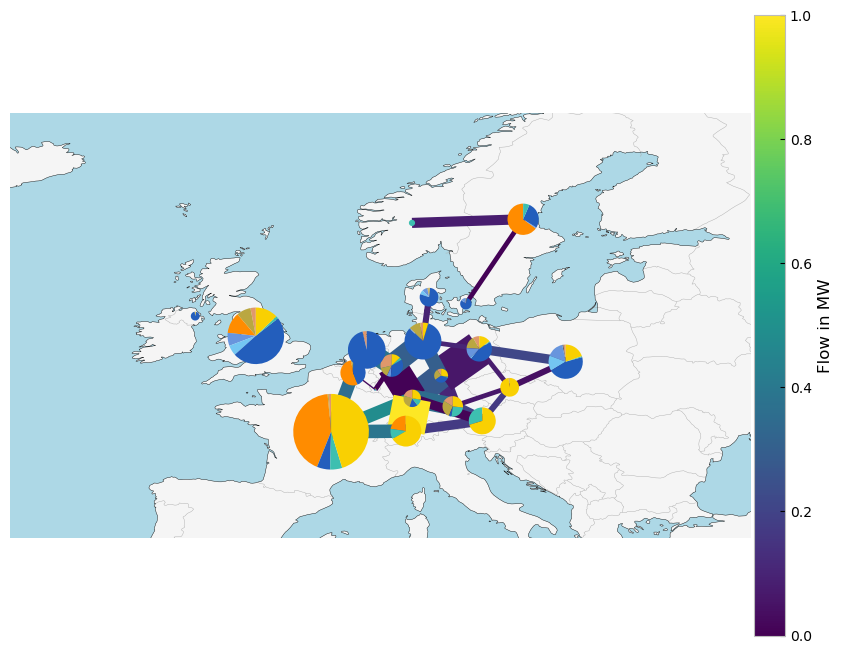

In [16]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 1e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

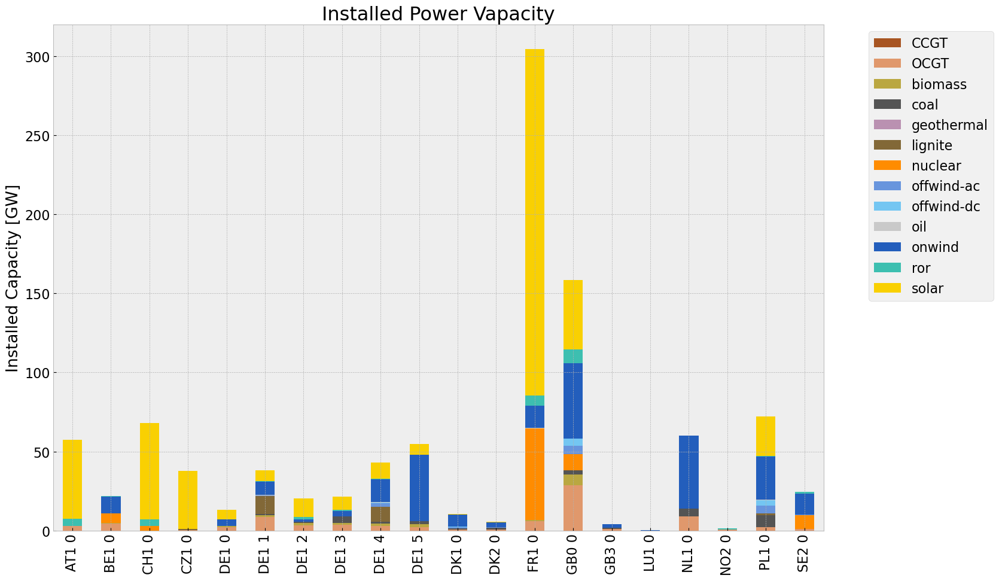

In [17]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

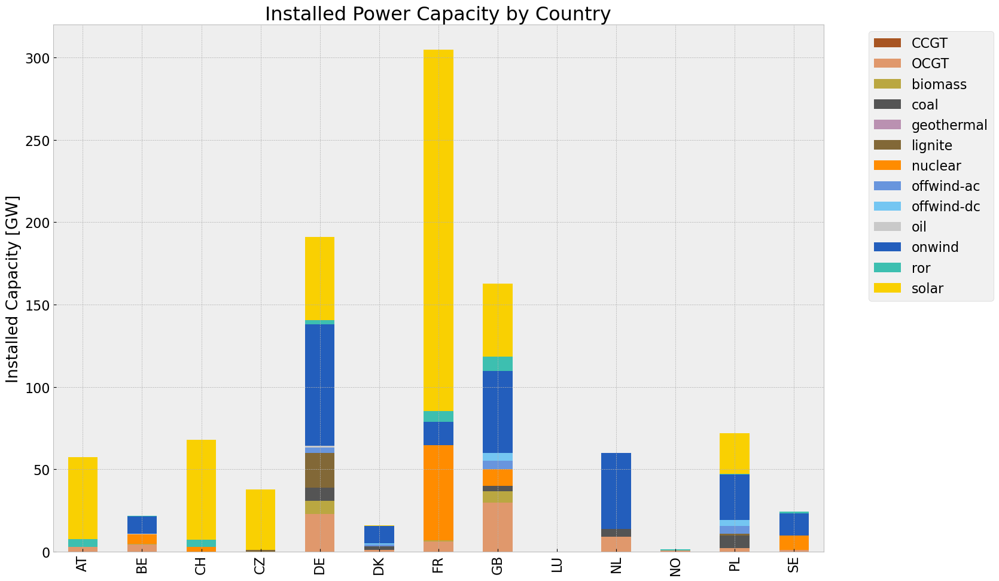

In [18]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

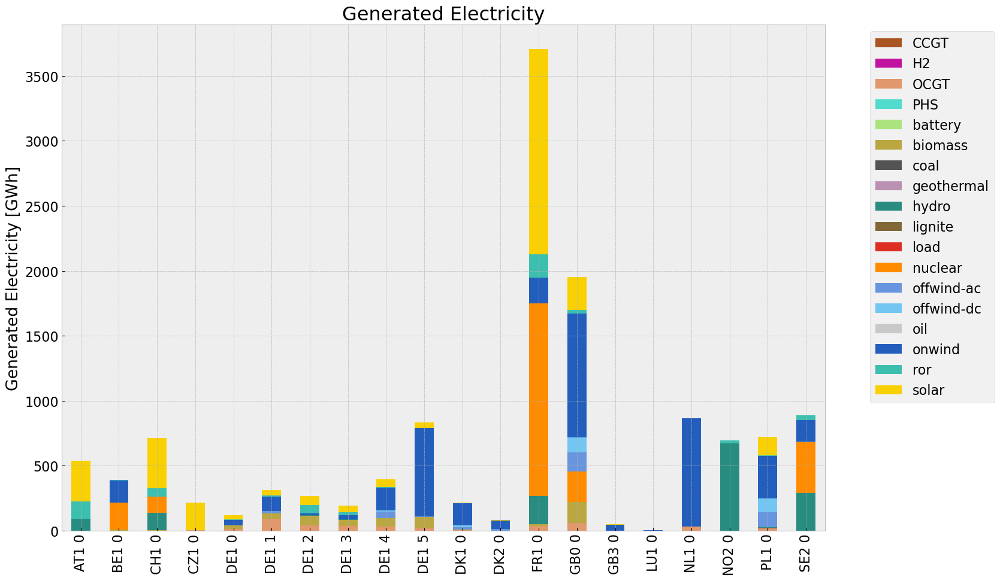

In [19]:
def gen_power_table(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    return tot_df

gen_base = gen_power_table(n)

<Figure size 640x480 with 0 Axes>

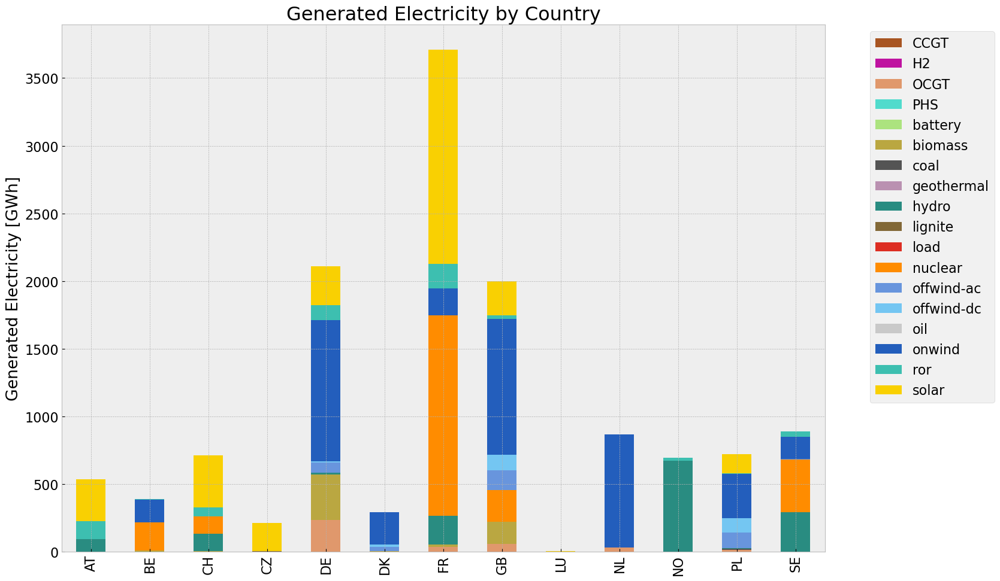

In [20]:
def gen_power_table_country(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)


    
    tot_df['country'] = tot_df.index.str[:2]
    tot_df = tot_df.groupby(['country']).sum()   
    #generations['load']/=1e3

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return tot_df

gen_base_country = gen_power_table_country(n)

## Snapshot

In [21]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [22]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [23]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='168H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")
    ax.set_ylim(-50,150)
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [24]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [25]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [26]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [27]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

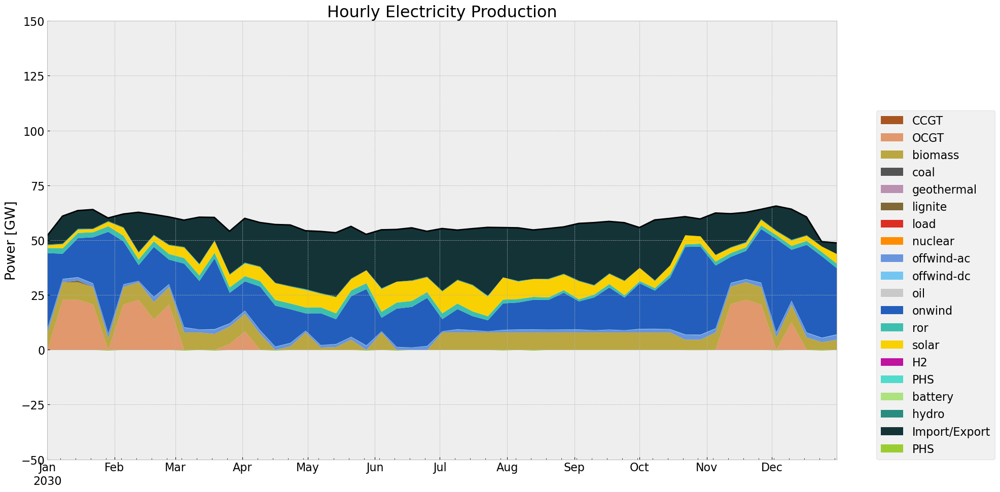

In [28]:
# winter
gen_curve(n, '2030-01-01', '2030-12-31', colors_gen,'DE')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

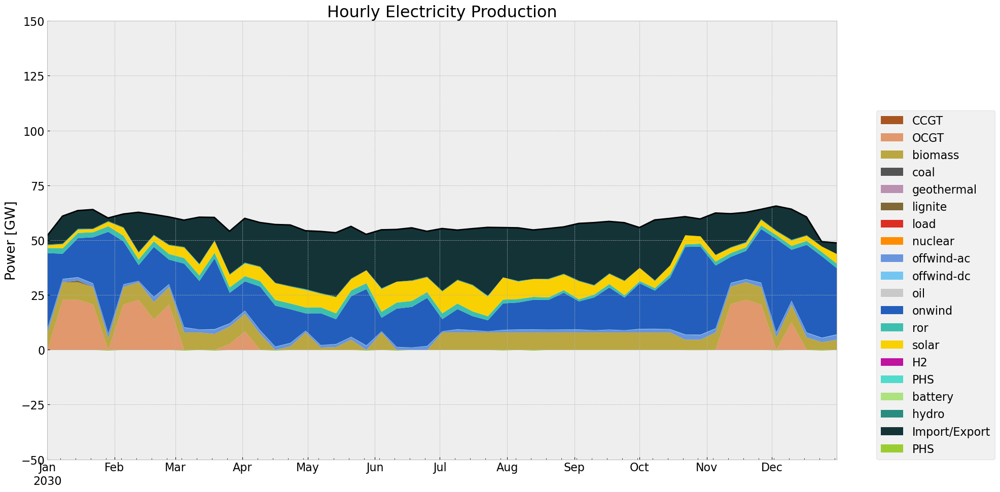

In [29]:
#summer
gen_curve(n, '2030-01-01', '2030-12-31', colors_gen,'DE')

In [30]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='168H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, 

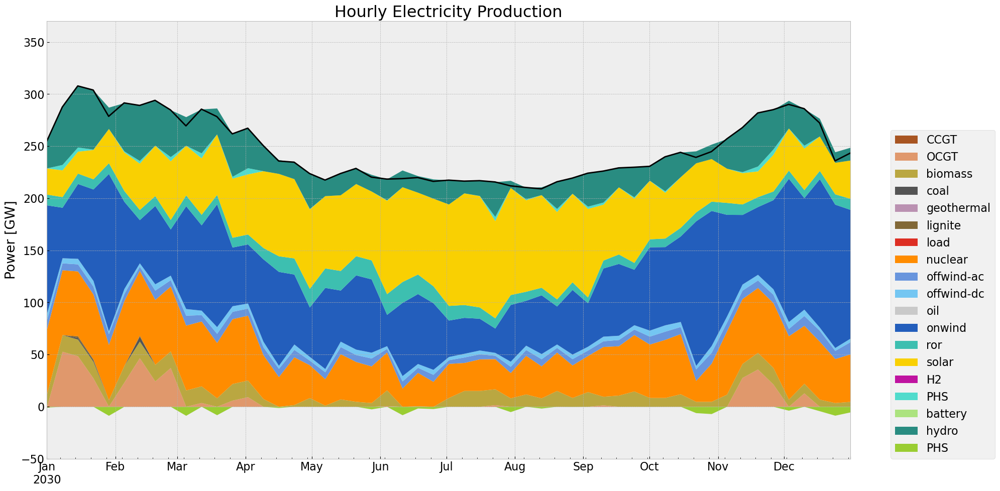

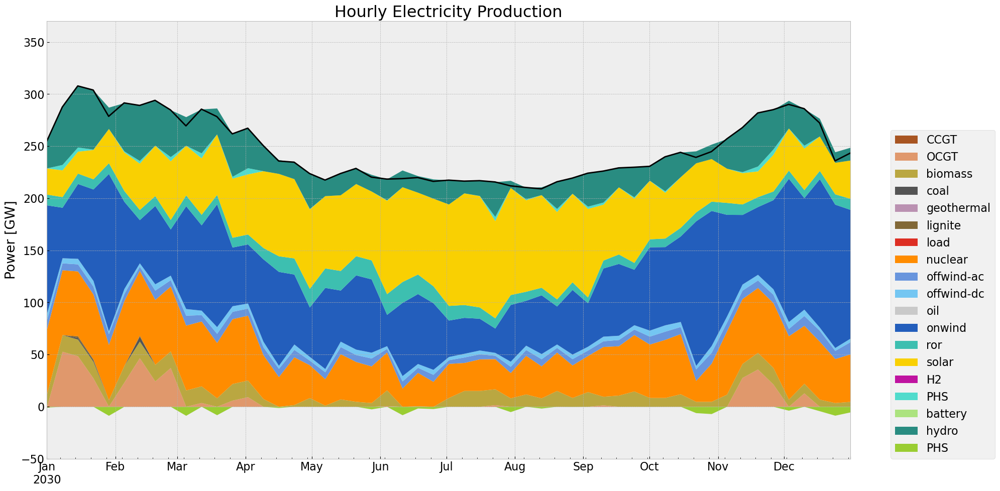

In [31]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-01-01', '2030-12-31', colors_gen)

## Storage

In [32]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["#bf13a0","#51dbcc","#ace37f","#298c81"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

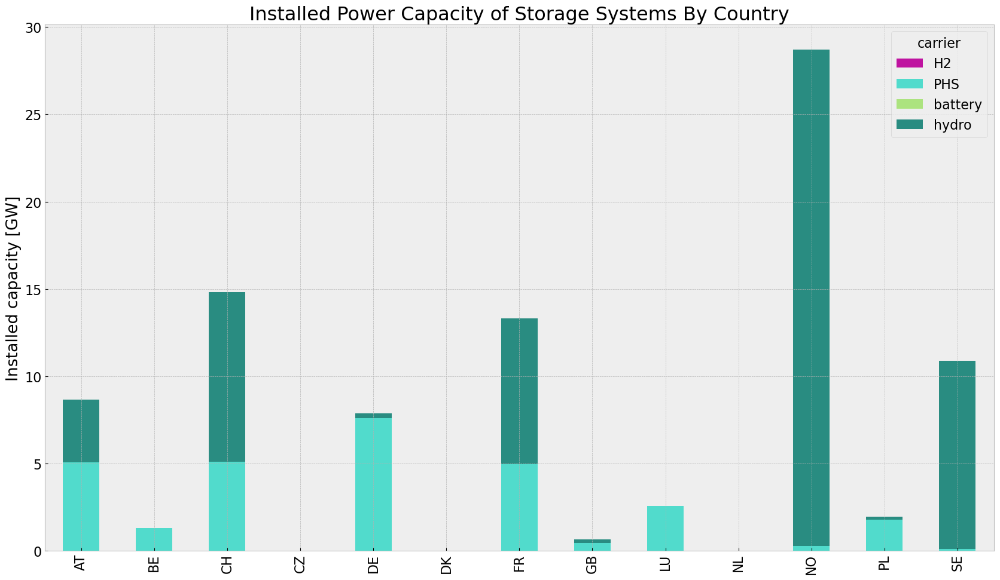

In [33]:
store_base = inst_store_table(n)

In [34]:
def state_of_charge_plot(n, start_date, end_date):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    time = pd.date_range(start= start_date , end= end_date, freq='168H')

    soc.loc[time].plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


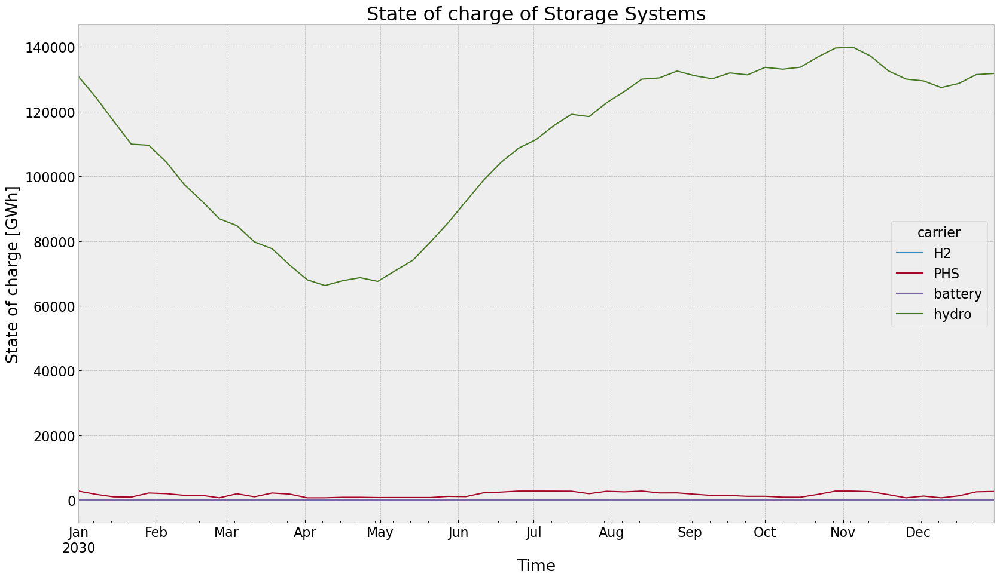

In [35]:
state_of_charge_plot(n, '2030-01-01', '2030-12-31')

## Electricity Price

In [36]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [37]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


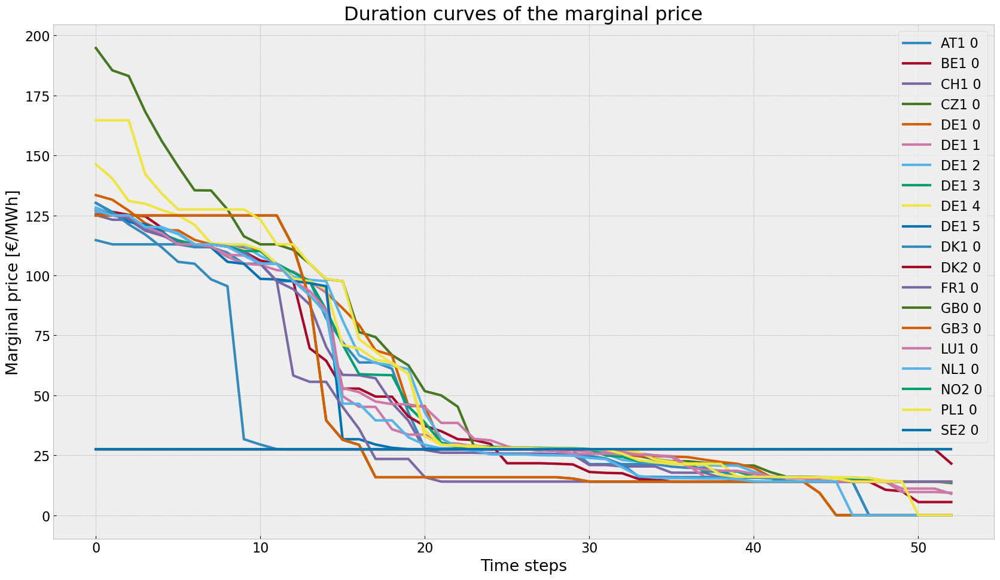

In [38]:
price_dur_curve_plot(n)

In [39]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


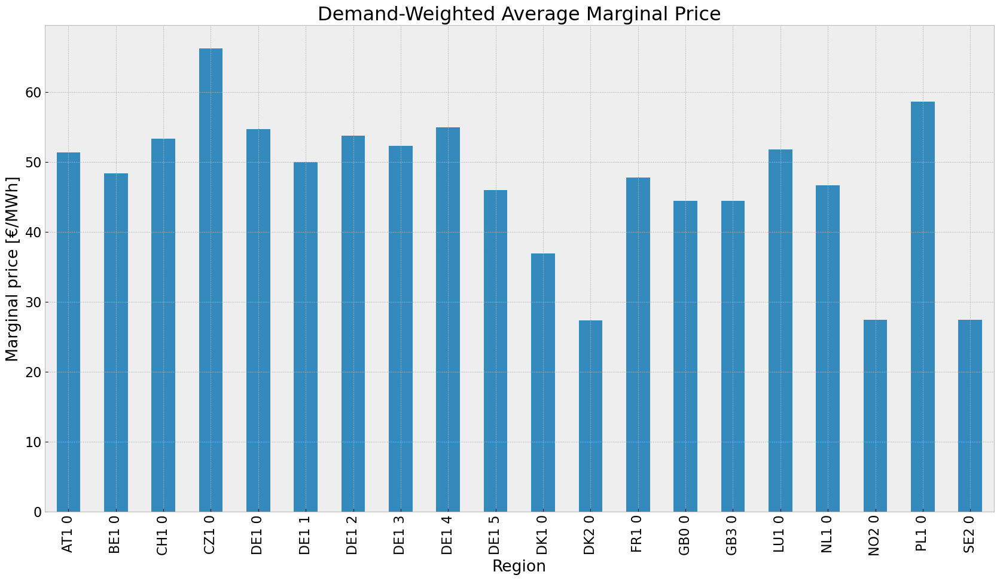

In [40]:
price_regions_table(n)

In [41]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


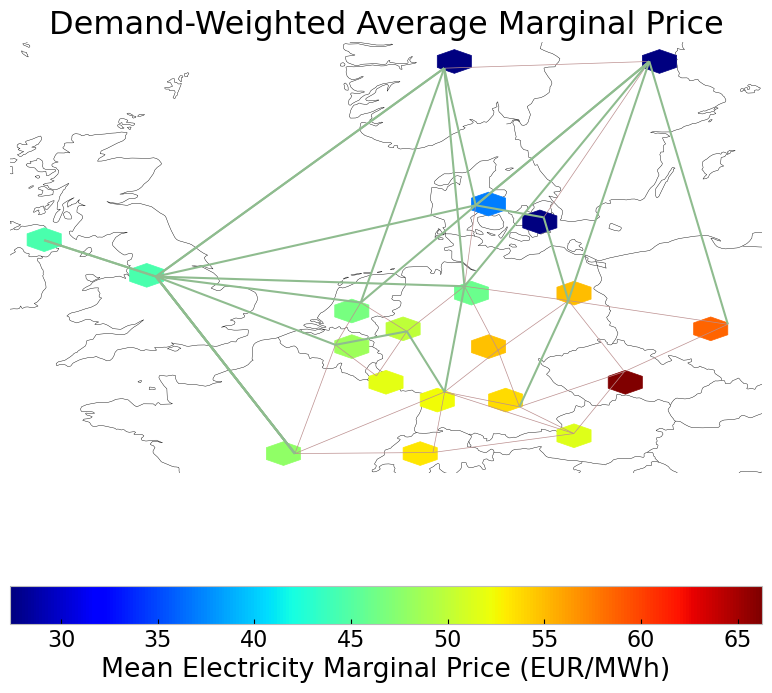

In [42]:
price_regions(n)

## Emission

In [43]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,3.802787e+05,0.451621,0.1980,166722.109286
biomass,5.322671e+05,0.468000,0.0000,0.000000
coal,7.782127e+03,0.329908,0.3361,7928.187466
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,3.352508e+03,0.337285,0.4069,4044.462271
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.445132e+06,0.326600,0.0000,0.000000
offwind-ac,3.712800e+05,1.000000,0.0000,0.000000


In [44]:
def system_cost(n, country): #n.statistics.capex()
    #add column country in generaror, storage unit, lines and links
    for index, row in n.generators.iterrows():
        n.generators.at[index,'country'] = row['bus'][:2]

    for index, row in n.storage_units.iterrows():
        n.storage_units.at[index,'country'] = row['bus'][:2]

    for index, row in n.lines.iterrows():
        if country_cost in row['bus0'] or country_cost in row['bus1']:
            n.lines.at[index, 'country'] = country_cost
        else:
            n.lines.at[index,'country'] = row['bus0'][:2]

    for index, row in n.links.iterrows():
        if country_cost in row['bus0'] or country_cost in row['bus1']: 
            n.links.at[index, 'country'] = country_cost
        else:
            n.links.at[index,'country'] = row['bus0'][:2]

    #calc opex and capex of the chosen country
    cost_df = pd.DataFrame(columns=['opex', 'capex'], index = n.carriers.index)

    opex = n.statistics.opex(comps=["Generator", "StorageUnit","Line","Link","Transformer"], groupby=["carrier","country"], aggregate_groups="sum").unstack()[country].fillna(0).droplevel(0)
    capex= n.statistics.capex(comps=["Generator", "StorageUnit","Line","Link","Transformer"], groupby=["carrier","country"], aggregate_groups="sum").unstack()[country].fillna(0).droplevel(0)

    for index, value in capex.items():
        cost_df.at[index, 'capex'] = value

    for index, value in opex.items():
        cost_df.at[index, 'opex'] = value

    cost_df = cost_df.fillna(0)
    system_cost = cost_df.sum(axis=1)/1e6 # Million€
    return system_cost



country_cost = 'DE'
system_cost_base = system_cost(n, country_cost)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)


# PV Cut Scenario



In [45]:
#p_max_pu of offwind generators across all regions are subtracted by 10% from 01.06.2013 to 31.12.13
cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reductionto = 0.25


def pvscenario(n, cut_start, duration, reductionto):
    #copy network
    n_new=n.copy()
    cut_end = cut_start + pd.Timedelta(days= duration)
    #implement pv cut
    for column in n_new.generators_t.p_max_pu.columns:
            if column.endswith('solar'):
                    for index,row in n_new.generators_t.p_max_pu[column].items():
                            if index >= cut_start and index <= cut_end:
                                    new_p_max_pu = n_new.generators_t.p_max_pu.at[index, column] * reductionto #0.9
                                    n_new.generators_t.p_max_pu.at[index, column] = new_p_max_pu
                                    if new_p_max_pu<0:
                                        n_new.generators_t.p_max_pu.at[index, column] = 0
    return n_new

n1 = pvscenario(n, cut_start, duration, reductionto)
n1.name = f'inv_{contingency}'          

## 1. Model: perfect foresight with allowed additional investment

In [46]:
country = 'DE'

### Allow investment

In [47]:
def allow_inv(n1,n,country):
    #delete line expansion global constraint
    if 'lv_limit' in n1.global_constraints.index:
        n1.global_constraints = n1.global_constraints.drop('lv_limit')

    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, row in n1.generators.iterrows():
        if row['p_nom_extendable'] == True and country in row['bus']:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = True
        else:
            n1.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, row in n1.storage_units.iterrows():
        if row['p_nom_extendable'] == True and country in row['bus']:
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt'] 
            n1.storage_units.at[index, 'p_nom_extendable'] = True
        else:
            n1.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            n1.storage_units.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, row in n1.lines.iterrows():
        if row['carrier'] == 'AC' and (country in row['bus0'] or country in row['bus1']):
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = True 
        else:
            n1.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = False 
    
    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, row in n1.links.iterrows():
        if row['carrier'] == 'DC' and (country in row['bus0'] or country in row['bus1']):
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = True 
        else:
            n1.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = False
            

allow_inv(n1,n, country)

In [48]:
n1.optimize(solver_name= "gurobi")
#filename = f'inv_{contingency}.nc'
#n1 = import_nc_file(directory, filename)
n1.name = f'inv_{contingency}'

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 91.60it/s]
INFO:linopy.io: Writing time: 0.9s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a90n0xgw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a90n0xgw.lp


Reading time = 0.28 seconds


INFO:gurobipy:Reading time = 0.28 seconds


obj: 59362 rows, 27677 columns, 103246 nonzeros


INFO:gurobipy:obj: 59362 rows, 27677 columns, 103246 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


INFO:gurobipy:Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


Model fingerprint: 0xd702d728


INFO:gurobipy:Model fingerprint: 0xd702d728


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [8e-03, 3e+02]


INFO:gurobipy:  Matrix range     [8e-03, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 1e+10]


INFO:gurobipy:  Bounds range     [1e+00, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50246 rows and 12360 columns


INFO:gurobipy:Presolve removed 50246 rows and 12360 columns


Presolve time: 0.13s


INFO:gurobipy:Presolve time: 0.13s


Presolved: 9116 rows, 15317 columns, 38046 nonzeros


INFO:gurobipy:Presolved: 9116 rows, 15317 columns, 38046 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 39


INFO:gurobipy: Dense cols : 39


 AA' NZ     : 6.641e+04


INFO:gurobipy: AA' NZ     : 6.641e+04


 Factor NZ  : 3.275e+05 (roughly 13 MB of memory)


INFO:gurobipy: Factor NZ  : 3.275e+05 (roughly 13 MB of memory)


 Factor Ops : 3.629e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.629e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.68914003e+13 -1.39617231e+14  7.62e+05 2.78e+05  3.76e+10     0s


INFO:gurobipy:   0   2.68914003e+13 -1.39617231e+14  7.62e+05 2.78e+05  3.76e+10     0s


   1   1.98081838e+13 -6.30655884e+13  5.12e+05 7.45e+04  2.04e+10     0s


INFO:gurobipy:   1   1.98081838e+13 -6.30655884e+13  5.12e+05 7.45e+04  2.04e+10     0s


   2   6.46375096e+12 -3.65156453e+13  1.15e+05 1.97e+04  5.22e+09     0s


INFO:gurobipy:   2   6.46375096e+12 -3.65156453e+13  1.15e+05 1.97e+04  5.22e+09     0s


   3   1.62894222e+12 -1.53635205e+13  1.11e+04 2.49e+03  8.50e+08     0s


INFO:gurobipy:   3   1.62894222e+12 -1.53635205e+13  1.11e+04 2.49e+03  8.50e+08     0s


   4   5.43211793e+11 -3.00655467e+12  7.48e+02 2.70e+02  1.24e+08     0s


INFO:gurobipy:   4   5.43211793e+11 -3.00655467e+12  7.48e+02 2.70e+02  1.24e+08     0s


   5   2.85032645e+11 -1.35070847e+12  2.06e+02 1.22e+02  5.35e+07     0s


INFO:gurobipy:   5   2.85032645e+11 -1.35070847e+12  2.06e+02 1.22e+02  5.35e+07     0s


   6   1.69776599e+11 -8.99126830e+11  7.02e+01 8.10e+01  3.40e+07     0s


INFO:gurobipy:   6   1.69776599e+11 -8.99126830e+11  7.02e+01 8.10e+01  3.40e+07     0s


   7   1.17222803e+11 -2.83232293e+11  2.90e+01 2.50e+01  1.26e+07     1s


INFO:gurobipy:   7   1.17222803e+11 -2.83232293e+11  2.90e+01 2.50e+01  1.26e+07     1s


   8   6.16903455e+10 -1.27131026e+11  5.86e+00 1.20e+01  5.89e+06     1s


INFO:gurobipy:   8   6.16903455e+10 -1.27131026e+11  5.86e+00 1.20e+01  5.89e+06     1s


   9   4.91177333e+10 -1.79497247e+10  3.23e+00 2.93e+00  2.09e+06     1s


INFO:gurobipy:   9   4.91177333e+10 -1.79497247e+10  3.23e+00 2.93e+00  2.09e+06     1s


  10   3.89066873e+10 -1.84945446e+08  1.71e+00 1.74e+00  1.21e+06     1s


INFO:gurobipy:  10   3.89066873e+10 -1.84945446e+08  1.71e+00 1.74e+00  1.21e+06     1s


  11   3.54592405e+10  1.00280642e+10  1.21e+00 1.05e+00  7.89e+05     1s


INFO:gurobipy:  11   3.54592405e+10  1.00280642e+10  1.21e+00 1.05e+00  7.89e+05     1s


  12   3.24233049e+10  1.61598803e+10  7.90e-01 6.43e-01  5.05e+05     1s


INFO:gurobipy:  12   3.24233049e+10  1.61598803e+10  7.90e-01 6.43e-01  5.05e+05     1s


  13   2.95351087e+10  2.02322495e+10  4.08e-01 3.73e-01  2.89e+05     1s


INFO:gurobipy:  13   2.95351087e+10  2.02322495e+10  4.08e-01 3.73e-01  2.89e+05     1s


  14   2.83041530e+10  2.35803479e+10  2.51e-01 1.55e-01  1.46e+05     1s


INFO:gurobipy:  14   2.83041530e+10  2.35803479e+10  2.51e-01 1.55e-01  1.46e+05     1s


  15   2.77395038e+10  2.45989673e+10  1.83e-01 9.12e-02  9.73e+04     1s


INFO:gurobipy:  15   2.77395038e+10  2.45989673e+10  1.83e-01 9.12e-02  9.73e+04     1s


  16   2.73883956e+10  2.48614305e+10  1.42e-01 7.47e-02  7.83e+04     1s


INFO:gurobipy:  16   2.73883956e+10  2.48614305e+10  1.42e-01 7.47e-02  7.83e+04     1s


  17   2.71402708e+10  2.50899564e+10  1.13e-01 6.05e-02  6.35e+04     1s


INFO:gurobipy:  17   2.71402708e+10  2.50899564e+10  1.13e-01 6.05e-02  6.35e+04     1s


  18   2.68693751e+10  2.53924195e+10  8.22e-02 4.17e-02  4.58e+04     1s


INFO:gurobipy:  18   2.68693751e+10  2.53924195e+10  8.22e-02 4.17e-02  4.58e+04     1s


  19   2.64854409e+10  2.58514780e+10  3.96e-02 1.35e-02  1.96e+04     1s


INFO:gurobipy:  19   2.64854409e+10  2.58514780e+10  3.96e-02 1.35e-02  1.96e+04     1s


  20   2.63758013e+10  2.59913657e+10  2.84e-02 5.95e-03  1.19e+04     1s


INFO:gurobipy:  20   2.63758013e+10  2.59913657e+10  2.84e-02 5.95e-03  1.19e+04     1s


  21   2.62991834e+10  2.60270663e+10  2.02e-02 3.94e-03  8.43e+03     1s


INFO:gurobipy:  21   2.62991834e+10  2.60270663e+10  2.02e-02 3.94e-03  8.43e+03     1s


  22   2.62030624e+10  2.60598161e+10  1.00e-02 2.17e-03  4.44e+03     1s


INFO:gurobipy:  22   2.62030624e+10  2.60598161e+10  1.00e-02 2.17e-03  4.44e+03     1s


  23   2.61771193e+10  2.60761697e+10  7.30e-03 1.34e-03  3.13e+03     1s


INFO:gurobipy:  23   2.61771193e+10  2.60761697e+10  7.30e-03 1.34e-03  3.13e+03     1s


  24   2.61367152e+10  2.60940201e+10  3.03e-03 4.57e-04  1.32e+03     1s


INFO:gurobipy:  24   2.61367152e+10  2.60940201e+10  3.03e-03 4.57e-04  1.32e+03     1s


  25   2.61099142e+10  2.60976565e+10  4.04e-04 2.87e-04  3.80e+02     1s


INFO:gurobipy:  25   2.61099142e+10  2.60976565e+10  4.04e-04 2.87e-04  3.80e+02     1s


  26   2.61072173e+10  2.61020302e+10  1.63e-04 1.14e-04  1.61e+02     1s


INFO:gurobipy:  26   2.61072173e+10  2.61020302e+10  1.63e-04 1.14e-04  1.61e+02     1s


  27   2.61062544e+10  2.61035699e+10  8.38e-05 5.83e-05  8.32e+01     1s


INFO:gurobipy:  27   2.61062544e+10  2.61035699e+10  8.38e-05 5.83e-05  8.32e+01     1s


  28   2.61055983e+10  2.61044025e+10  3.20e-05 2.72e-05  3.70e+01     1s


INFO:gurobipy:  28   2.61055983e+10  2.61044025e+10  3.20e-05 2.72e-05  3.70e+01     1s


  29   2.61054049e+10  2.61047756e+10  1.70e-05 1.33e-05  1.95e+01     1s


INFO:gurobipy:  29   2.61054049e+10  2.61047756e+10  1.70e-05 1.33e-05  1.95e+01     1s


  30   2.61052185e+10  2.61050341e+10  7.66e-06 4.12e-06  5.71e+00     1s


INFO:gurobipy:  30   2.61052185e+10  2.61050341e+10  7.66e-06 4.12e-06  5.71e+00     1s


  31   2.61051839e+10  2.61051301e+10  6.69e-06 9.65e-07  1.67e+00     1s


INFO:gurobipy:  31   2.61051839e+10  2.61051301e+10  6.69e-06 9.65e-07  1.67e+00     1s


  32   2.61051776e+10  2.61051376e+10  4.76e-06 7.18e-07  1.24e+00     1s


INFO:gurobipy:  32   2.61051776e+10  2.61051376e+10  4.76e-06 7.18e-07  1.24e+00     1s


  33   2.61051648e+10  2.61051520e+10  1.78e-06 2.54e-07  3.98e-01     1s


INFO:gurobipy:  33   2.61051648e+10  2.61051520e+10  1.78e-06 2.54e-07  3.98e-01     1s


  34   2.61051625e+10  2.61051587e+10  8.19e-07 4.80e-08  1.17e-01     1s


INFO:gurobipy:  34   2.61051625e+10  2.61051587e+10  8.19e-07 4.80e-08  1.17e-01     1s


  35   2.61051605e+10  2.61051603e+10  2.75e-08 1.91e-09  7.88e-03     1s


INFO:gurobipy:  35   2.61051605e+10  2.61051603e+10  2.75e-08 1.91e-09  7.88e-03     1s


  36   2.61051604e+10  2.61051604e+10  5.66e-08 9.42e-11  1.47e-04     1s


INFO:gurobipy:  36   2.61051604e+10  2.61051604e+10  5.66e-08 9.42e-11  1.47e-04     1s


  37   2.61051604e+10  2.61051604e+10  1.85e-08 9.07e-11  1.47e-07     1s


INFO:gurobipy:  37   2.61051604e+10  2.61051604e+10  1.85e-08 9.07e-11  1.47e-07     1s


  38   2.61051604e+10  2.61051604e+10  3.35e-10 1.35e-10  2.03e-10     1s


INFO:gurobipy:  38   2.61051604e+10  2.61051604e+10  3.35e-10 1.35e-10  2.03e-10     1s


INFO:gurobipy:


Barrier solved model in 38 iterations and 1.14 seconds (0.33 work units)


INFO:gurobipy:Barrier solved model in 38 iterations and 1.14 seconds (0.33 work units)


Optimal objective 2.61051604e+10


INFO:gurobipy:Optimal objective 2.61051604e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3155 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:    3155 DPushes remaining with DInf 0.0000000e+00                 1s


       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:


     110 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:     110 PPushes remaining with PInf 0.0000000e+00                 1s


       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 8.3984046e-10      1s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 8.3984046e-10      1s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1727    2.6105160e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1727    2.6105160e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1727 iterations and 1.28 seconds (0.38 work units)


INFO:gurobipy:Solved in 1727 iterations and 1.28 seconds (0.38 work units)


Optimal objective  2.610516041e+10


INFO:gurobipy:Optimal objective  2.610516041e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27677 primals, 59362 duals
Objective: 2.61e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

### Export model for later use

In [49]:
file = f"{n1.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n1.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_pv.nc has links, generators, storage_units, buses, lines, loads, carriers


<xarray.Dataset> Size: 279kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, links_i: 28,
                                           links_t_p0_i: 16, links_t_p1_i: 16,
                                           generators_i: 261,
                                           generators_t_p_max_pu_i: 81,
                                           generators_t_p_i: 100,
                                           ...
                                           buses_t_marginal_price_i: 20,
                                           lines_i: 27, lines_t_p0_i: 27,
                                           lines_t_p1_i: 27,
                                           lines_t_loss_i: 27, loads_i: 20,
                                           loads_t_p_set_i: 20,
                                           loads_t_p_i: 20, carriers_i: 21)
Coordinates: (12/26)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * links_i                               (links_i) object 224B '14801' ... '...
  * links_t_p0_i                          (links_t_p0_i) object 128B '14801' ...
  * links_t_p1_i                          (links_t_p1_i) object 128B '14801' ...
  * generators_i                          (generators_i) object 2kB 'AT1 0 CC...
    ...                                    ...
  * lines_t_p1_i                          (lines_t_p1_i) object 216B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
  * loads_i                               (loads_i) object 160B 'AT1 0' ... '...
  * loads_t_p_set_i                       (loads_t_p_set_i) object 160B 'AT1 ...
  * loads_t_p_i                           (loads_t_p_i) object 160B 'AT1 0' ....
  * carriers_i                            (carriers_i) object 168B 'AC' ... '...
Data variables: (12/102)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    loads_bus                             (loads_i) object 160B 'AT1 0' ... '...
    loads_t_p_set                         (snapshots, loads_t_p_set_i) float64 8kB ...
    loads_t_p                             (snapshots, loads_t_p_i) float64 8kB ...
    carriers_co2_emissions                (carriers_i) float64 168B 0.0 ... 0.0
    carriers_color                        (carriers_i) object 168B '#70af1d' ...
    carriers_nice_name                    (carriers_i) object 168B 'AC' ... '...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                inv_pv
    network_objective:           26105160407.38247
    network_objective_constant:  10801412755.028429
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {}

In [50]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1, country_cost) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)


<Figure size 640x480 with 0 Axes>

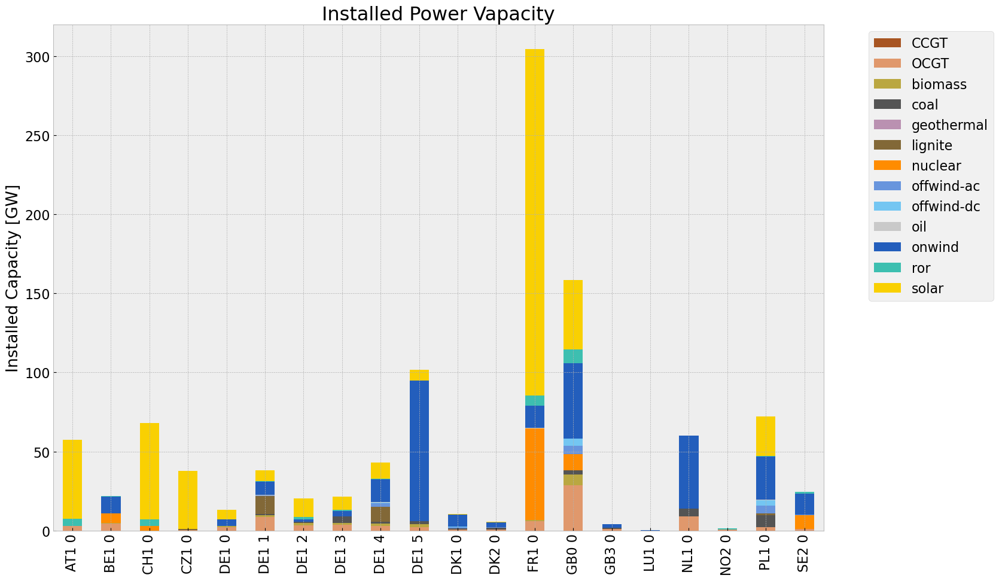

<Figure size 640x480 with 0 Axes>

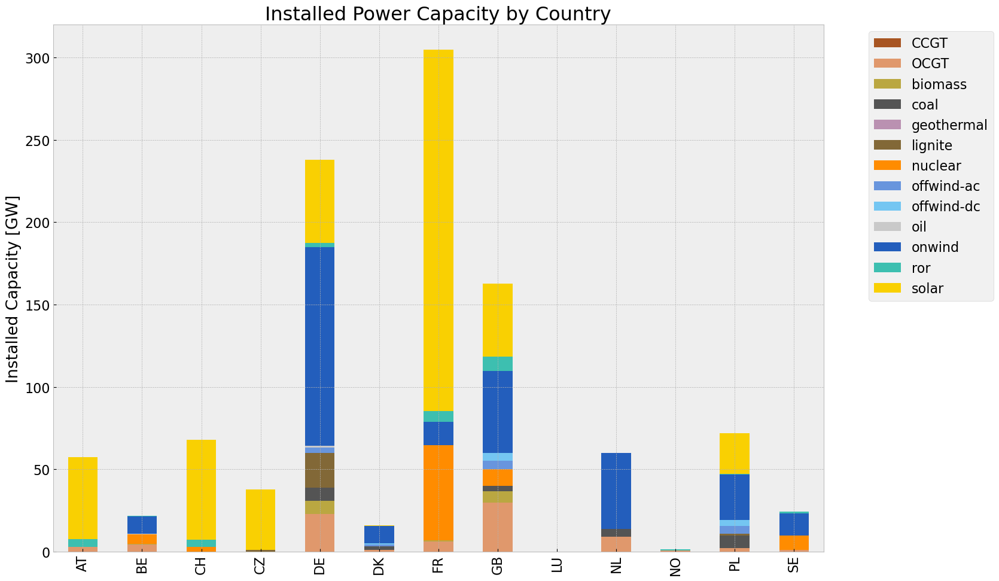

In [51]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


### Generation

<Figure size 640x480 with 0 Axes>

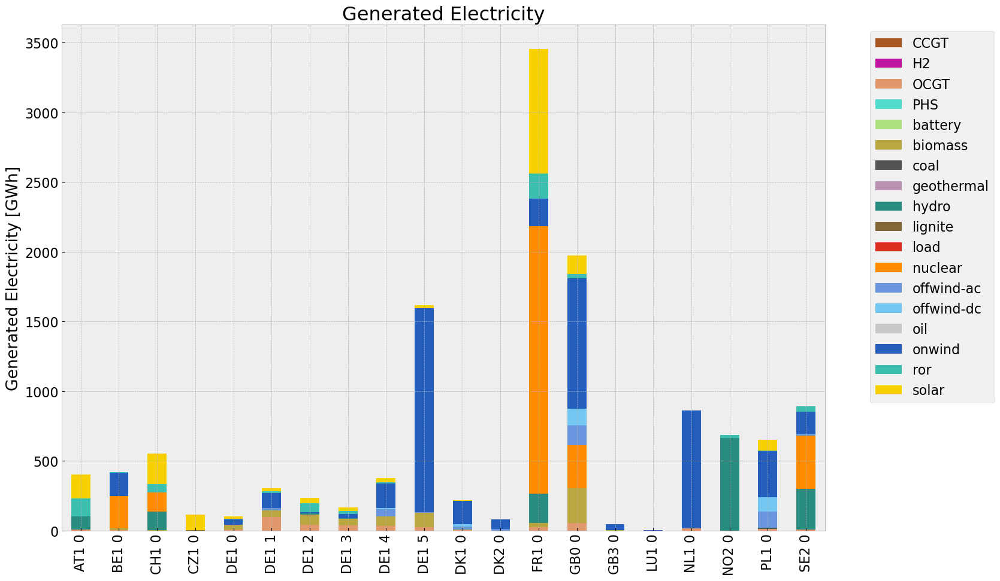

<Figure size 640x480 with 0 Axes>

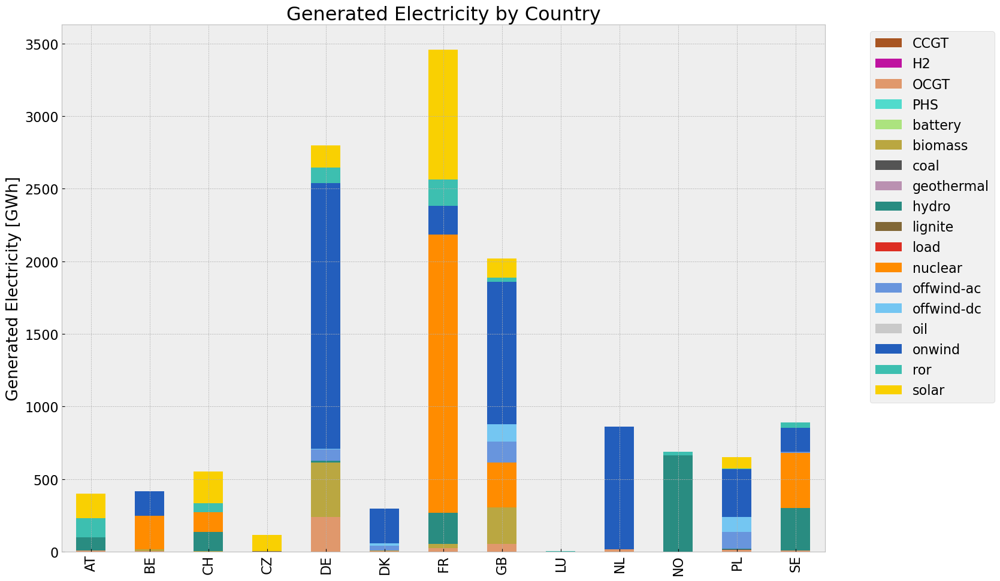

In [52]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1)
gen_inv_country = gen_power_table_country(n1)

### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

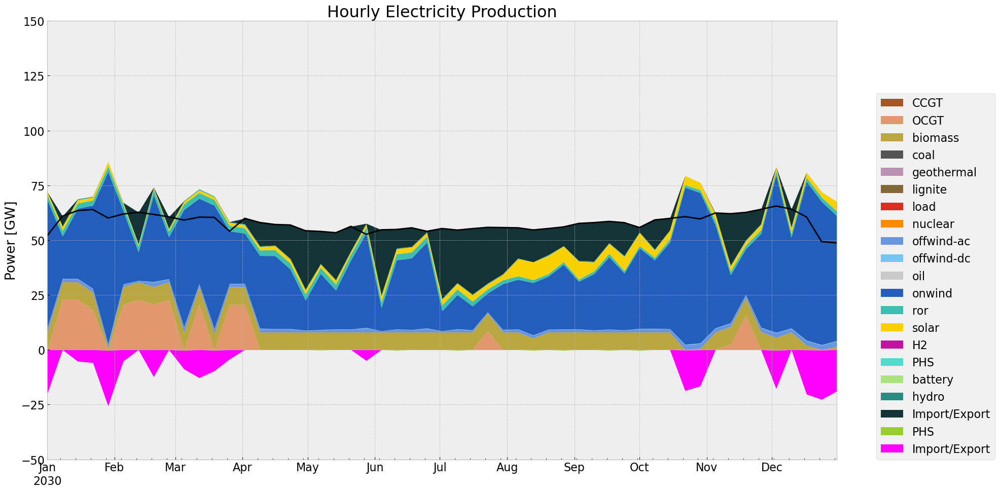

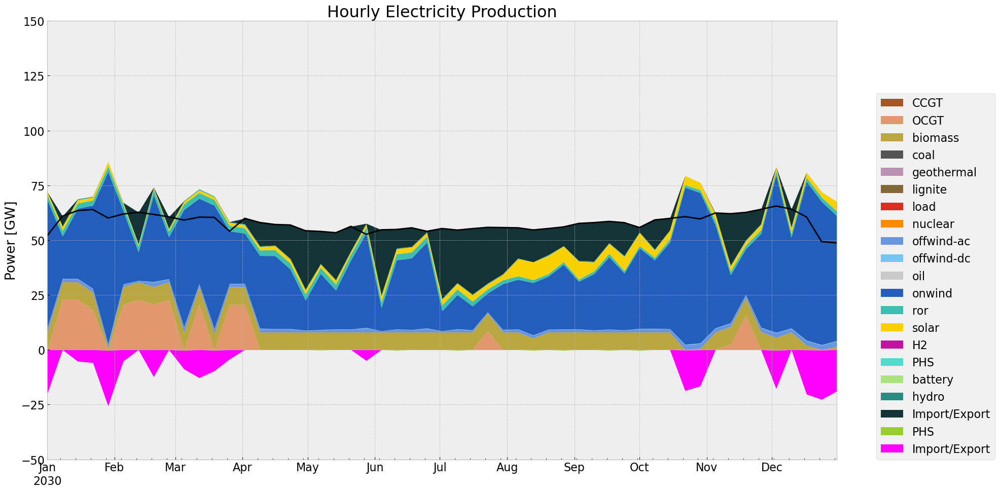

In [53]:
gen_curve(n1, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n1, '2030-01-01', '2030-12-31', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, 

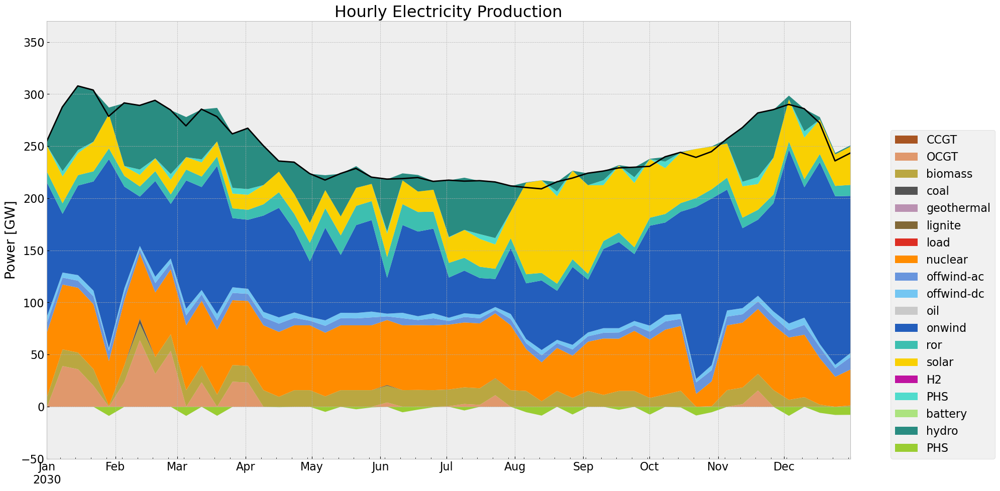

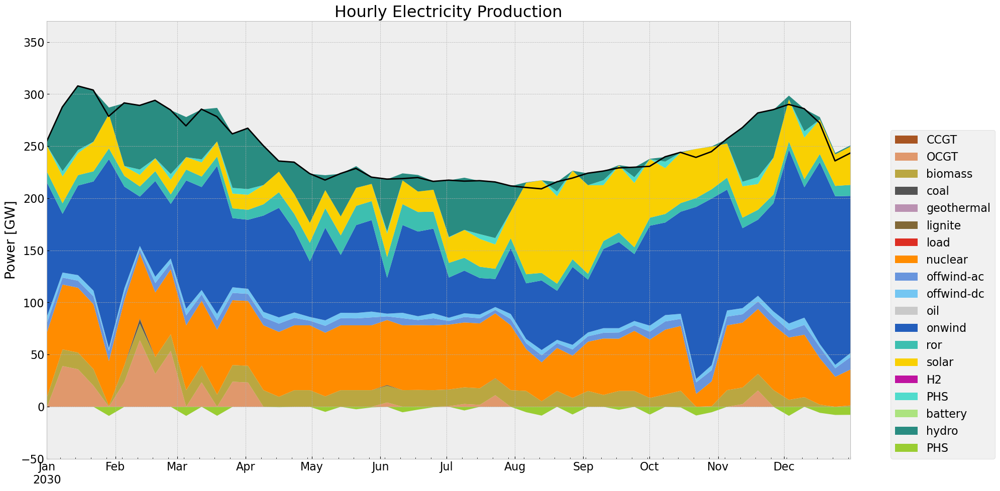

In [54]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-01-01', '2030-12-31', colors_gen)

### Storage

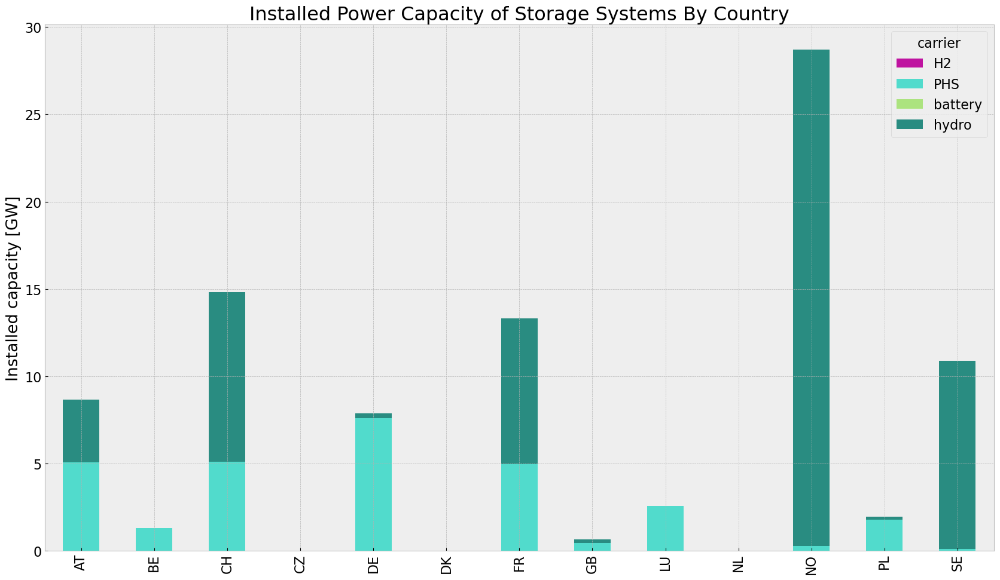

In [55]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


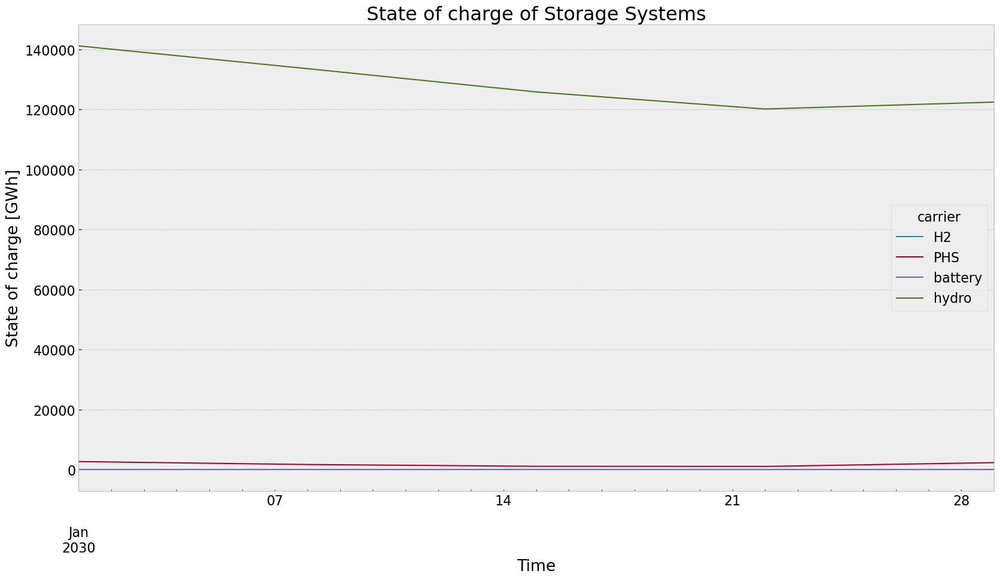

In [56]:
state_of_charge_plot(n1, '2030-01-01 00:00', '2030-02-02 21:00')

### Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


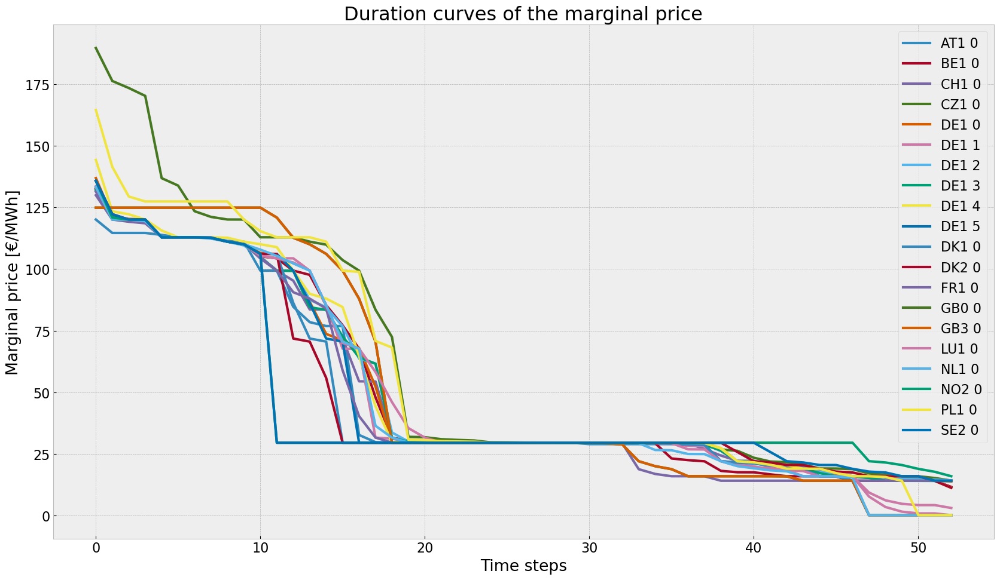

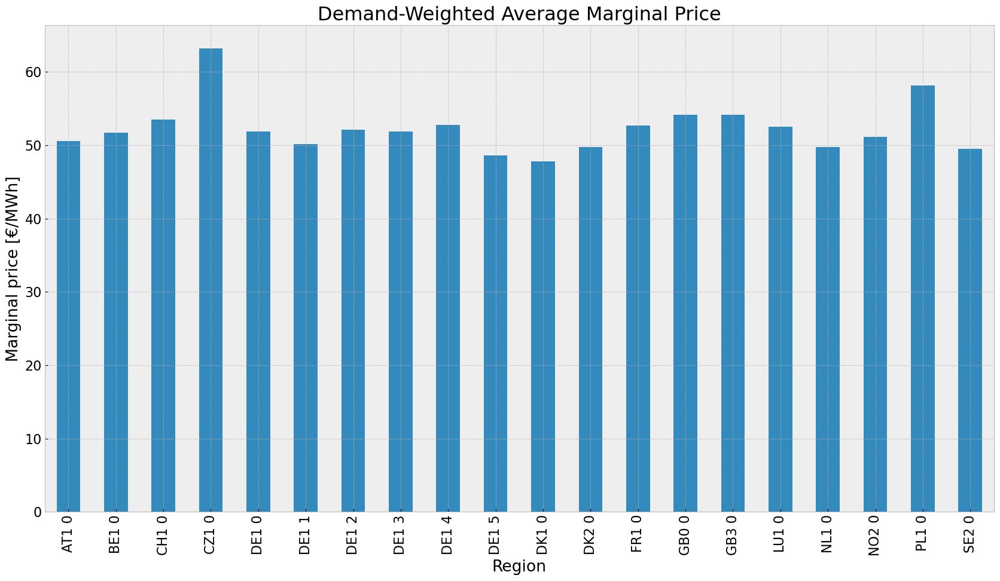

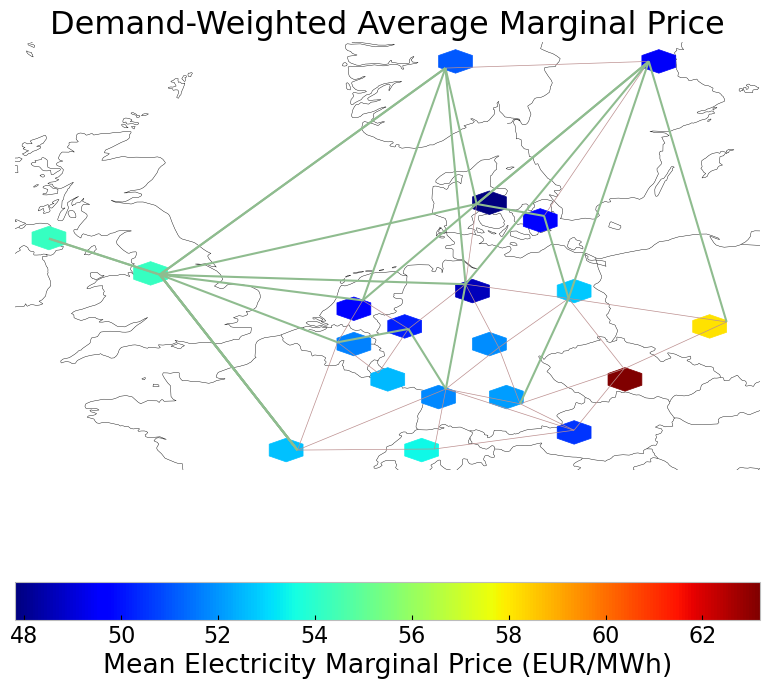

In [57]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


### Emission

In [58]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,3.782538e+05,0.451621,0.1980,165834.357162
biomass,6.779910e+05,0.468000,0.0000,0.000000
coal,4.294199e+03,0.329908,0.3361,4374.796093
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,2.050925e+03,0.337285,0.4069,2474.233656
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.971719e+06,0.326600,0.0000,0.000000
offwind-ac,3.712936e+05,1.000000,0.0000,0.000000


## 2. Noinv

In [59]:
n2 = pvscenario(n, cut_start, duration, reductionto)

### No Investment

In [60]:
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

no_inv(n2,n)


In [61]:
#BAse RH
n_roll = n.copy()
no_inv(n_roll,n)
n_roll.storage_units['cylic_state_of_charge'] = False
n_roll.storage_units['cylic_state_of_charge_per_period'] = False


horizon = 4
optimize.optimize_with_rolling_horizon(n_roll, horizon=int(horizon), overlap=0, solver_name='gurobi')
#filename = f"base_{contingency}_roll.nc"
#n_roll = import_nc_file(directory, filename)
n_roll.name = f'base_{contingency}_roll'


INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y3g5lent.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y3g5lent.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x4a9ca0bd


INFO:gurobipy:Model fingerprint: 0x4a9ca0bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1123 columns


INFO:gurobipy:Presolve removed 4248 rows and 1123 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 961 columns, 1573 nonzeros


INFO:gurobipy:Presolved: 224 rows, 961 columns, 1573 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9320496e+08   1.010944e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.9320496e+08   1.010944e+06   0.000000e+00      0s


Extra simplex iterations after uncrush: 4


INFO:gurobipy:Extra simplex iterations after uncrush: 4


     327    1.9170658e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     327    1.9170658e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 327 iterations and 0.07 seconds (0.01 work units)


INFO:gurobipy:Solved in 327 iterations and 0.07 seconds (0.01 work units)


Optimal objective  1.917065804e+10


INFO:gurobipy:Optimal objective  1.917065804e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.92e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-puaju7k2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-puaju7k2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x3c3c5b83


INFO:gurobipy:Model fingerprint: 0x3c3c5b83


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4248 rows and 1123 columns


INFO:gurobipy:Presolve removed 4248 rows and 1123 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 961 columns, 1573 nonzeros


INFO:gurobipy:Presolved: 224 rows, 961 columns, 1573 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4232792e+08   9.960889e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4232792e+08   9.960889e+05   0.000000e+00      0s


     306    2.2149209e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     306    2.2149209e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 306 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 306 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.214920893e+10


INFO:gurobipy:Optimal objective  2.214920893e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.21e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yccagcl_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yccagcl_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xf638a196


INFO:gurobipy:Model fingerprint: 0xf638a196


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1108 columns


INFO:gurobipy:Presolve removed 4248 rows and 1108 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 976 columns, 1588 nonzeros


INFO:gurobipy:Presolved: 224 rows, 976 columns, 1588 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1237358e+08   1.009312e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1237358e+08   1.009312e+06   0.000000e+00      0s


     337    2.1379023e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     337    2.1379023e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 337 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 337 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.137902280e+10


INFO:gurobipy:Optimal objective  2.137902280e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.14e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qd1yx8w8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qd1yx8w8.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x5a97a2c5


INFO:gurobipy:Model fingerprint: 0x5a97a2c5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1110 columns


INFO:gurobipy:Presolve removed 4248 rows and 1110 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 974 columns, 1586 nonzeros


INFO:gurobipy:Presolved: 224 rows, 974 columns, 1586 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0143271e+07   1.029741e+06   0.000000e+00      0s


INFO:gurobipy:       0    5.0143271e+07   1.029741e+06   0.000000e+00      0s


     341    1.4441892e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     341    1.4441892e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 341 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 341 iterations and 0.06 seconds (0.01 work units)


Optimal objective  1.444189229e+10


INFO:gurobipy:Optimal objective  1.444189229e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.44e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_4n0apcs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_4n0apcs.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x164c57d7


INFO:gurobipy:Model fingerprint: 0x164c57d7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4248 rows and 1114 columns


INFO:gurobipy:Presolve removed 4248 rows and 1114 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 970 columns, 1582 nonzeros


INFO:gurobipy:Presolved: 224 rows, 970 columns, 1582 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5953365e+07   1.042646e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5953365e+07   1.042646e+06   0.000000e+00      0s


     378    3.4065602e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     378    3.4065602e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 378 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 378 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.406560217e+08


INFO:gurobipy:Optimal objective  3.406560217e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_0dzslcz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_0dzslcz.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xd0f7767a


INFO:gurobipy:Model fingerprint: 0xd0f7767a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1120 columns


INFO:gurobipy:Presolve removed 4248 rows and 1120 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 964 columns, 1576 nonzeros


INFO:gurobipy:Presolved: 224 rows, 964 columns, 1576 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6016608e+07   1.035588e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.6016608e+07   1.035588e+06   0.000000e+00      0s


     314    1.3165586e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     314    1.3165586e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 314 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 314 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.316558575e+08


INFO:gurobipy:Optimal objective  1.316558575e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-puujfnhv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-puujfnhv.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xa1e13e04


INFO:gurobipy:Model fingerprint: 0xa1e13e04


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1114 columns


INFO:gurobipy:Presolve removed 4248 rows and 1114 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 970 columns, 1582 nonzeros


INFO:gurobipy:Presolved: 224 rows, 970 columns, 1582 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6044006e+07   1.032866e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.6044006e+07   1.032866e+06   0.000000e+00      0s


     350    1.4744221e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     350    1.4744221e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 350 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 350 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.474422140e+08


INFO:gurobipy:Optimal objective  1.474422140e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.47e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3yqfirtw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3yqfirtw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x5a1b49ae


INFO:gurobipy:Model fingerprint: 0x5a1b49ae


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1115 columns


INFO:gurobipy:Presolve removed 4248 rows and 1115 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 969 columns, 1581 nonzeros


INFO:gurobipy:Presolved: 224 rows, 969 columns, 1581 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1595451e+07   1.029643e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1595451e+07   1.029643e+06   0.000000e+00      0s


     329    3.1834043e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     329    3.1834043e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 329 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 329 iterations and 0.05 seconds (0.01 work units)


Optimal objective  3.183404274e+08


INFO:gurobipy:Optimal objective  3.183404274e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ts5s6d05.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ts5s6d05.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x136d60ec


INFO:gurobipy:Model fingerprint: 0x136d60ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1113 columns


INFO:gurobipy:Presolve removed 4248 rows and 1113 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 224 rows, 971 columns, 1583 nonzeros


INFO:gurobipy:Presolved: 224 rows, 971 columns, 1583 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1615286e+07   1.026767e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1615286e+07   1.026767e+06   0.000000e+00      0s


     392    3.8620363e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     392    3.8620363e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 392 iterations and 0.09 seconds (0.01 work units)


INFO:gurobipy:Solved in 392 iterations and 0.09 seconds (0.01 work units)


Optimal objective  3.862036320e+08


INFO:gurobipy:Optimal objective  3.862036320e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jk21e1sb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jk21e1sb.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x4d2b6b03


INFO:gurobipy:Model fingerprint: 0x4d2b6b03


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1116 columns


INFO:gurobipy:Presolve removed 4248 rows and 1116 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 968 columns, 1580 nonzeros


INFO:gurobipy:Presolved: 224 rows, 968 columns, 1580 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6013515e+07   1.020785e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.6013515e+07   1.020785e+06   0.000000e+00      0s


     387    5.9520926e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     387    5.9520926e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 387 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 387 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.952092565e+08


INFO:gurobipy:Optimal objective  5.952092565e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qyyrs8e2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qyyrs8e2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xb51f4b0a


INFO:gurobipy:Model fingerprint: 0xb51f4b0a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1112 columns


INFO:gurobipy:Presolve removed 4248 rows and 1112 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 972 columns, 1584 nonzeros


INFO:gurobipy:Presolved: 224 rows, 972 columns, 1584 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1288144e+05   1.009929e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1288144e+05   1.009929e+06   0.000000e+00      0s


     371    3.7020635e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     371    3.7020635e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 371 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 371 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.702063494e+08


INFO:gurobipy:Optimal objective  3.702063494e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4rq9i8gy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4rq9i8gy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x3bb4207e


INFO:gurobipy:Model fingerprint: 0x3bb4207e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1110 columns


INFO:gurobipy:Presolve removed 4248 rows and 1110 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 974 columns, 1586 nonzeros


INFO:gurobipy:Presolved: 224 rows, 974 columns, 1586 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2054966e+07   9.852851e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2054966e+07   9.852851e+05   0.000000e+00      0s


     390    3.4097911e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     390    3.4097911e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 390 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 390 iterations and 0.05 seconds (0.01 work units)


Optimal objective  3.409791140e+09


INFO:gurobipy:Optimal objective  3.409791140e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.41e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gr65v1yq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gr65v1yq.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xbcb8bc0a


INFO:gurobipy:Model fingerprint: 0xbcb8bc0a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1129 columns


INFO:gurobipy:Presolve removed 4248 rows and 1129 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 955 columns, 1567 nonzeros


INFO:gurobipy:Presolved: 224 rows, 955 columns, 1567 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4233708e+05   1.013131e+06   0.000000e+00      0s


INFO:gurobipy:       0    8.4233708e+05   1.013131e+06   0.000000e+00      0s


     358    6.2039731e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     358    6.2039731e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 358 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 358 iterations and 0.05 seconds (0.01 work units)


Optimal objective  6.203973073e+08


INFO:gurobipy:Optimal objective  6.203973073e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-28aue11k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-28aue11k.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1702 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1702 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1702 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1702 nonzeros


Model fingerprint: 0x3ffe68e1


INFO:gurobipy:Model fingerprint: 0x3ffe68e1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1087 rows and 348 columns


INFO:gurobipy:Presolve removed 1087 rows and 348 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 31 rows, 173 columns, 261 nonzeros


INFO:gurobipy:Presolved: 31 rows, 173 columns, 261 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6087164e+04   1.529662e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6087164e+04   1.529662e+05   0.000000e+00      0s


      27    9.9654766e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      27    9.9654766e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 27 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 27 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.965476552e+06


INFO:gurobipy:Optimal objective  9.965476552e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 9.97e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


In [62]:
n2.optimize(solver_name ='gurobi')
#filename = f"noinv_{contingency}.nc"
#n2 = import_nc_file(directory, filename)
n2.name = f'noinv_{contingency}'    

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 59.82it/s]
INFO:linopy.io: Writing time: 0.73s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6mp26_nz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6mp26_nz.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0xbd6c46d4


INFO:gurobipy:Model fingerprint: 0xbd6c46d4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14763 columns


INFO:gurobipy:Presolve removed 56286 rows and 14763 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2968 rows, 12850 columns, 20959 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12850 columns, 20959 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


 Factor Ops : 5.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.722e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.52135377e+13 -2.93437757e+13  4.27e+05 1.46e-11  6.58e+09     0s


INFO:gurobipy:   0   1.52135377e+13 -2.93437757e+13  4.27e+05 1.46e-11  6.58e+09     0s


   1   1.72064832e+12 -7.46637451e+12  4.07e+04 8.73e-11  7.61e+08     0s


INFO:gurobipy:   1   1.72064832e+12 -7.46637451e+12  4.07e+04 8.73e-11  7.61e+08     0s


   2   3.32750451e+11 -2.14126735e+12  4.07e+03 5.82e-10  1.25e+08     0s


INFO:gurobipy:   2   3.32750451e+11 -2.14126735e+12  4.07e+03 5.82e-10  1.25e+08     0s


   3   1.00445762e+11 -3.57714084e+11  3.30e+02 3.78e-10  1.90e+07     0s


INFO:gurobipy:   3   1.00445762e+11 -3.57714084e+11  3.30e+02 3.78e-10  1.90e+07     0s


   4   5.69912605e+10 -5.17090084e+10  3.23e+01 8.73e-11  4.27e+06     0s


INFO:gurobipy:   4   5.69912605e+10 -5.17090084e+10  3.23e+01 8.73e-11  4.27e+06     0s


   5   4.58411380e+10 -6.58448864e+09  1.38e+01 5.82e-11  2.05e+06     0s


INFO:gurobipy:   5   4.58411380e+10 -6.58448864e+09  1.38e+01 5.82e-11  2.05e+06     0s


   6   3.96452195e+10  1.44442179e+10  7.16e+00 5.82e-11  9.83e+05     0s


INFO:gurobipy:   6   3.96452195e+10  1.44442179e+10  7.16e+00 5.82e-11  9.83e+05     0s


   7   3.47460932e+10  2.24998141e+10  3.11e+00 5.82e-11  4.77e+05     0s


INFO:gurobipy:   7   3.47460932e+10  2.24998141e+10  3.11e+00 5.82e-11  4.77e+05     0s


   8   3.21882660e+10  2.64553380e+10  1.41e+00 5.82e-11  2.23e+05     0s


INFO:gurobipy:   8   3.21882660e+10  2.64553380e+10  1.41e+00 5.82e-11  2.23e+05     0s


   9   3.06369983e+10  2.86936153e+10  4.57e-01 5.82e-11  7.57e+04     0s


INFO:gurobipy:   9   3.06369983e+10  2.86936153e+10  4.57e-01 5.82e-11  7.57e+04     0s


  10   3.00234778e+10  2.94771157e+10  1.21e-01 8.73e-11  2.13e+04     0s


INFO:gurobipy:  10   3.00234778e+10  2.94771157e+10  1.21e-01 8.73e-11  2.13e+04     0s


  11   2.98287928e+10  2.96417091e+10  2.70e-02 5.82e-11  7.28e+03     0s


INFO:gurobipy:  11   2.98287928e+10  2.96417091e+10  2.70e-02 5.82e-11  7.28e+03     0s


  12   2.98000158e+10  2.97311423e+10  1.36e-02 5.82e-11  2.68e+03     0s


INFO:gurobipy:  12   2.98000158e+10  2.97311423e+10  1.36e-02 5.82e-11  2.68e+03     0s


  13   2.97784052e+10  2.97510976e+10  3.85e-03 8.73e-11  1.06e+03     0s


INFO:gurobipy:  13   2.97784052e+10  2.97510976e+10  3.85e-03 8.73e-11  1.06e+03     0s


  14   2.97736993e+10  2.97621849e+10  1.83e-03 5.82e-11  4.48e+02     0s


INFO:gurobipy:  14   2.97736993e+10  2.97621849e+10  1.83e-03 5.82e-11  4.48e+02     0s


  15   2.97703485e+10  2.97671173e+10  4.84e-04 5.82e-11  1.26e+02     0s


INFO:gurobipy:  15   2.97703485e+10  2.97671173e+10  4.84e-04 5.82e-11  1.26e+02     0s


  16   2.97692174e+10  2.97685622e+10  2.76e-05 5.82e-11  2.55e+01     0s


INFO:gurobipy:  16   2.97692174e+10  2.97685622e+10  2.76e-05 5.82e-11  2.55e+01     0s


  17   2.97691141e+10  2.97688947e+10  3.93e-06 5.82e-11  8.54e+00     0s


INFO:gurobipy:  17   2.97691141e+10  2.97688947e+10  3.93e-06 5.82e-11  8.54e+00     0s


  18   2.97690927e+10  2.97690585e+10  3.18e-07 5.82e-11  1.33e+00     0s


INFO:gurobipy:  18   2.97690927e+10  2.97690585e+10  3.18e-07 5.82e-11  1.33e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.42 seconds (0.09 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.42 seconds (0.09 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4703    2.9769090e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4703    2.9769090e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4703 iterations and 0.48 seconds (0.12 work units)


INFO:gurobipy:Solved in 4703 iterations and 0.48 seconds (0.12 work units)


Optimal objective  2.976908970e+10


INFO:gurobipy:Optimal objective  2.976908970e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 2.98e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export model for later use

In [63]:
file = f"{country}_{buses}_{le}_base_roll_solved_168h.nc"
output_path = os.path.join(dir, file)
n_roll.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network DE_20_1.0_base_roll_solved_168h.nc has links, generators, storage_units, buses, lines, loads, global_constraints, carriers


<xarray.Dataset> Size: 278kB
Dimensions:                                         (snapshots: 53,
                                                     investment_periods: 0,
                                                     links_i: 28,
                                                     links_t_p0_i: 12,
                                                     links_t_p1_i: 12,
                                                     generators_i: 261,
                                                     ...
                                                     lines_t_loss_i: 27,
                                                     loads_i: 20,
                                                     loads_t_p_set_i: 20,
                                                     loads_t_p_i: 20,
                                                     global_constraints_i: 1,
                                                     carriers_i: 21)
Coordinates: (12/28)
  * snapshots                                       (snapshots) int64 424B 0 ...
  * investment_periods                              (investment_periods) int64 0B ...
  * links_i                                         (links_i) object 224B '14...
  * links_t_p0_i                                    (links_t_p0_i) object 96B ...
  * links_t_p1_i                                    (links_t_p1_i) object 96B ...
  * generators_i                                    (generators_i) object 2kB ...
    ...                                              ...
  * lines_t_loss_i                                  (lines_t_loss_i) object 216B ...
  * loads_i                                         (loads_i) object 160B 'AT...
  * loads_t_p_set_i                                 (loads_t_p_set_i) object 160B ...
  * loads_t_p_i                                     (loads_t_p_i) object 160B ...
  * global_constraints_i                            (global_constraints_i) object 8B ...
  * carriers_i                                      (carriers_i) object 168B ...
Data variables: (12/104)
    snapshots_snapshot                              (snapshots) datetime64[ns] 424B ...
    snapshots_objective                             (snapshots) float64 424B ...
    snapshots_generators                            (snapshots) float64 424B ...
    snapshots_stores                                (snapshots) float64 424B ...
    investment_periods_objective                    (investment_periods) float64 0B ...
    investment_periods_years                        (investment_periods) float64 0B ...
    ...                                              ...
    global_constraints_carrier_attribute            (global_constraints_i) object 8B ...
    global_constraints_sense                        (global_constraints_i) object 8B ...
    global_constraints_constant                     (global_constraints_i) float64 8B ...
    carriers_co2_emissions                          (carriers_i) float64 168B ...
    carriers_color                                  (carriers_i) object 168B ...
    carriers_nice_name                              (carriers_i) object 168B ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            base_pv_roll
    network_objective:       9965476.55201545
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [64]:
file = f"{n2.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n2.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_pv.nc has links, generators, storage_units, buses, lines, loads, global_constraints, carriers


<xarray.Dataset> Size: 272kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, links_i: 28,
                                           links_t_p0_i: 12, links_t_p1_i: 12,
                                           generators_i: 261,
                                           generators_t_p_max_pu_i: 81,
                                           generators_t_p_i: 99,
                                           ...
                                           lines_t_p1_i: 27,
                                           lines_t_loss_i: 27, loads_i: 20,
                                           loads_t_p_set_i: 20,
                                           loads_t_p_i: 20,
                                           global_constraints_i: 1,
                                           carriers_i: 21)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * links_i                               (links_i) object 224B '14801' ... '...
  * links_t_p0_i                          (links_t_p0_i) object 96B '14805' ....
  * links_t_p1_i                          (links_t_p1_i) object 96B '14805' ....
  * generators_i                          (generators_i) object 2kB 'AT1 0 CC...
    ...                                    ...
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
  * loads_i                               (loads_i) object 160B 'AT1 0' ... '...
  * loads_t_p_set_i                       (loads_t_p_set_i) object 160B 'AT1 ...
  * loads_t_p_i                           (loads_t_p_i) object 160B 'AT1 0' ....
  * global_constraints_i                  (global_constraints_i) object 8B 'l...
  * carriers_i                            (carriers_i) object 168B 'AC' ... '...
Data variables: (12/100)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    global_constraints_carrier_attribute  (global_constraints_i) object 8B 'A...
    global_constraints_sense              (global_constraints_i) object 8B '<='
    global_constraints_constant           (global_constraints_i) float64 8B 1...
    carriers_co2_emissions                (carriers_i) float64 168B 0.0 ... 0.0
    carriers_color                        (carriers_i) object 168B '#70af1d' ...
    carriers_nice_name                    (carriers_i) object 168B 'AC' ... '...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_pv
    network_objective:       29769089703.37197
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [65]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2, country_cost) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)


### Base Rolling Horizon

In [66]:
tot_cos_base_roll=n_roll.objective/1e9 #billion €
system_cost_base_roll = system_cost(n_roll, country_cost) #million €/a
marg_price_region_base_roll = n_roll.buses_t.marginal_price.mean()
stat_base_roll = n_roll.statistics()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)


<Figure size 640x480 with 0 Axes>

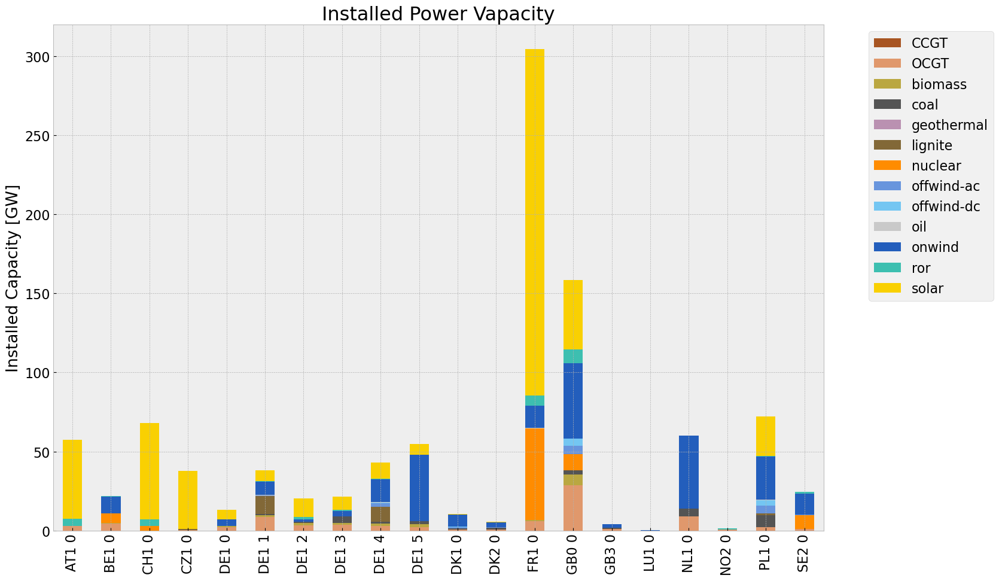

<Figure size 640x480 with 0 Axes>

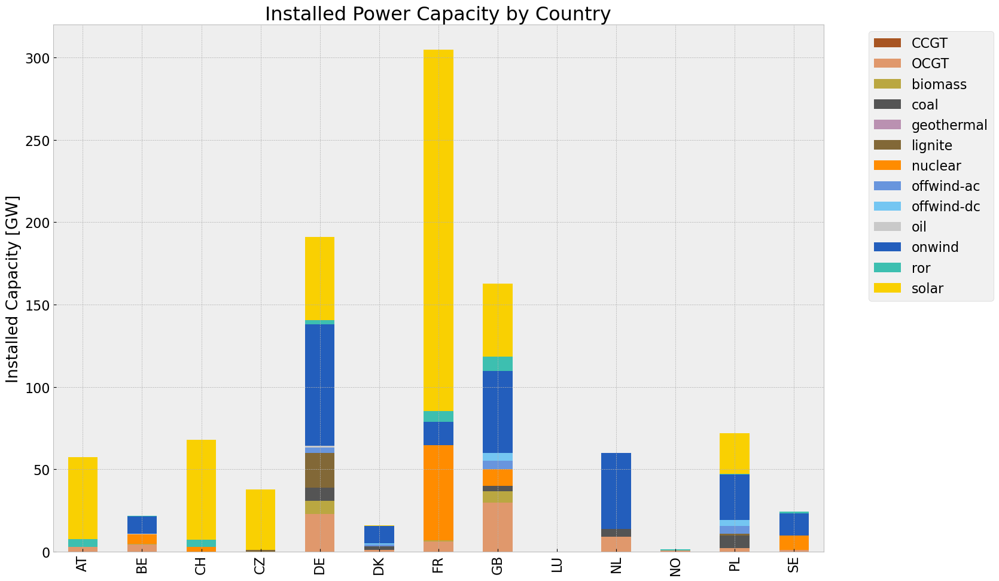

<Figure size 640x480 with 0 Axes>

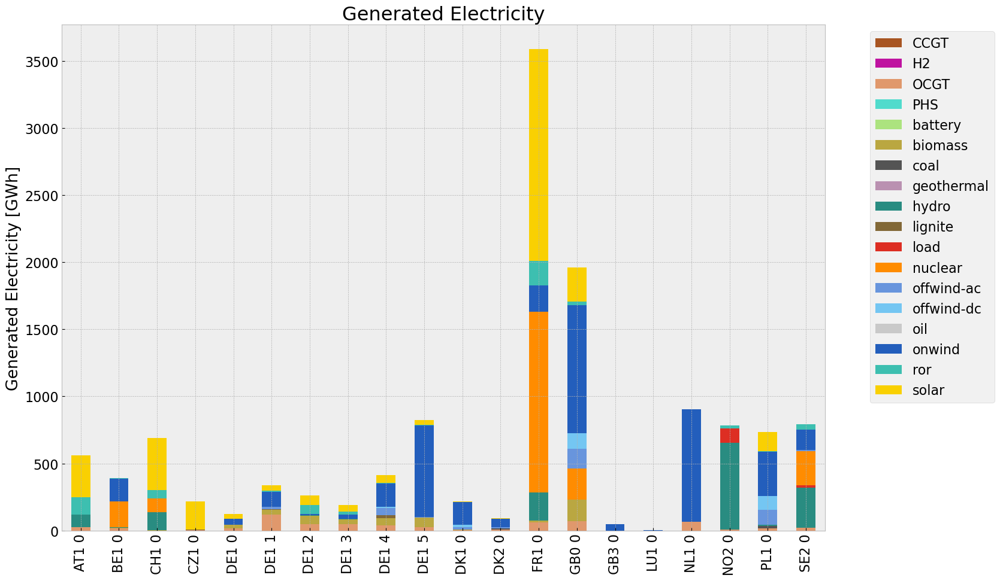

<Figure size 640x480 with 0 Axes>

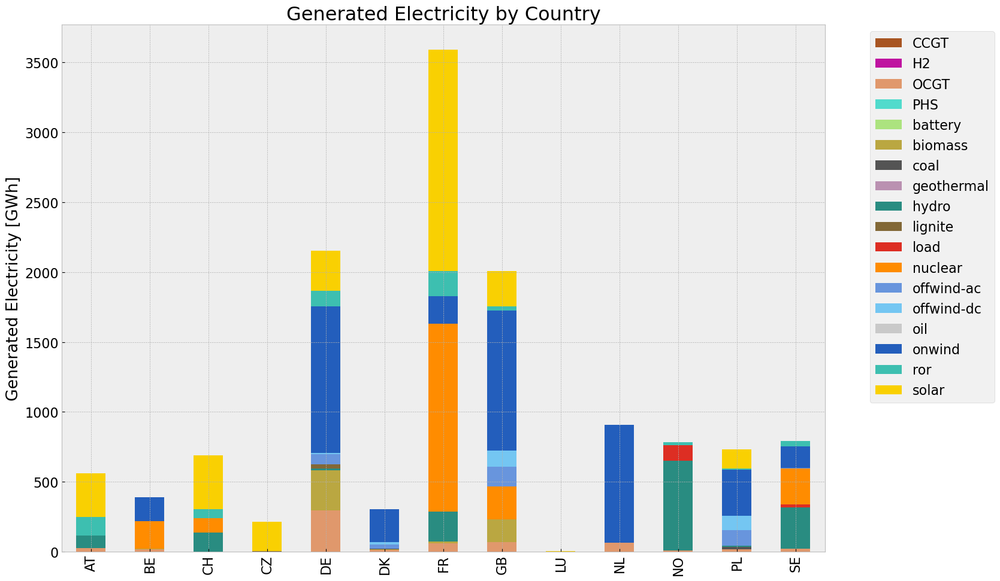

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,5.974587e+05,0.451621,0.1980,261938.380893
biomass,4.733575e+05,0.468000,0.0000,0.000000
coal,2.692287e+04,0.329908,0.3361,27428.180300
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,3.468601e+04,0.337285,0.4069,41845.167298
load,1.274518e+05,1.000000,0.0000,0.000000
nuclear,2.135659e+06,0.326600,0.0000,0.000000
offwind-ac,3.696111e+05,1.000000,0.0000,0.000000


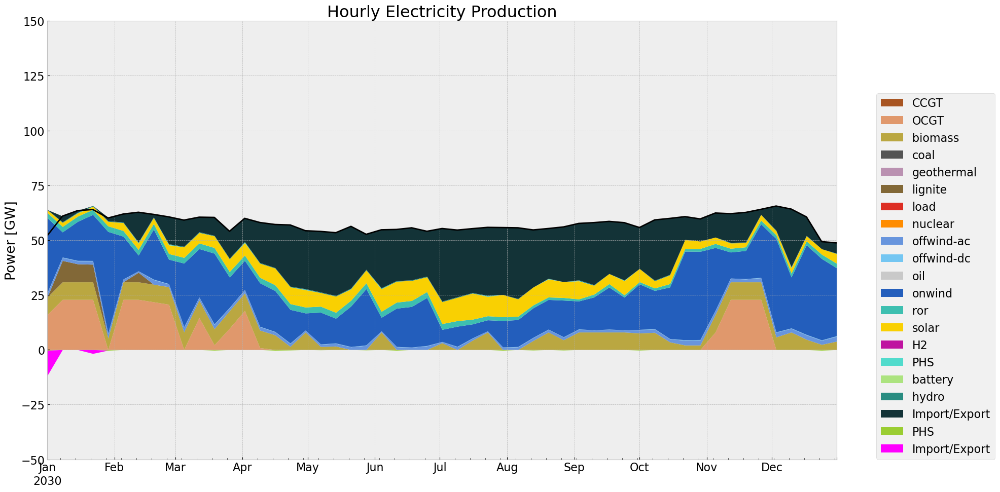

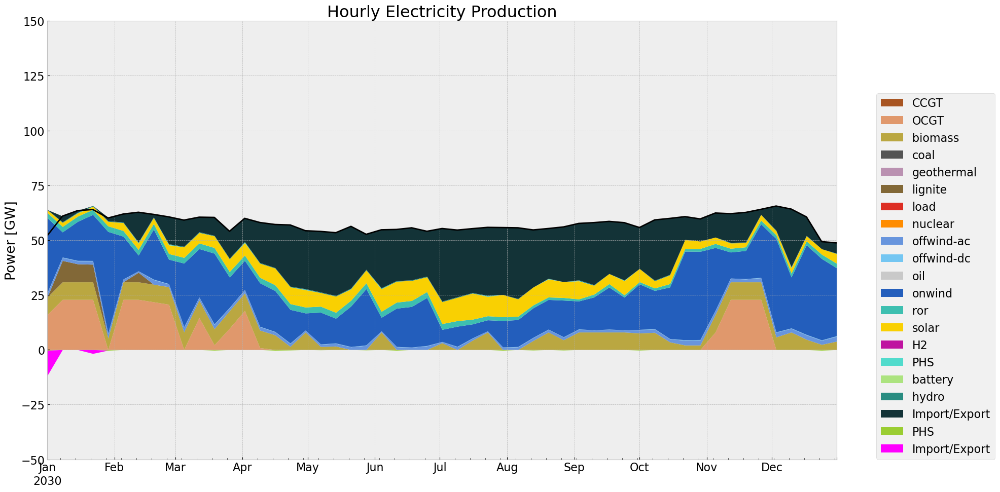

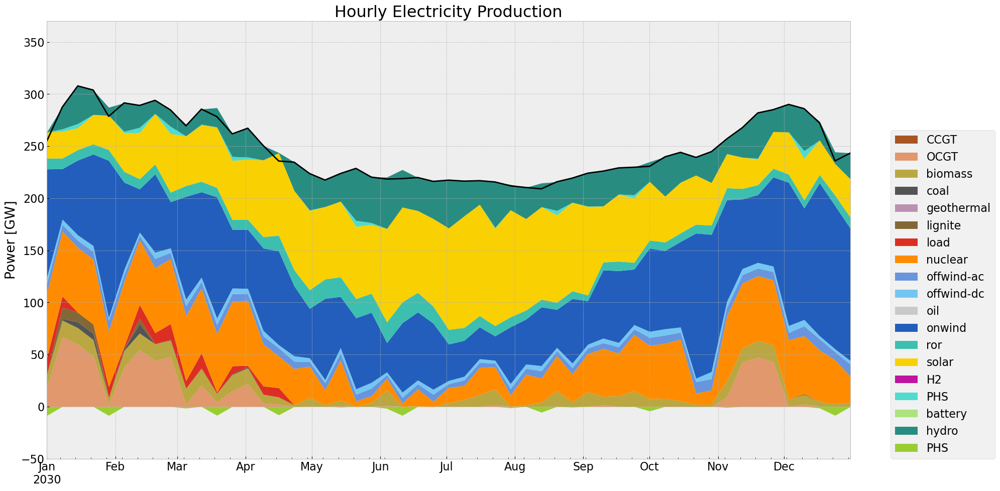

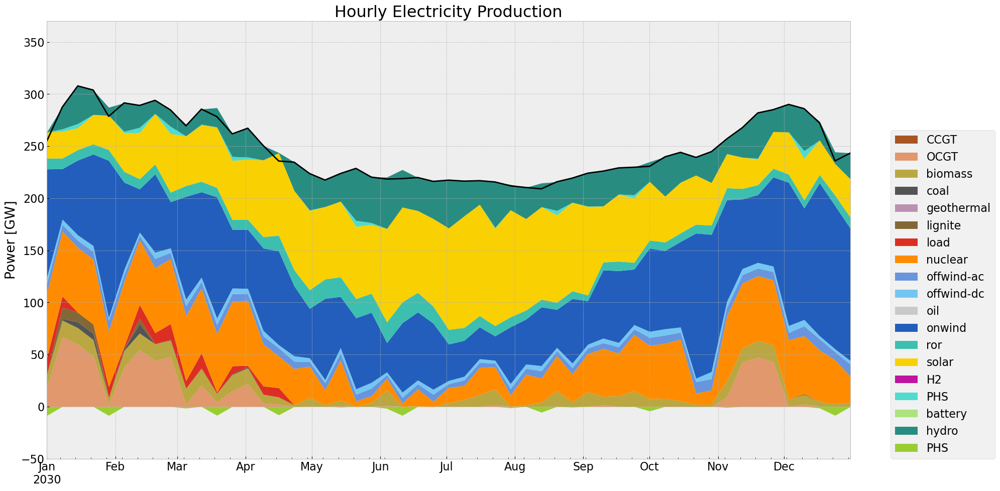

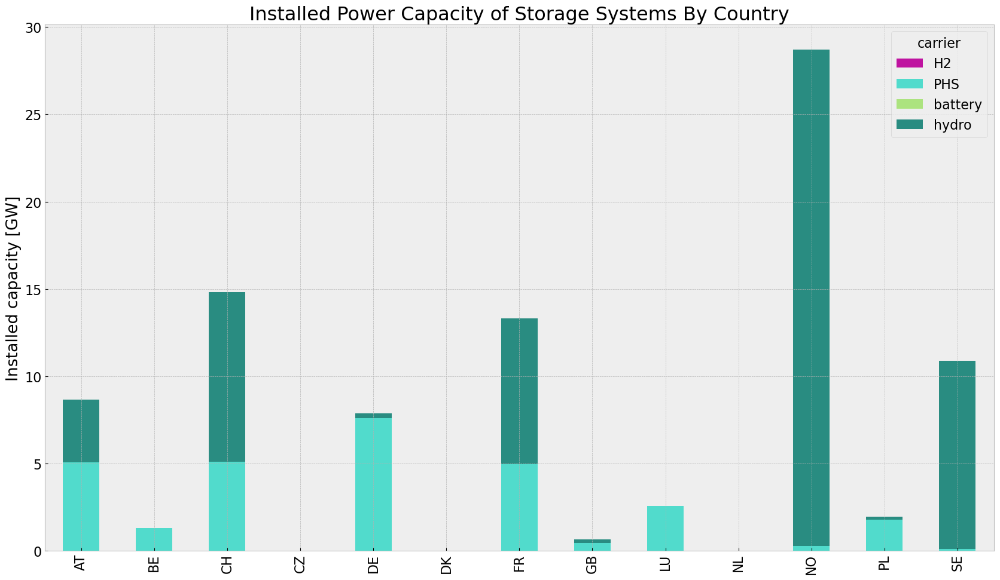

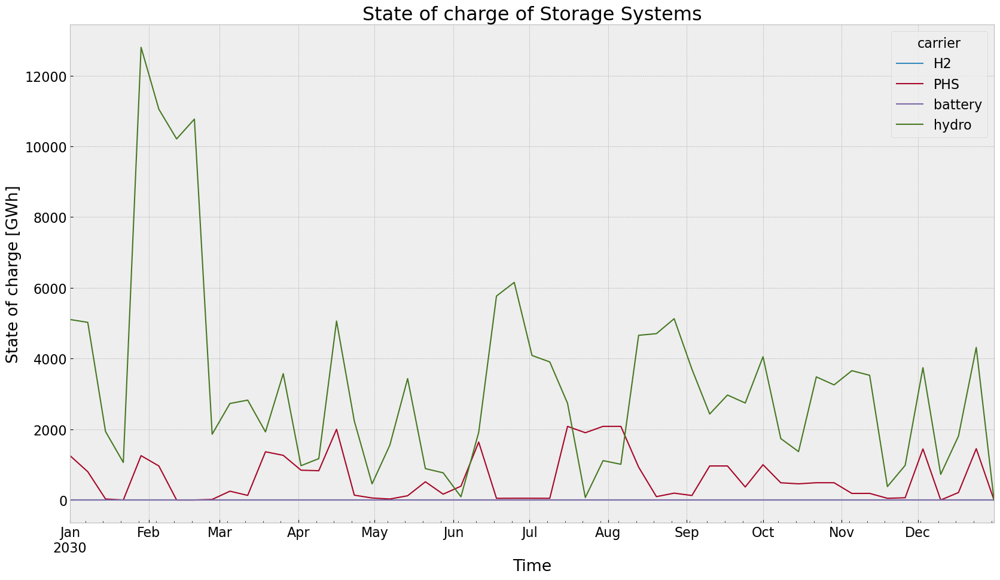

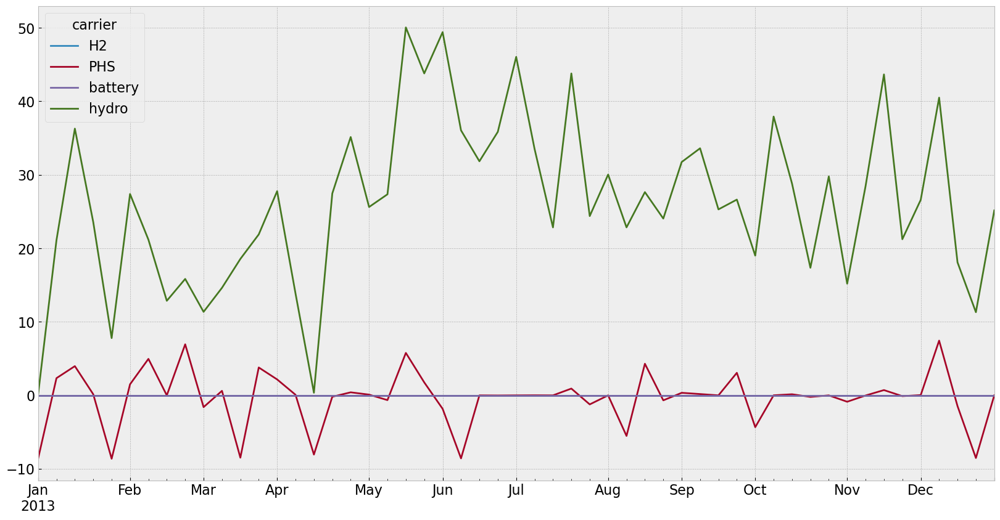

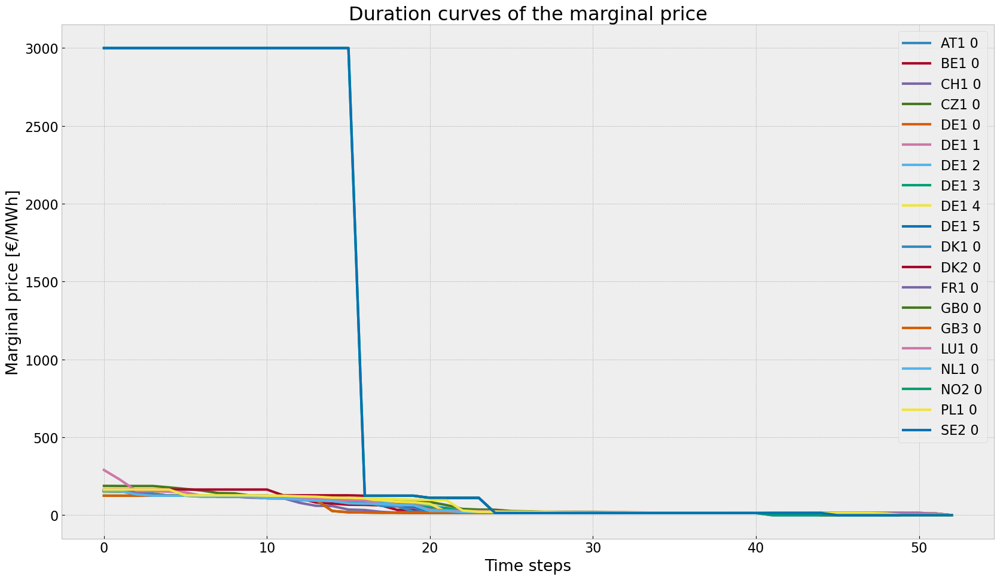

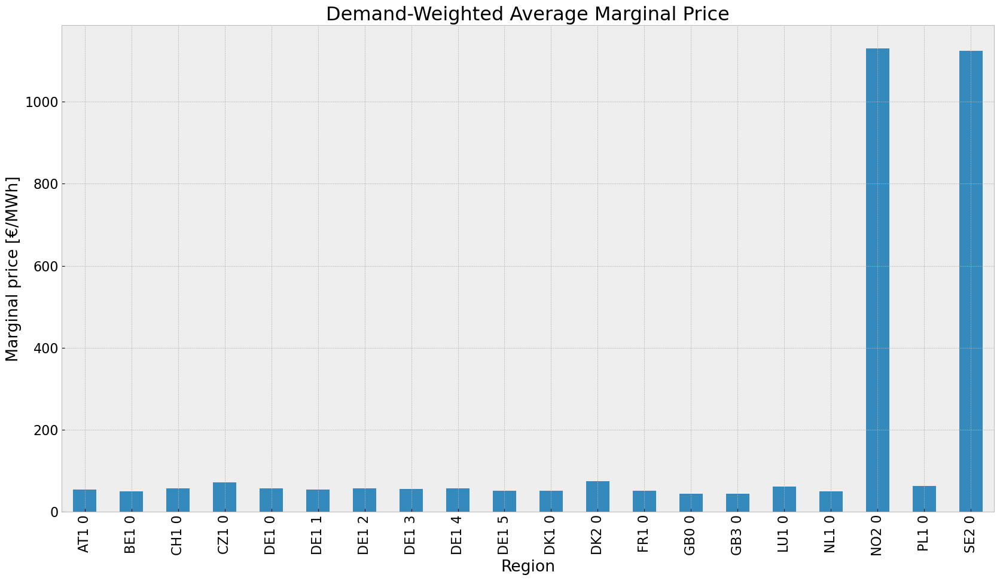

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


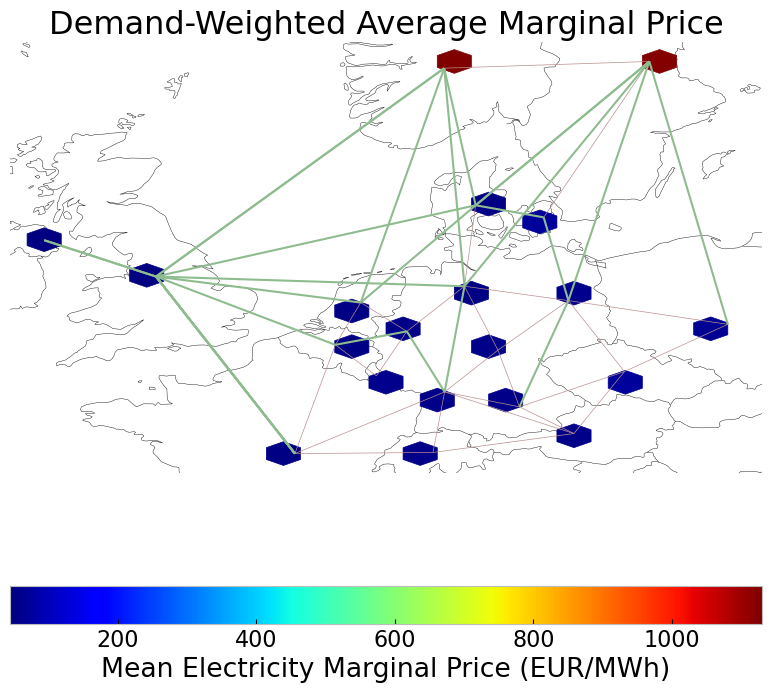

In [67]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_base_roll = inst_cap_table(n_roll, color_cap)
cap_base_roll_country = inst_cap_table_country(n_roll, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_base_roll  = gen_power_table(n_roll)
gen_base_roll_country = gen_power_table_country(n_roll)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n_roll, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n_roll, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n_roll, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n_roll, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_base_roll = inst_store_table(n_roll)

#State of Charge Storage unit
state_of_charge_plot(n_roll, '2030-01-01 00:00', '2030-12-31 21:00')
n_roll.storage_units_t.p.groupby(n_roll.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n_roll)

#avg electricity price
price_regions_table(n_roll)
price_regions(n_roll)

#Emission
em_base_roll =em_table(n_roll)
em_base_roll

### Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

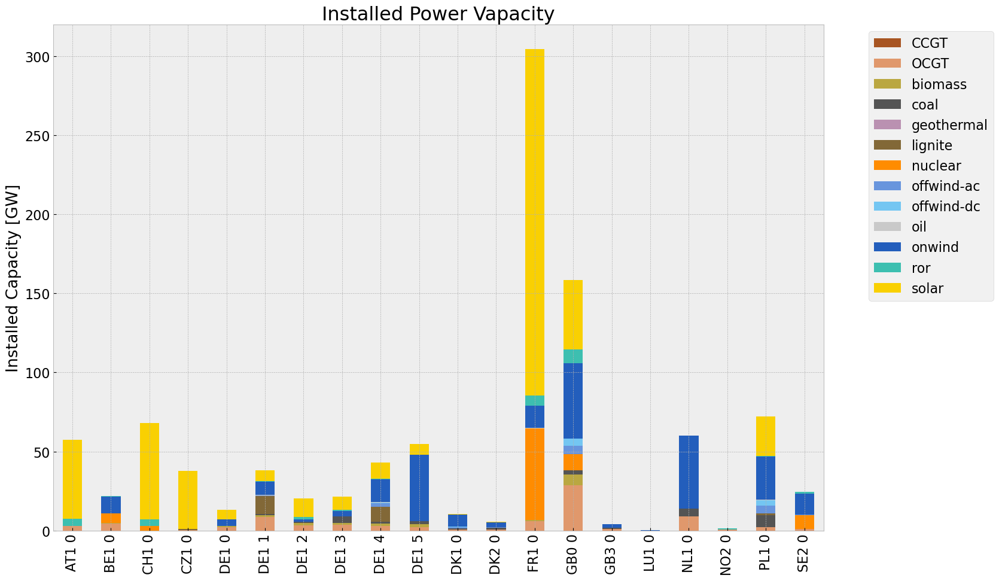

<Figure size 640x480 with 0 Axes>

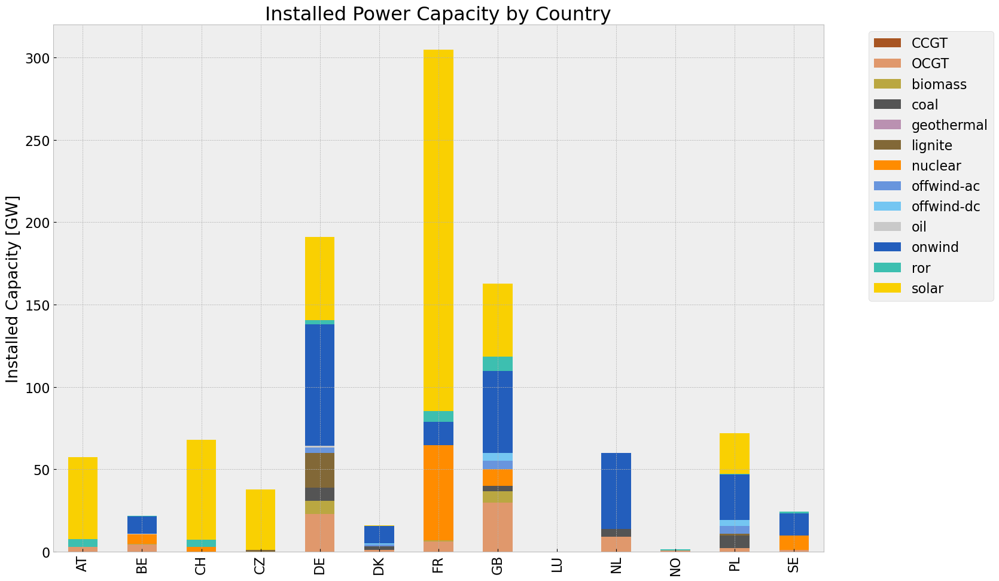

In [68]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



### Generation

<Figure size 640x480 with 0 Axes>

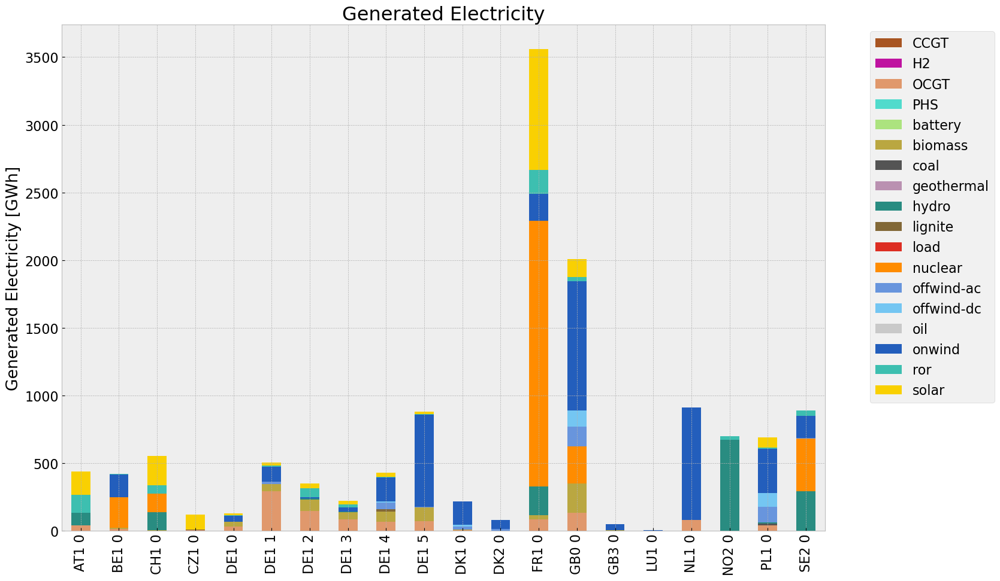

<Figure size 640x480 with 0 Axes>

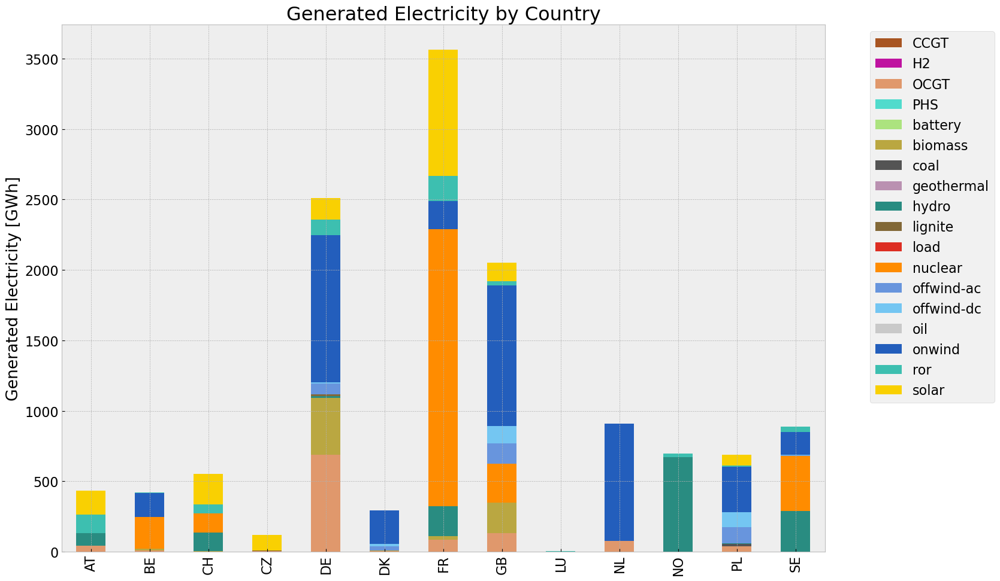

In [69]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2)
gen_noinv_country = gen_power_table_country(n2)


### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2267199707.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2267199707.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).

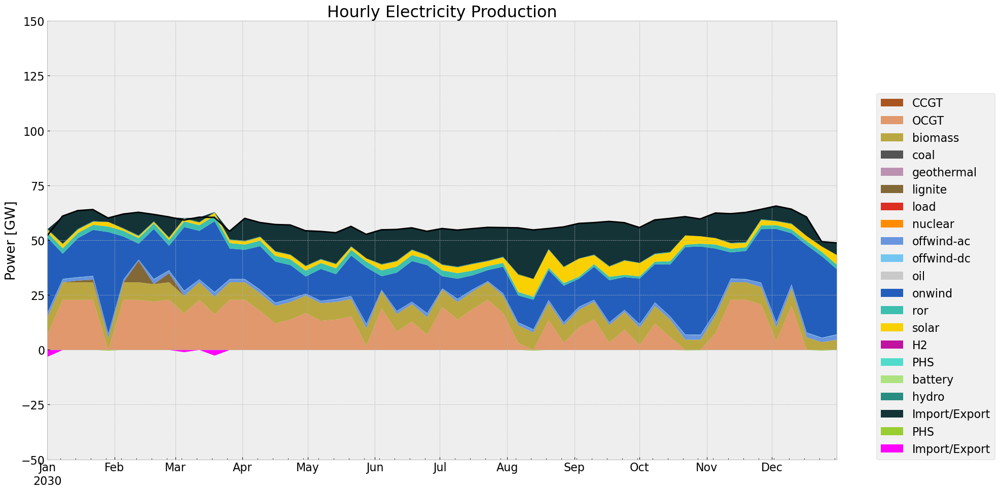

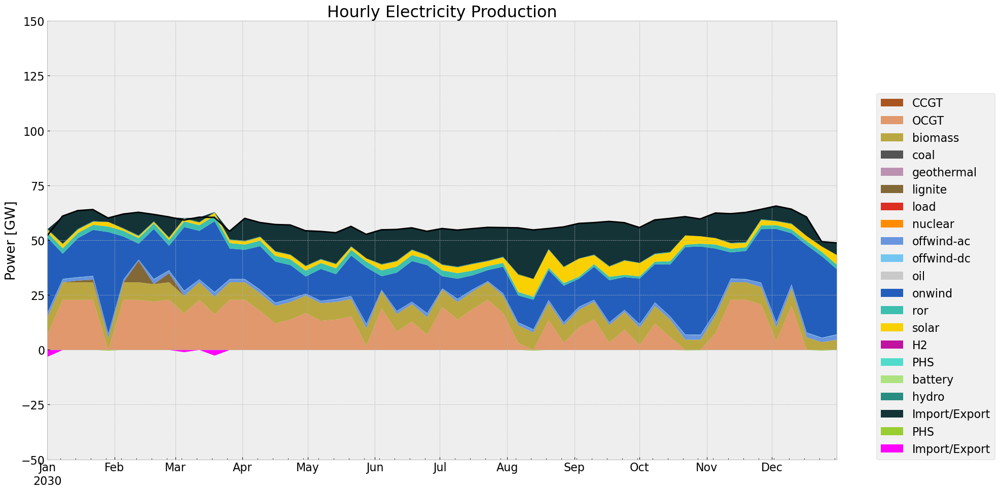

In [70]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n2, '2030-01-01', '2030-12-31', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, 

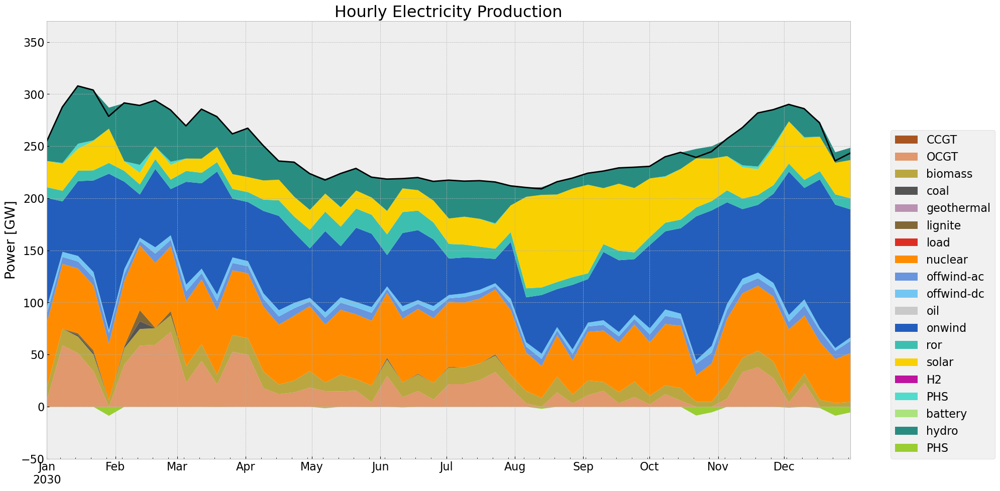

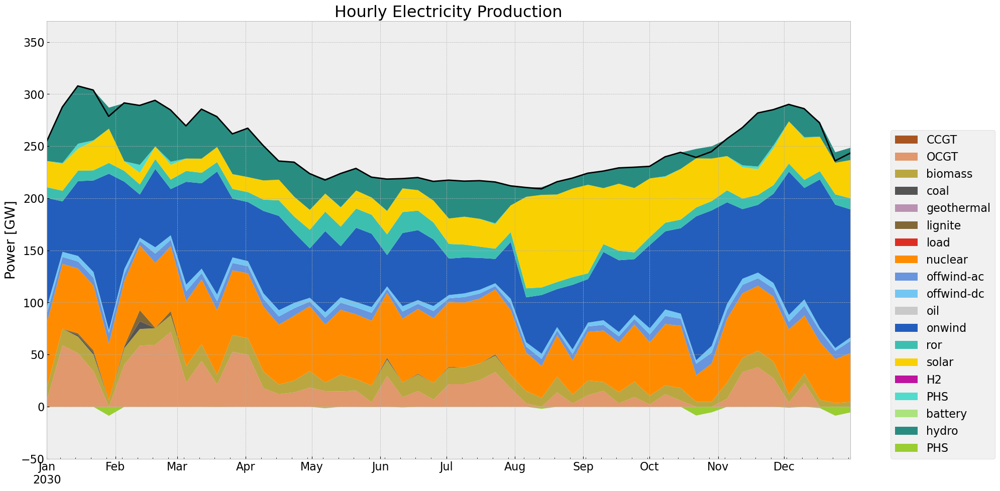

In [71]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-01-01', '2030-12-31', colors_gen)

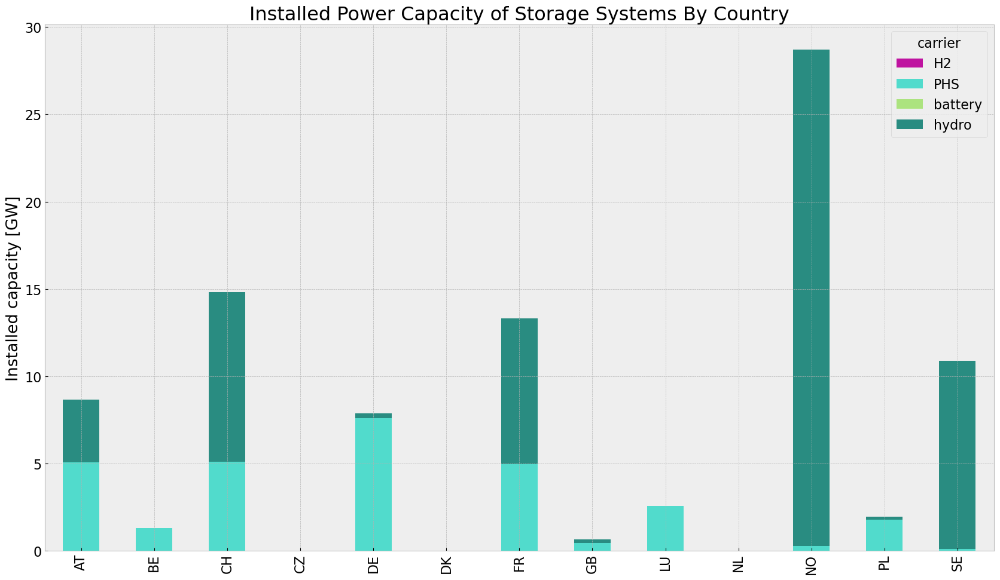

In [72]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3064997258.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carri

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,1.079148e+06,0.451621,0.1980,473121.079261
biomass,6.696783e+05,0.468000,0.0000,0.000000
coal,1.583739e+04,0.329908,0.3361,16134.641677
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,1.999086e+04,0.337285,0.4069,24116.949919
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.990928e+06,0.326600,0.0000,0.000000
offwind-ac,3.715717e+05,1.000000,0.0000,0.000000


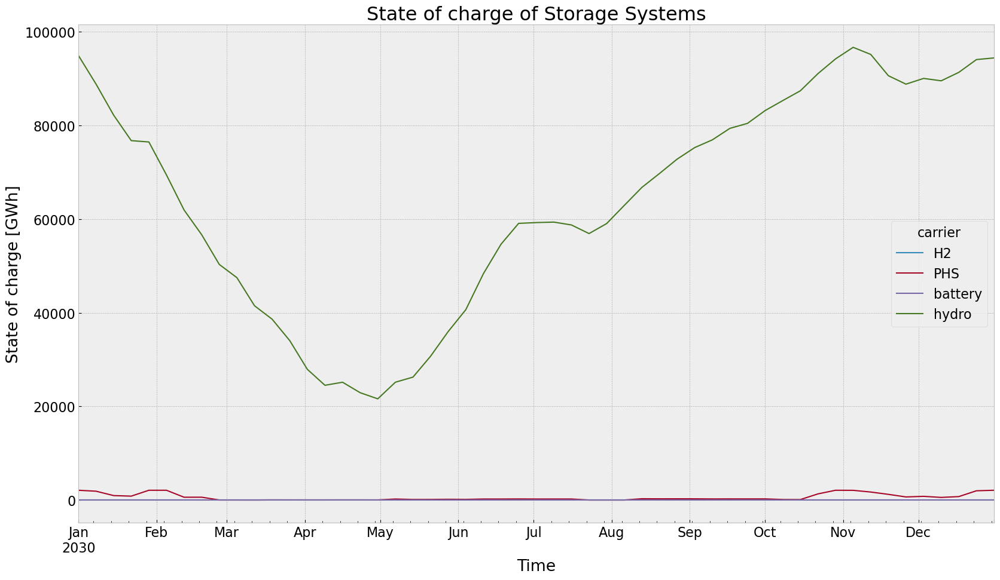

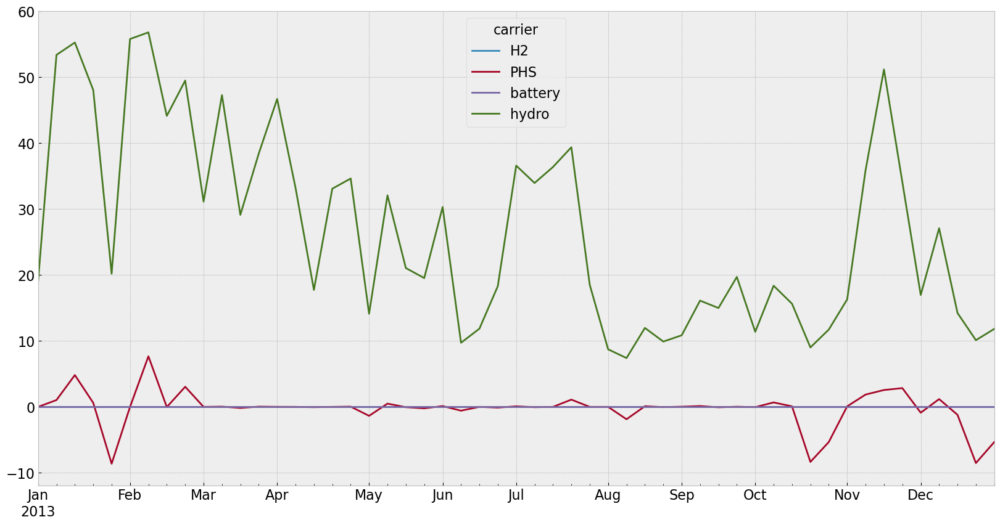

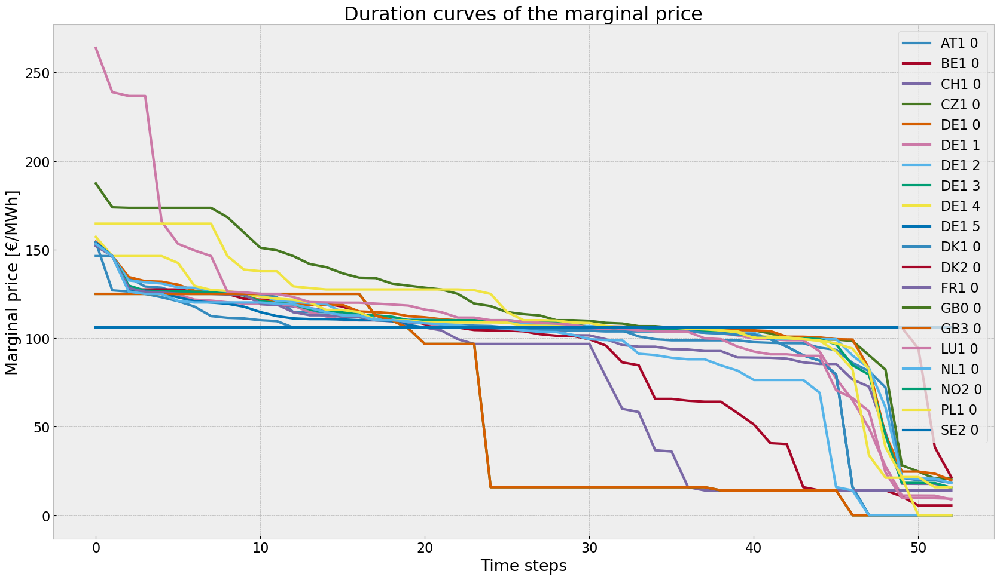

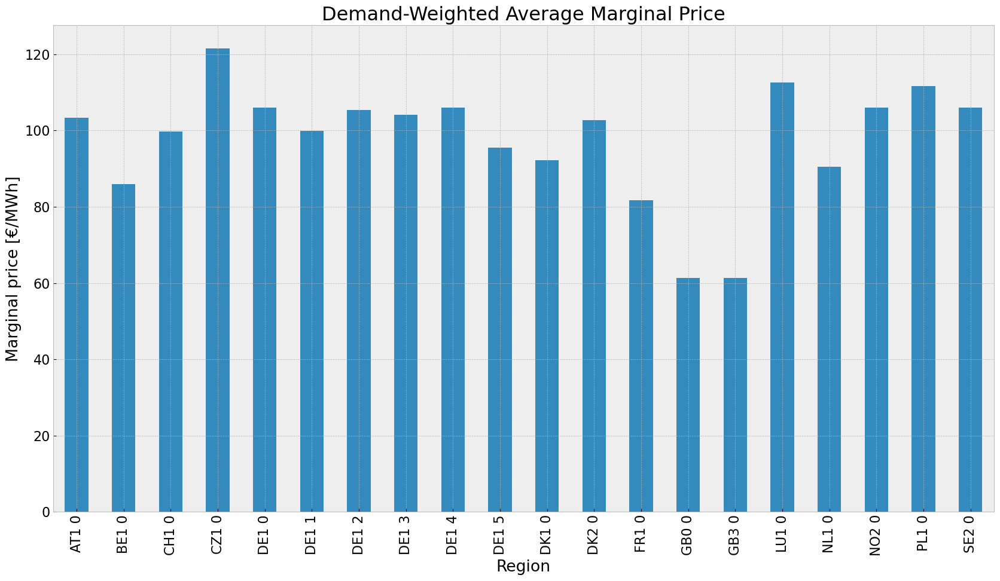

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


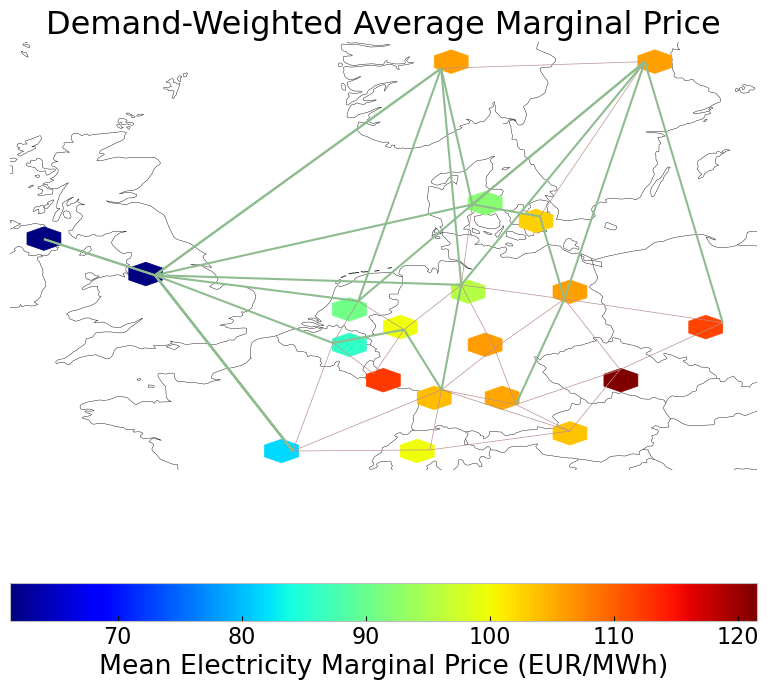

In [73]:
#state of charge
state_of_charge_plot(n2, '2030-01-01 00:00', '2030-12-31 21:00')
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Scenario: rolling horizon foresight with no additional investment

In [74]:
n3 = pvscenario(n, cut_start, duration, reductionto)

no_inv(n3,n)
n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False


optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"noinv_roll_{contingency}.nc"
#n3 = import_nc_file(directory, filename)
n3.name = f'noinv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_36u2_5n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_36u2_5n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xd7fcfe05


INFO:gurobipy:Model fingerprint: 0xd7fcfe05


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1147 columns


INFO:gurobipy:Presolve removed 4248 rows and 1147 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 937 columns, 1524 nonzeros


INFO:gurobipy:Presolved: 224 rows, 937 columns, 1524 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9320496e+08   9.022944e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9320496e+08   9.022944e+05   0.000000e+00      0s


     299    1.9176872e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     299    1.9176872e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 299 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 299 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.917687160e+10


INFO:gurobipy:Optimal objective  1.917687160e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.92e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x_z00k3_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x_z00k3_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x16a13cae


INFO:gurobipy:Model fingerprint: 0x16a13cae


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4249 rows and 1160 columns


INFO:gurobipy:Presolve removed 4249 rows and 1160 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 924 columns, 1505 nonzeros


INFO:gurobipy:Presolved: 223 rows, 924 columns, 1505 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1933371e+09   8.458803e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1933371e+09   8.458803e+05   0.000000e+00      0s


     273    2.4482703e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     273    2.4482703e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 273 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 273 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.448270291e+10


INFO:gurobipy:Optimal objective  2.448270291e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.45e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fx41tubt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fx41tubt.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x6a373163


INFO:gurobipy:Model fingerprint: 0x6a373163


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4249 rows and 1152 columns


INFO:gurobipy:Presolve removed 4249 rows and 1152 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 932 columns, 1513 nonzeros


INFO:gurobipy:Presolved: 223 rows, 932 columns, 1513 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3452454e+09   8.916683e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3452454e+09   8.916683e+05   0.000000e+00      0s


     315    2.4585301e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     315    2.4585301e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 315 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 315 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.458530106e+10


INFO:gurobipy:Optimal objective  2.458530106e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.46e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7ya2c6lr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7ya2c6lr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x39865953


INFO:gurobipy:Model fingerprint: 0x39865953


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4255 rows and 1156 columns


INFO:gurobipy:Presolve removed 4255 rows and 1156 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 928 columns, 1498 nonzeros


INFO:gurobipy:Presolved: 217 rows, 928 columns, 1498 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3528137e+09   9.074162e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3528137e+09   9.074162e+05   0.000000e+00      0s


     251    1.7825577e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    1.7825577e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 251 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.782557656e+10


INFO:gurobipy:Optimal objective  1.782557656e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.78e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e64ufr4o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e64ufr4o.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xda633e0c


INFO:gurobipy:Model fingerprint: 0xda633e0c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4255 rows and 1150 columns


INFO:gurobipy:Presolve removed 4255 rows and 1150 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 217 rows, 934 columns, 1504 nonzeros


INFO:gurobipy:Presolved: 217 rows, 934 columns, 1504 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4934399e+08   9.120504e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4934399e+08   9.120504e+05   0.000000e+00      0s


     306    3.8686409e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     306    3.8686409e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 306 iterations and 0.08 seconds (0.01 work units)


INFO:gurobipy:Solved in 306 iterations and 0.08 seconds (0.01 work units)


Optimal objective  3.868640879e+09


INFO:gurobipy:Optimal objective  3.868640879e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.87e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y9oxuw5i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y9oxuw5i.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x21bba224


INFO:gurobipy:Model fingerprint: 0x21bba224


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4266 rows and 1176 columns


INFO:gurobipy:Presolve removed 4266 rows and 1176 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 206 rows, 908 columns, 1459 nonzeros


INFO:gurobipy:Presolved: 206 rows, 908 columns, 1459 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3541560e+08   9.009545e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3541560e+08   9.009545e+05   0.000000e+00      0s


     292    1.2106753e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     292    1.2106753e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 292 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 292 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.210675293e+09


INFO:gurobipy:Optimal objective  1.210675293e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g0o5bbqr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g0o5bbqr.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xa9b4fd6f


INFO:gurobipy:Model fingerprint: 0xa9b4fd6f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4254 rows and 1142 columns


INFO:gurobipy:Presolve removed 4254 rows and 1142 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 942 columns, 1518 nonzeros


INFO:gurobipy:Presolved: 218 rows, 942 columns, 1518 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4873674e+08   9.324913e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4873674e+08   9.324913e+05   0.000000e+00      0s


     315    1.6549751e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     315    1.6549751e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 315 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 315 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.654975055e+09


INFO:gurobipy:Optimal objective  1.654975055e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_4kk4n6n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_4kk4n6n.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x6fca9026


INFO:gurobipy:Model fingerprint: 0x6fca9026


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1135 columns


INFO:gurobipy:Presolve removed 4248 rows and 1135 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 949 columns, 1536 nonzeros


INFO:gurobipy:Presolved: 224 rows, 949 columns, 1536 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7310882e+08   8.953571e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7310882e+08   8.953571e+05   0.000000e+00      0s


     289    2.5793026e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     289    2.5793026e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 289 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 289 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.579302595e+09


INFO:gurobipy:Optimal objective  2.579302595e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.58e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_otd5bnw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_otd5bnw.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x156a28ae


INFO:gurobipy:Model fingerprint: 0x156a28ae


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1137 columns


INFO:gurobipy:Presolve removed 4248 rows and 1137 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 947 columns, 1534 nonzeros


INFO:gurobipy:Presolved: 224 rows, 947 columns, 1534 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1615286e+07   8.982206e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1615286e+07   8.982206e+05   0.000000e+00      0s


     379    3.8622026e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     379    3.8622026e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 379 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 379 iterations and 0.05 seconds (0.01 work units)


Optimal objective  3.862202647e+08


INFO:gurobipy:Optimal objective  3.862202647e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-spu7wqis.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-spu7wqis.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x4f17e84f


INFO:gurobipy:Model fingerprint: 0x4f17e84f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1142 columns


INFO:gurobipy:Presolve removed 4248 rows and 1142 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 942 columns, 1529 nonzeros


INFO:gurobipy:Presolved: 224 rows, 942 columns, 1529 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6013515e+07   9.006435e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6013515e+07   9.006435e+05   0.000000e+00      0s


     292    7.0792578e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     292    7.0792578e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 292 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 292 iterations and 0.04 seconds (0.01 work units)


Optimal objective  7.079257814e+08


INFO:gurobipy:Optimal objective  7.079257814e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 7.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ujo6hg59.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ujo6hg59.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x30ef51a9


INFO:gurobipy:Model fingerprint: 0x30ef51a9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1136 columns


INFO:gurobipy:Presolve removed 4248 rows and 1136 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 948 columns, 1535 nonzeros


INFO:gurobipy:Presolved: 224 rows, 948 columns, 1535 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1288144e+05   8.969974e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1288144e+05   8.969974e+05   0.000000e+00      0s


     332    5.0520030e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     332    5.0520030e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 332 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 332 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.052003006e+08


INFO:gurobipy:Optimal objective  5.052003006e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qysclc3e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qysclc3e.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x399422e4


INFO:gurobipy:Model fingerprint: 0x399422e4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1133 columns


INFO:gurobipy:Presolve removed 4248 rows and 1133 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 951 columns, 1538 nonzeros


INFO:gurobipy:Presolved: 224 rows, 951 columns, 1538 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2054966e+07   8.642865e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2054966e+07   8.642865e+05   0.000000e+00      0s


     357    3.4146349e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     357    3.4146349e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 357 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 357 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.414634854e+09


INFO:gurobipy:Optimal objective  3.414634854e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.41e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-75x1bys3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-75x1bys3.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xe2e21a82


INFO:gurobipy:Model fingerprint: 0xe2e21a82


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1155 columns


INFO:gurobipy:Presolve removed 4248 rows and 1155 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 929 columns, 1516 nonzeros


INFO:gurobipy:Presolved: 224 rows, 929 columns, 1516 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4233708e+05   8.867421e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4233708e+05   8.867421e+05   0.000000e+00      0s


     265    9.0572788e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     265    9.0572788e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 265 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 265 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.057278818e+08


INFO:gurobipy:Optimal objective  9.057278818e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9sbmbkcs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9sbmbkcs.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0xfea831f3


INFO:gurobipy:Model fingerprint: 0xfea831f3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 314 columns


INFO:gurobipy:Presolve removed 1072 rows and 314 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 46 rows, 207 columns, 325 nonzeros


INFO:gurobipy:Presolved: 46 rows, 207 columns, 325 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2592674e+04   8.611146e+04   0.000000e+00      0s


INFO:gurobipy:       0    3.2592674e+04   8.611146e+04   0.000000e+00      0s


      41    9.9654766e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      41    9.9654766e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 41 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 41 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.965476552e+06


INFO:gurobipy:Optimal objective  9.965476552e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 9.97e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [75]:
filename = f"{n3.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n3.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_roll_pv.nc has links, generators, storage_units, buses, lines, loads, global_constraints, carriers


<xarray.Dataset> Size: 279kB
Dimensions:                                          (snapshots: 53,
                                                      investment_periods: 0,
                                                      links_i: 28,
                                                      links_t_p0_i: 12,
                                                      links_t_p1_i: 12,
                                                      generators_i: 261,
                                                      ...
                                                      lines_t_loss_i: 27,
                                                      loads_i: 20,
                                                      loads_t_p_set_i: 20,
                                                      loads_t_p_i: 20,
                                                      global_constraints_i: 1,
                                                      carriers_i: 21)
Coordinates: (12/28)
  * snapshots                                        (snapshots) int64 424B 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * links_i                                          (links_i) object 224B '1...
  * links_t_p0_i                                     (links_t_p0_i) object 96B ...
  * links_t_p1_i                                     (links_t_p1_i) object 96B ...
  * generators_i                                     (generators_i) object 2kB ...
    ...                                               ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 216B ...
  * loads_i                                          (loads_i) object 160B 'A...
  * loads_t_p_set_i                                  (loads_t_p_set_i) object 160B ...
  * loads_t_p_i                                      (loads_t_p_i) object 160B ...
  * global_constraints_i                             (global_constraints_i) object 8B ...
  * carriers_i                                       (carriers_i) object 168B ...
Data variables: (12/101)
    snapshots_snapshot                               (snapshots) datetime64[ns] 424B ...
    snapshots_objective                              (snapshots) float64 424B ...
    snapshots_generators                             (snapshots) float64 424B ...
    snapshots_stores                                 (snapshots) float64 424B ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    global_constraints_carrier_attribute             (global_constraints_i) object 8B ...
    global_constraints_sense                         (global_constraints_i) object 8B ...
    global_constraints_constant                      (global_constraints_i) float64 8B ...
    carriers_co2_emissions                           (carriers_i) float64 168B ...
    carriers_color                                   (carriers_i) object 168B ...
    carriers_nice_name                               (carriers_i) object 168B ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_roll_pv
    network_objective:       9965476.55201545
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [76]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3, country_cost) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)


<Figure size 640x480 with 0 Axes>

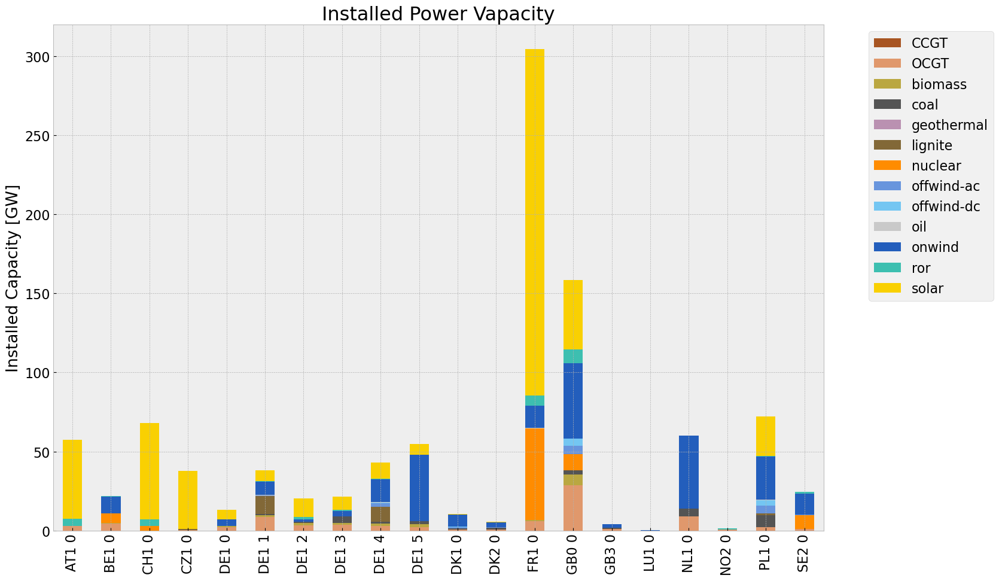

<Figure size 640x480 with 0 Axes>

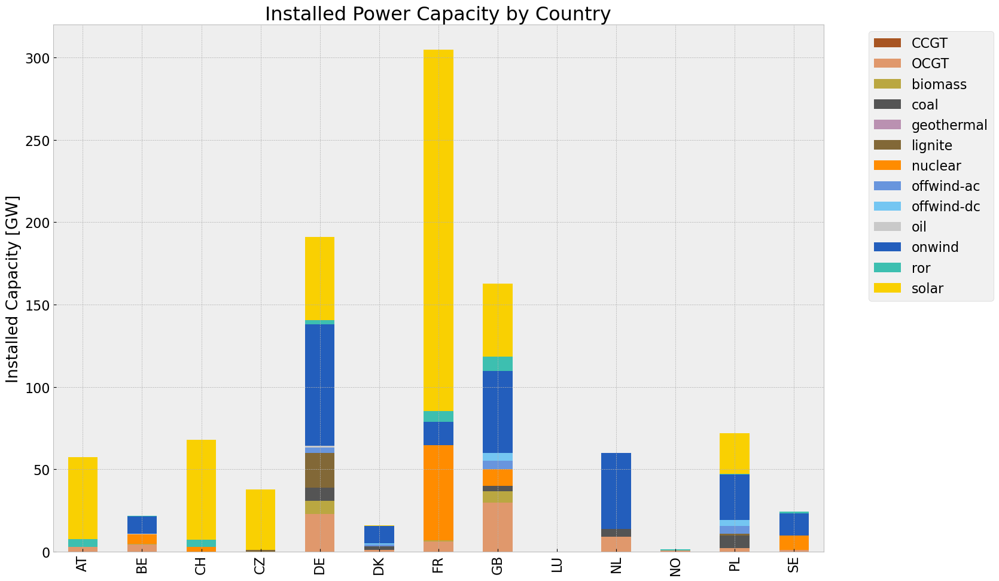

<Figure size 640x480 with 0 Axes>

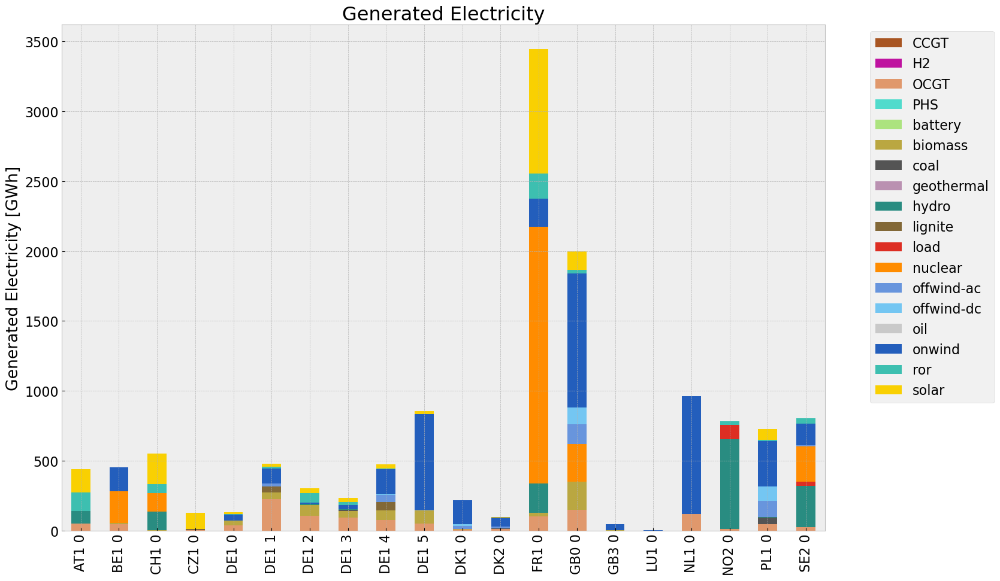

<Figure size 640x480 with 0 Axes>

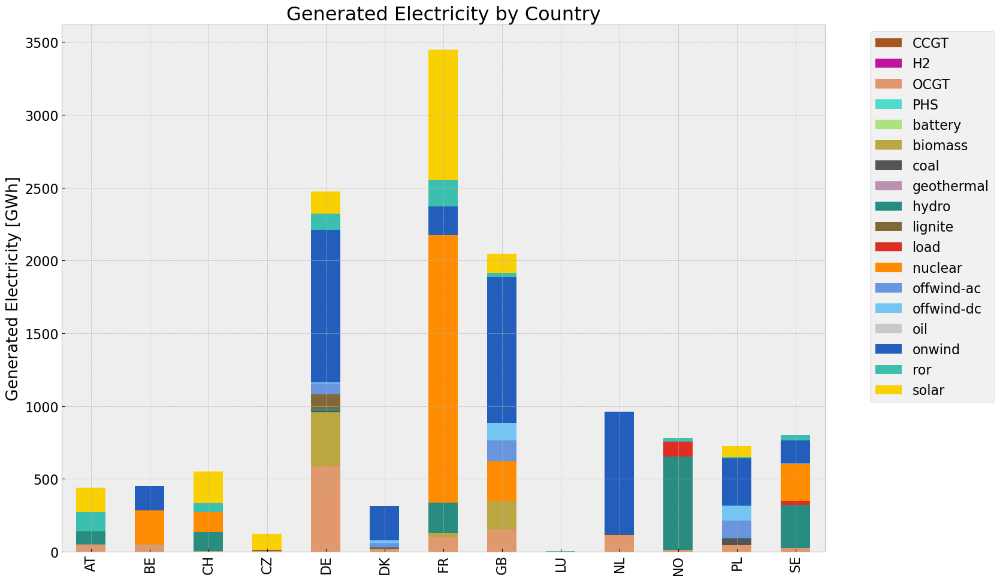

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,1.155139e+06,0.451621,0.1980,506437.217291
biomass,6.079215e+05,0.468000,0.0000,0.000000
coal,6.758995e+04,0.329908,0.3361,68858.529241
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,1.118586e+05,0.337285,0.4069,134946.161417
load,1.321912e+05,1.000000,0.0000,0.000000
nuclear,2.725626e+06,0.326600,0.0000,0.000000
offwind-ac,3.720971e+05,1.000000,0.0000,0.000000


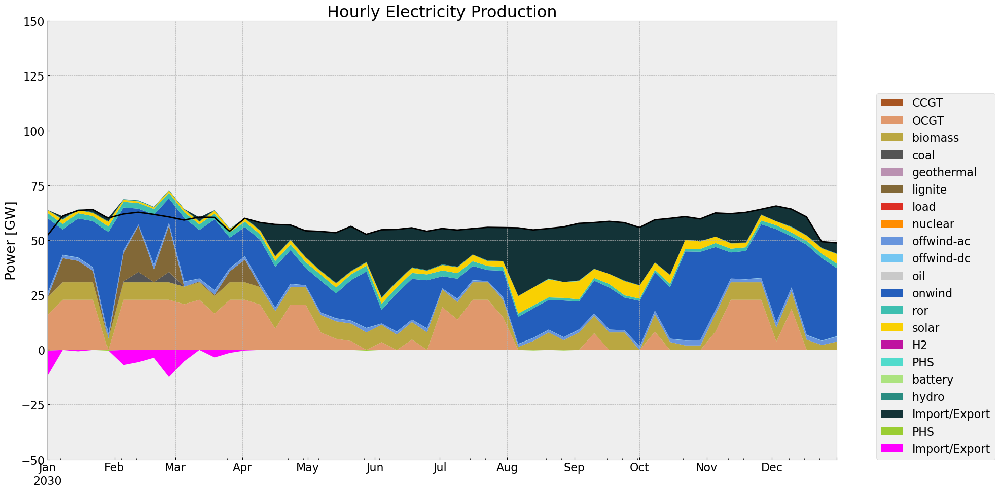

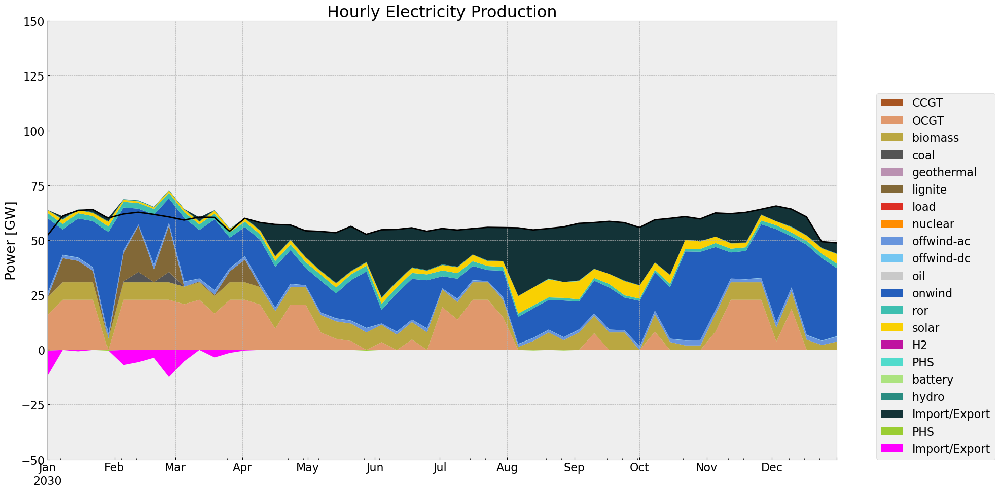

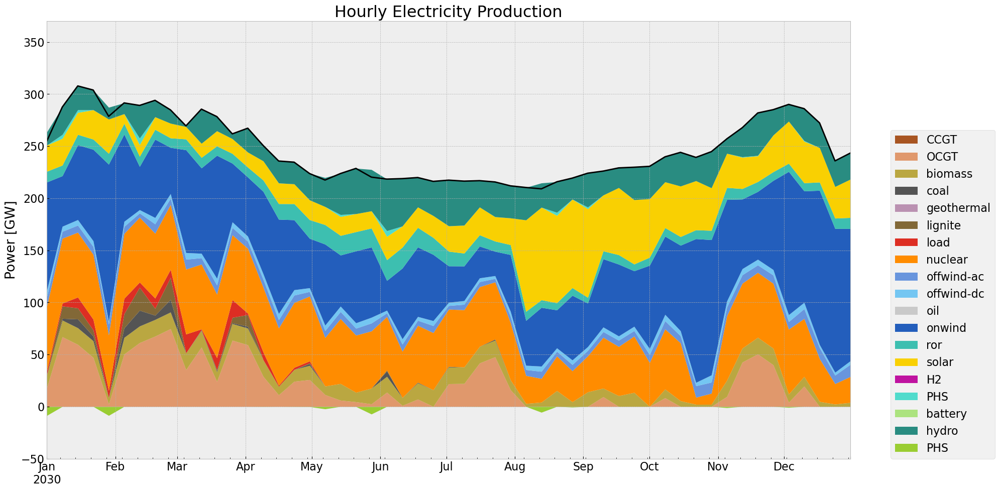

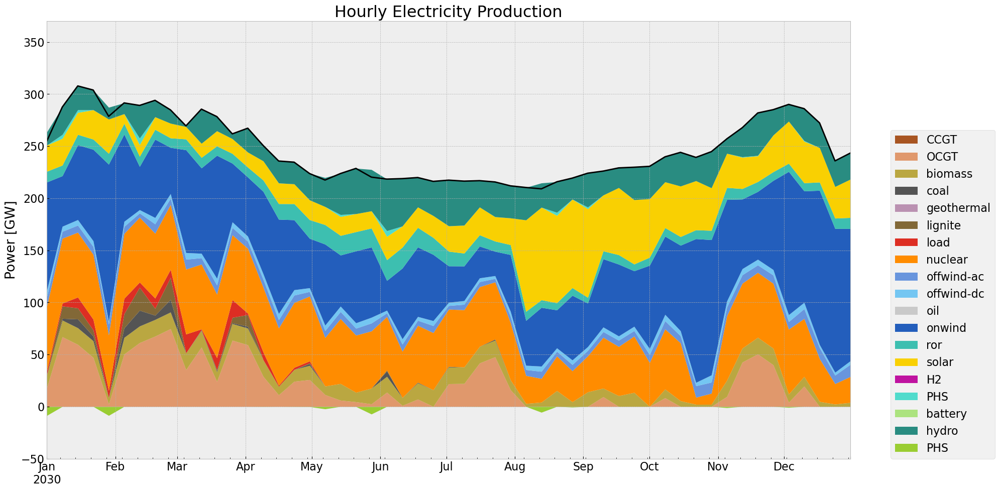

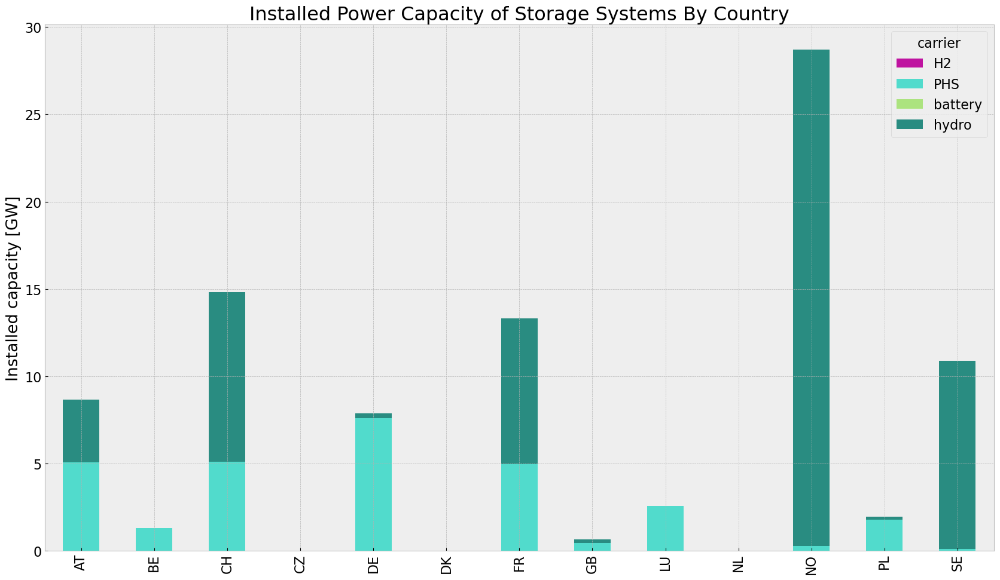

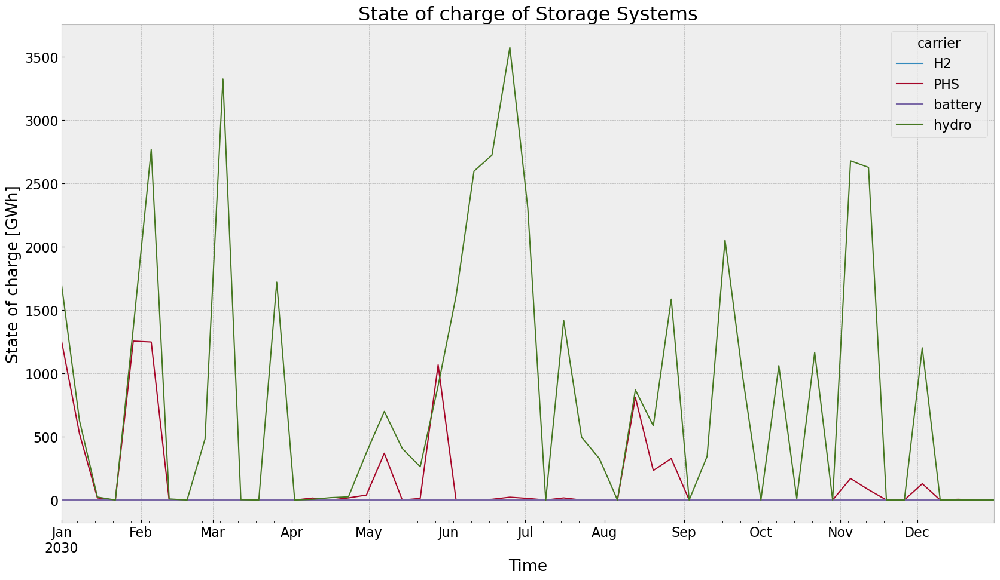

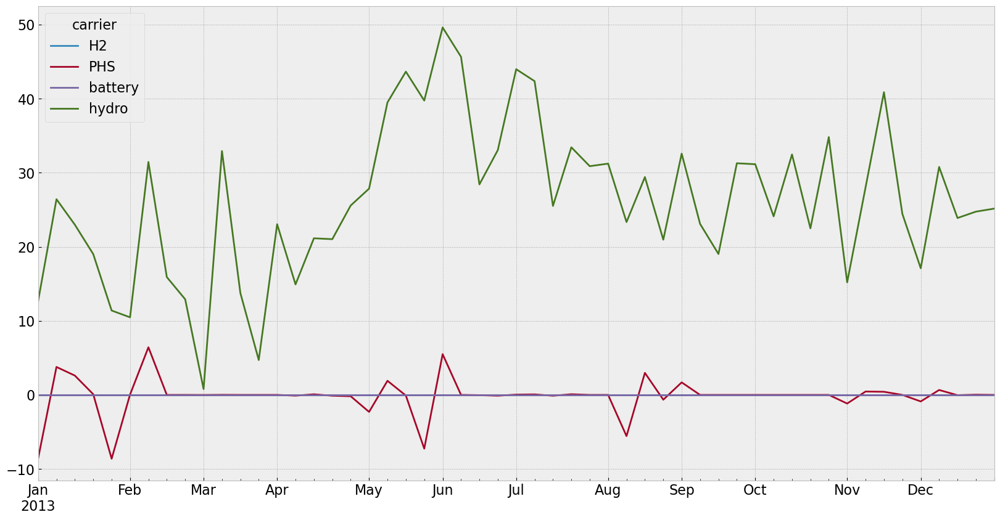

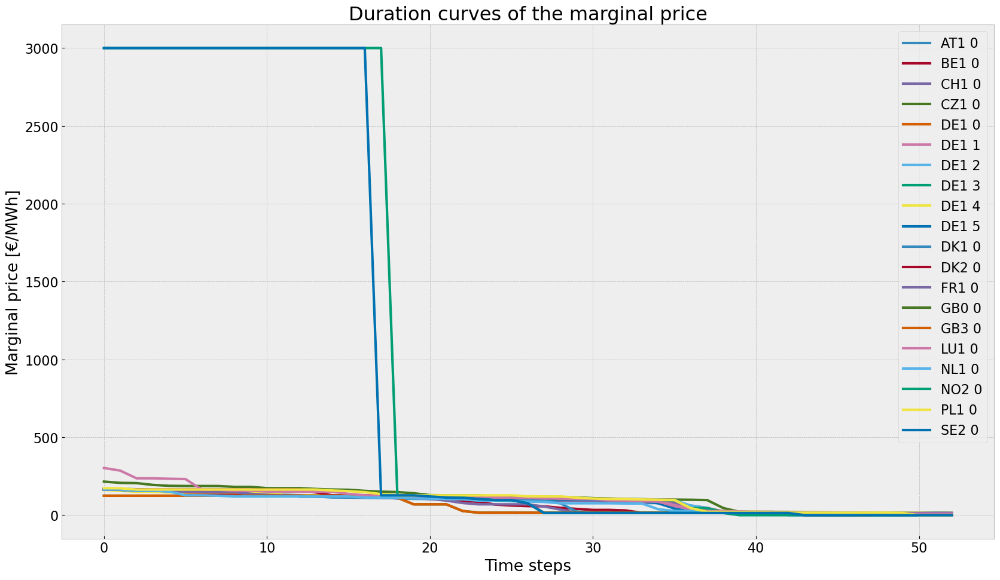

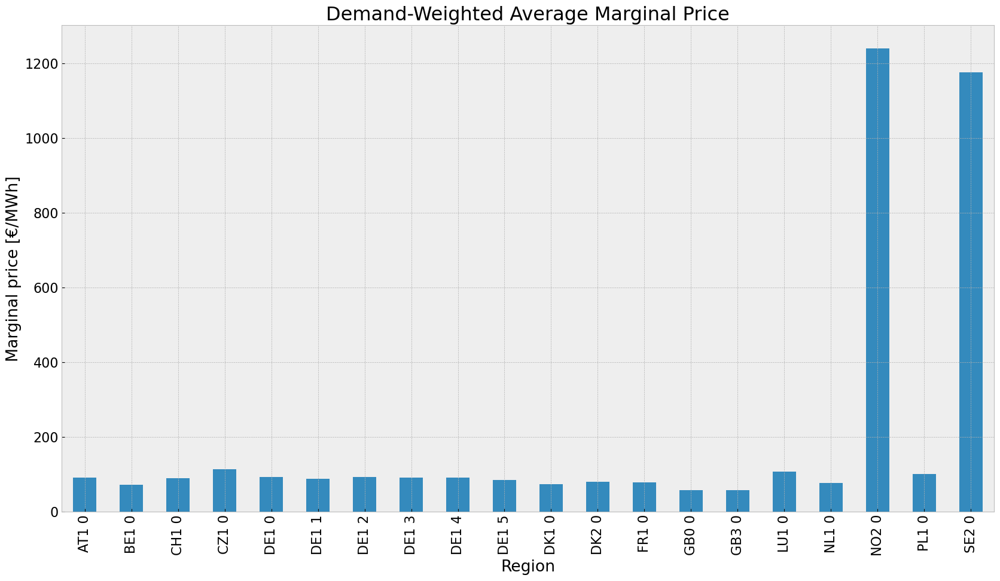

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


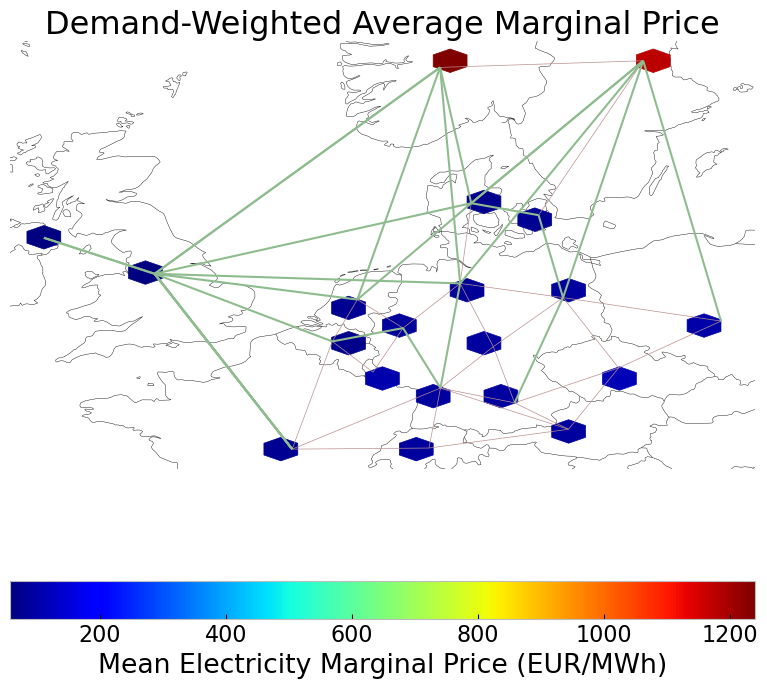

In [77]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3)
gen_noinv_roll_country = gen_power_table_country(n3)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n3, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3, '2030-01-01 00:00', '2030-12-31 21:00')
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Allowed Investment scenario solved with Rolling Horizon

In [78]:
n4 = n1.copy()

horizon = 3

no_inv(n4,n1)

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False


optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"inv_roll_{contingency}.nc"
#n4 = import_nc_file(directory, filename)
n4.name = f'inv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-drdutj2s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-drdutj2s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc0e54684


INFO:gurobipy:Model fingerprint: 0xc0e54684


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1162 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1162 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4274265e+07   9.126776e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4274265e+07   9.126776e+05   0.000000e+00      0s


     256    3.3986556e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    3.3986556e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.398655573e+09


INFO:gurobipy:Optimal objective  3.398655573e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3wijfuk7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3wijfuk7.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x54ecef32


INFO:gurobipy:Model fingerprint: 0x54ecef32


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 708 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8322965e+05   9.024819e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8322965e+05   9.024819e+05   0.000000e+00      0s


     195    2.3818653e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    2.3818653e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.381865313e+09


INFO:gurobipy:Optimal objective  2.381865313e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.38e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v6u949wc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v6u949wc.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x81f9f5ab


INFO:gurobipy:Model fingerprint: 0x81f9f5ab


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0624199e+08   9.035658e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0624199e+08   9.035658e+05   0.000000e+00      0s


     222    9.5339303e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    9.5339303e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.533930329e+09


INFO:gurobipy:Optimal objective  9.533930329e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.53e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e_dwi7se.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e_dwi7se.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x86b2a9d3


INFO:gurobipy:Model fingerprint: 0x86b2a9d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 717 columns, 1163 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1163 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5901388e+07   9.157563e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5901388e+07   9.157563e+05   0.000000e+00      0s


     193    2.1247565e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     193    2.1247565e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 193 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 193 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.124756543e+09


INFO:gurobipy:Optimal objective  2.124756543e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.12e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yfbyl4_u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yfbyl4_u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbaabaac4


INFO:gurobipy:Model fingerprint: 0xbaabaac4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3189 rows and 850 columns


INFO:gurobipy:Presolve removed 3189 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 713 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 165 rows, 713 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1621450e+07   9.169662e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1621450e+07   9.169662e+05   0.000000e+00      0s


     198    3.7522963e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    3.7522963e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.752296290e+09


INFO:gurobipy:Optimal objective  3.752296290e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.75e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mdw6hgfo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mdw6hgfo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc2234ebd


INFO:gurobipy:Model fingerprint: 0xc2234ebd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 847 columns


INFO:gurobipy:Presolve removed 3196 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 716 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 158 rows, 716 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3033510e+04   9.109553e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3033510e+04   9.109553e+05   0.000000e+00      0s


     234    9.0331807e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    9.0331807e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.033180706e+08


INFO:gurobipy:Optimal objective  9.033180706e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2zmhrf3p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2zmhrf3p.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe42a968e


INFO:gurobipy:Model fingerprint: 0xe42a968e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 851 columns


INFO:gurobipy:Presolve removed 3192 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 712 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 162 rows, 712 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.7991899e+04   9.218185e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.7991899e+04   9.218185e+05   0.000000e+00      0s


     215    4.4312520e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    4.4312520e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.431252019e+08


INFO:gurobipy:Optimal objective  4.431252019e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-plr0_amr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-plr0_amr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe02c58bb


INFO:gurobipy:Model fingerprint: 0xe02c58bb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 866 columns


INFO:gurobipy:Presolve removed 3201 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 697 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 153 rows, 697 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1472561e+07   9.196156e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1472561e+07   9.196156e+05   0.000000e+00      0s


     201    4.6680987e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    4.6680987e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.668098681e+08


INFO:gurobipy:Optimal objective  4.668098681e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qt_n9clc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qt_n9clc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaffcb7c2


INFO:gurobipy:Model fingerprint: 0xaffcb7c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 842 columns


INFO:gurobipy:Presolve removed 3192 rows and 842 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 721 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 162 rows, 721 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4113556e+05   9.245791e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4113556e+05   9.245791e+05   0.000000e+00      0s


     237    4.6919320e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    4.6919320e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.691932015e+08


INFO:gurobipy:Optimal objective  4.691932015e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kdva2z6z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kdva2z6z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbdeea1e4


INFO:gurobipy:Model fingerprint: 0xbdeea1e4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 837 columns


INFO:gurobipy:Presolve removed 3186 rows and 837 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 726 columns, 1172 nonzeros


INFO:gurobipy:Presolved: 168 rows, 726 columns, 1172 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7019998e+07   9.187335e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7019998e+07   9.187335e+05   0.000000e+00      0s


     270    2.0339010e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     270    2.0339010e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 270 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 270 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.033900974e+09


INFO:gurobipy:Optimal objective  2.033900974e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v6z8glsv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v6z8glsv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbeb9fa0d


INFO:gurobipy:Model fingerprint: 0xbeb9fa0d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 838 columns


INFO:gurobipy:Presolve removed 3186 rows and 838 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 725 columns, 1171 nonzeros


INFO:gurobipy:Presolved: 168 rows, 725 columns, 1171 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -7.0708961e+03   9.229406e+05   0.000000e+00      0s


INFO:gurobipy:       0   -7.0708961e+03   9.229406e+05   0.000000e+00      0s


     197    2.4015534e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    2.4015534e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.401553361e+08


INFO:gurobipy:Optimal objective  2.401553361e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_8wnugwj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_8wnugwj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6fc4a5b1


INFO:gurobipy:Model fingerprint: 0x6fc4a5b1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.3103358e+04   9.079585e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.3103358e+04   9.079585e+05   0.000000e+00      0s


     274    2.5568458e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     274    2.5568458e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 274 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 274 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.556845756e+08


INFO:gurobipy:Optimal objective  2.556845756e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2oxi863j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2oxi863j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9d98a0bf


INFO:gurobipy:Model fingerprint: 0x9d98a0bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 720 columns, 1166 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1166 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.8723740e+04   9.006241e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.8723740e+04   9.006241e+05   0.000000e+00      0s


     275    3.5771424e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     275    3.5771424e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 275 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 275 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.577142430e+08


INFO:gurobipy:Optimal objective  3.577142430e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mm912go0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mm912go0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5d7e840b


INFO:gurobipy:Model fingerprint: 0x5d7e840b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 833 columns


INFO:gurobipy:Presolve removed 3186 rows and 833 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 730 columns, 1176 nonzeros


INFO:gurobipy:Presolved: 168 rows, 730 columns, 1176 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5285509e+04   9.063436e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5285509e+04   9.063436e+05   0.000000e+00      0s


     246    3.2428535e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    3.2428535e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.242853493e+08


INFO:gurobipy:Optimal objective  3.242853493e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-drxeqc75.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-drxeqc75.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0f38ae68


INFO:gurobipy:Model fingerprint: 0x0f38ae68


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 714 columns, 1160 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1160 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.6292042e+04   9.067531e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.6292042e+04   9.067531e+05   0.000000e+00      0s


     226    6.5359796e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    6.5359796e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.535979565e+07


INFO:gurobipy:Optimal objective  6.535979565e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.54e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bw2ogz_0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bw2ogz_0.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0f845629


INFO:gurobipy:Model fingerprint: 0x0f845629


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 836 columns


INFO:gurobipy:Presolve removed 3186 rows and 836 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 727 columns, 1173 nonzeros


INFO:gurobipy:Presolved: 168 rows, 727 columns, 1173 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5655632e+05   8.871021e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5655632e+05   8.871021e+05   0.000000e+00      0s


     247    2.5945513e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    2.5945513e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.594551323e+09


INFO:gurobipy:Optimal objective  2.594551323e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.59e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lz8cga8f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lz8cga8f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdb1e457c


INFO:gurobipy:Model fingerprint: 0xdb1e457c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4010227e+05   8.854092e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4010227e+05   8.854092e+05   0.000000e+00      0s


     212    3.1538324e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    3.1538324e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.153832395e+08


INFO:gurobipy:Optimal objective  3.153832395e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d1w3gpwv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d1w3gpwv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xf41129fa


INFO:gurobipy:Model fingerprint: 0xf41129fa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 579 columns


INFO:gurobipy:Presolve removed 2124 rows and 579 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 463 columns, 752 nonzeros


INFO:gurobipy:Presolved: 112 rows, 463 columns, 752 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3003978e+04   1.782505e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3003978e+04   1.782505e+05   0.000000e+00      0s


     122    3.1155688e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     122    3.1155688e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 122 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 122 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.115568770e+07


INFO:gurobipy:Optimal objective  3.115568770e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 3.12e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [79]:
filename = f"{n4.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n4.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_roll_pv.nc has links, generators, storage_units, buses, lines, loads, carriers


<xarray.Dataset> Size: 291kB
Dimensions:                                          (snapshots: 53,
                                                      investment_periods: 0,
                                                      links_i: 28,
                                                      links_t_p0_i: 16,
                                                      links_t_p1_i: 16,
                                                      generators_i: 261,
                                                      ...
                                                      lines_t_p1_i: 27,
                                                      lines_t_loss_i: 27,
                                                      loads_i: 20,
                                                      loads_t_p_set_i: 20,
                                                      loads_t_p_i: 20,
                                                      carriers_i: 21)
Coordinates: (12/27)
  * snapshots                                        (snapshots) int64 424B 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * links_i                                          (links_i) object 224B '1...
  * links_t_p0_i                                     (links_t_p0_i) object 128B ...
  * links_t_p1_i                                     (links_t_p1_i) object 128B ...
  * generators_i                                     (generators_i) object 2kB ...
    ...                                               ...
  * lines_t_p1_i                                     (lines_t_p1_i) object 216B ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 216B ...
  * loads_i                                          (loads_i) object 160B 'A...
  * loads_t_p_set_i                                  (loads_t_p_set_i) object 160B ...
  * loads_t_p_i                                      (loads_t_p_i) object 160B ...
  * carriers_i                                       (carriers_i) object 168B ...
Data variables: (12/99)
    snapshots_snapshot                               (snapshots) datetime64[ns] 424B ...
    snapshots_objective                              (snapshots) float64 424B ...
    snapshots_generators                             (snapshots) float64 424B ...
    snapshots_stores                                 (snapshots) float64 424B ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    loads_bus                                        (loads_i) object 160B 'A...
    loads_t_p_set                                    (snapshots, loads_t_p_set_i) float64 8kB ...
    loads_t_p                                        (snapshots, loads_t_p_i) float64 8kB ...
    carriers_co2_emissions                           (carriers_i) float64 168B ...
    carriers_color                                   (carriers_i) object 168B ...
    carriers_nice_name                               (carriers_i) object 168B ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            inv_roll_pv
    network_objective:       31155687.69508666
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [80]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4, country_cost) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)


<Figure size 640x480 with 0 Axes>

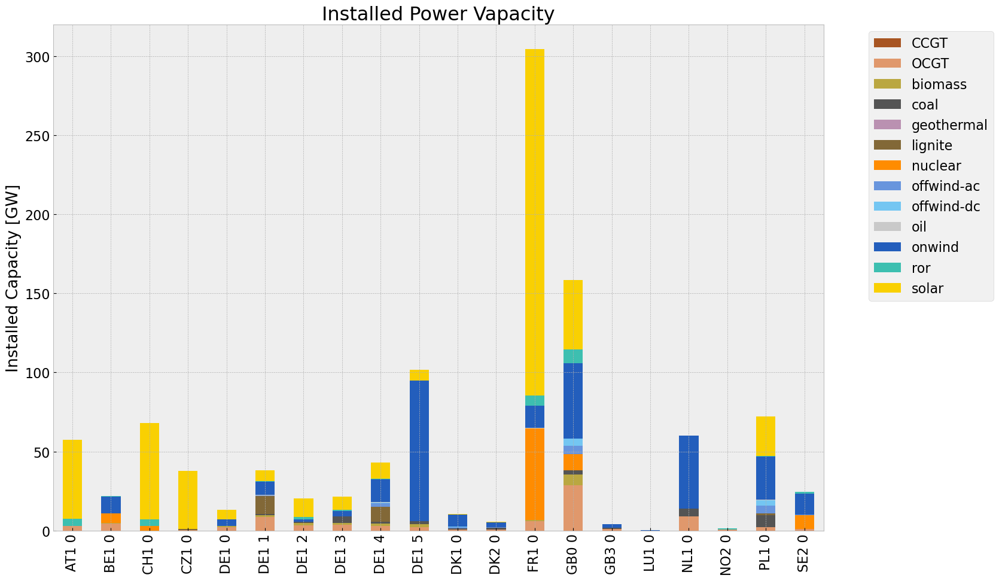

<Figure size 640x480 with 0 Axes>

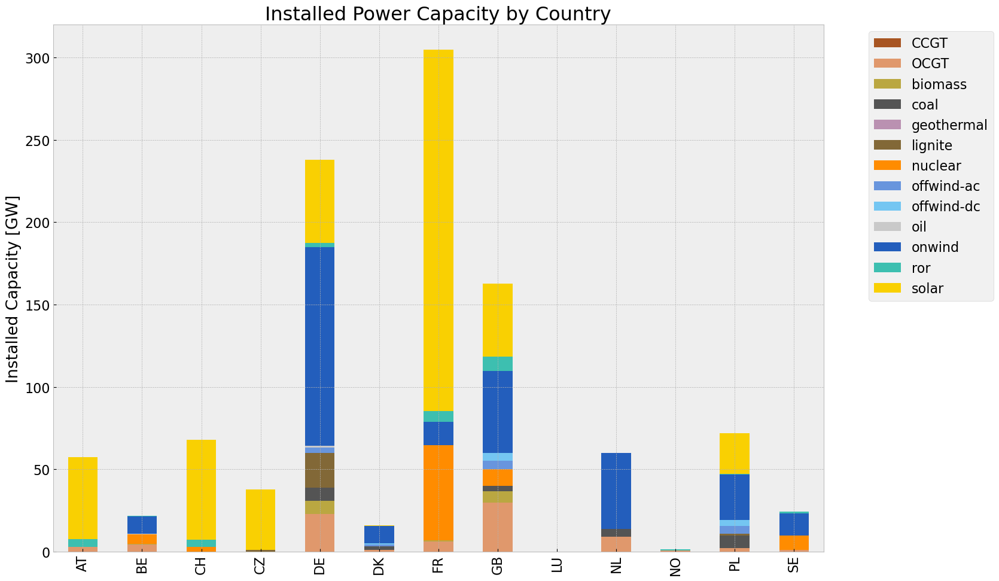

<Figure size 640x480 with 0 Axes>

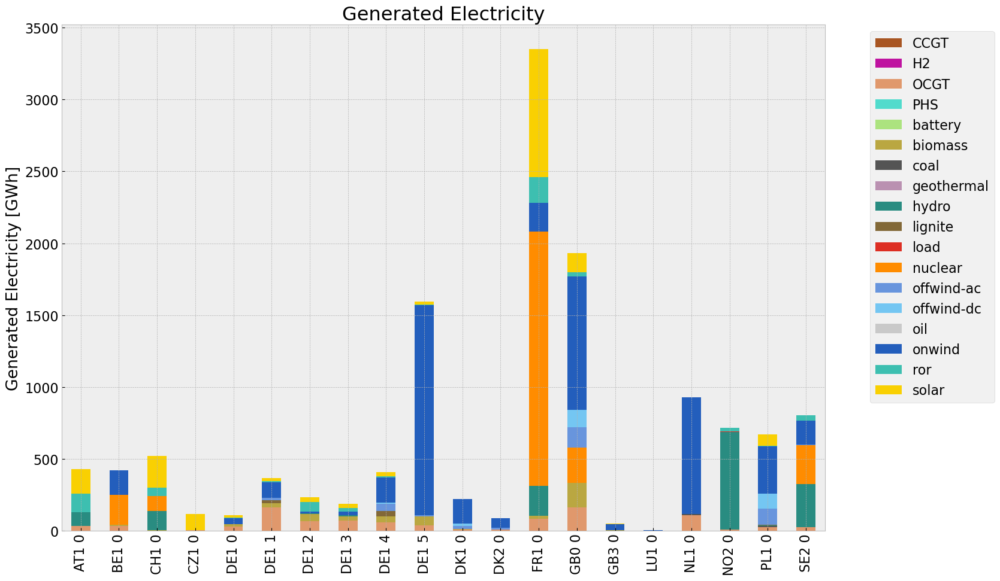

<Figure size 640x480 with 0 Axes>

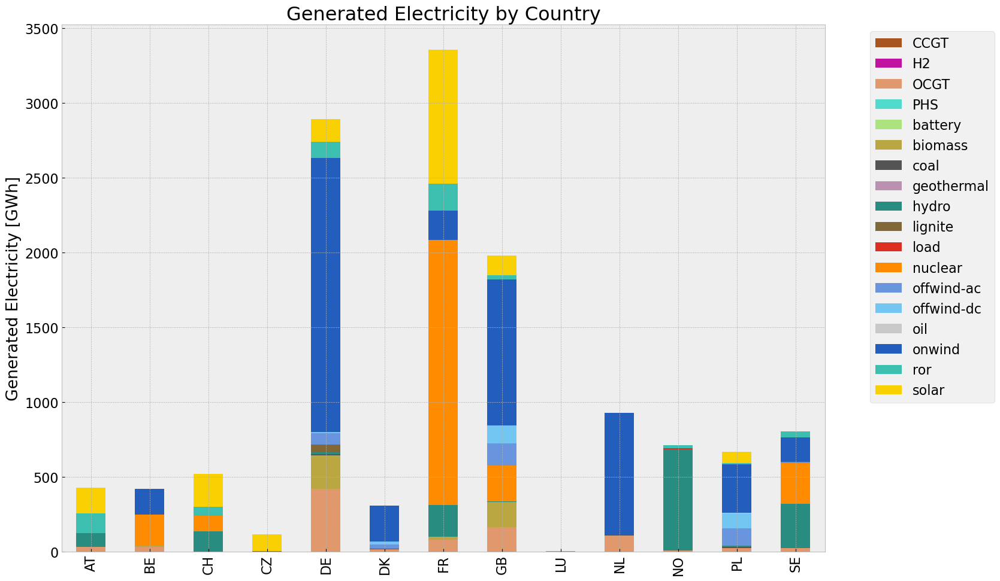

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,9.133610e+05,0.451621,0.1980,400436.524783
biomass,4.264336e+05,0.468000,0.0000,0.000000
coal,2.372017e+04,0.329908,0.3361,24165.368955
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,5.662678e+04,0.337285,0.4069,68314.492979
load,5.550473e+03,1.000000,0.0000,0.000000
nuclear,2.597249e+06,0.326600,0.0000,0.000000
offwind-ac,3.718253e+05,1.000000,0.0000,0.000000


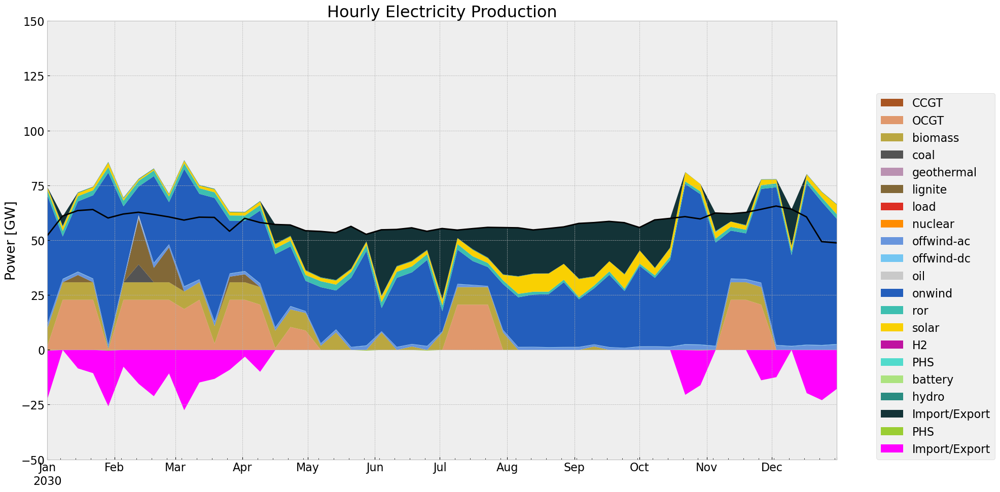

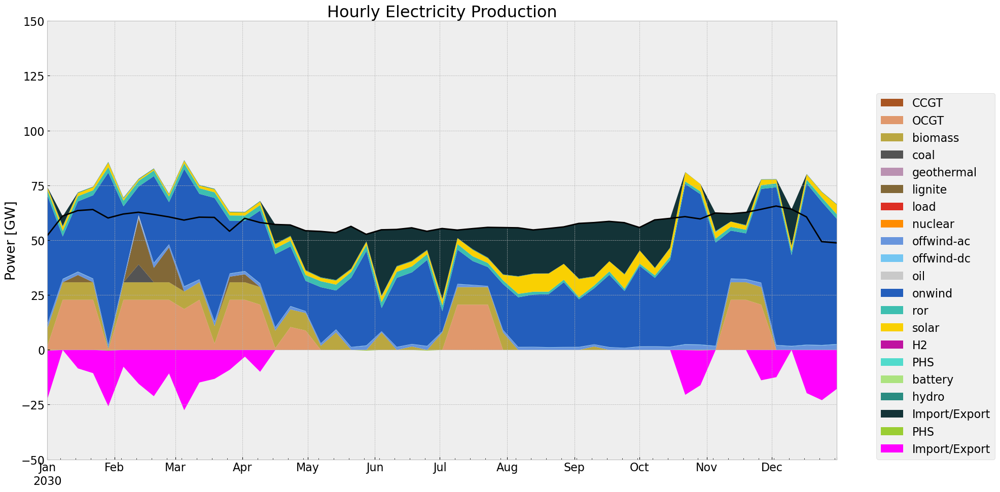

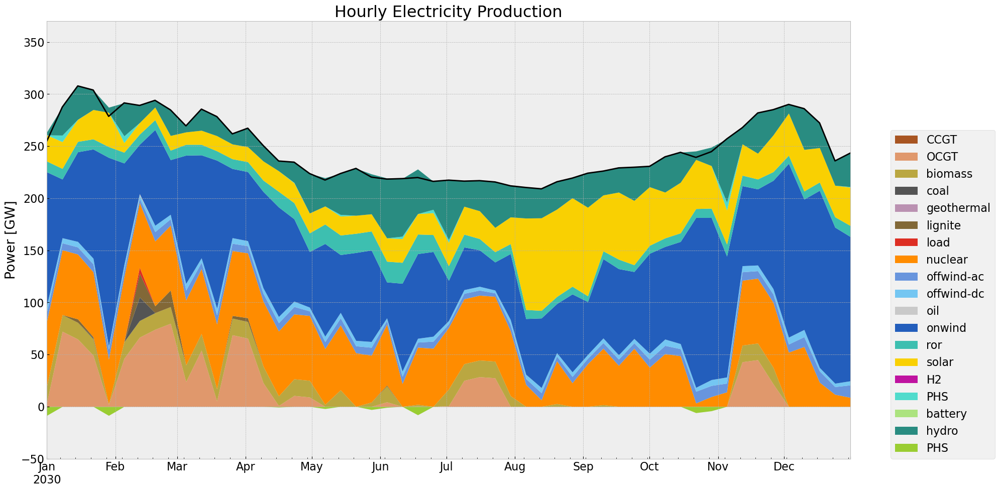

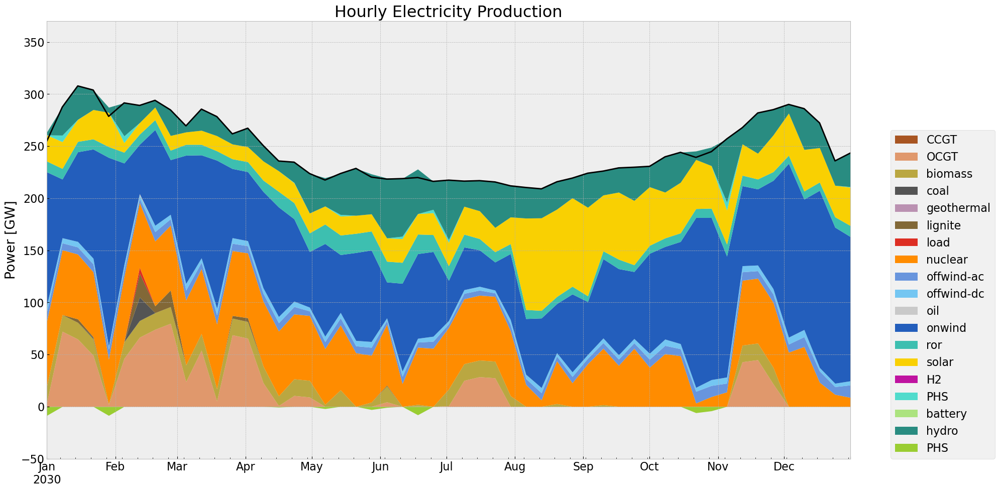

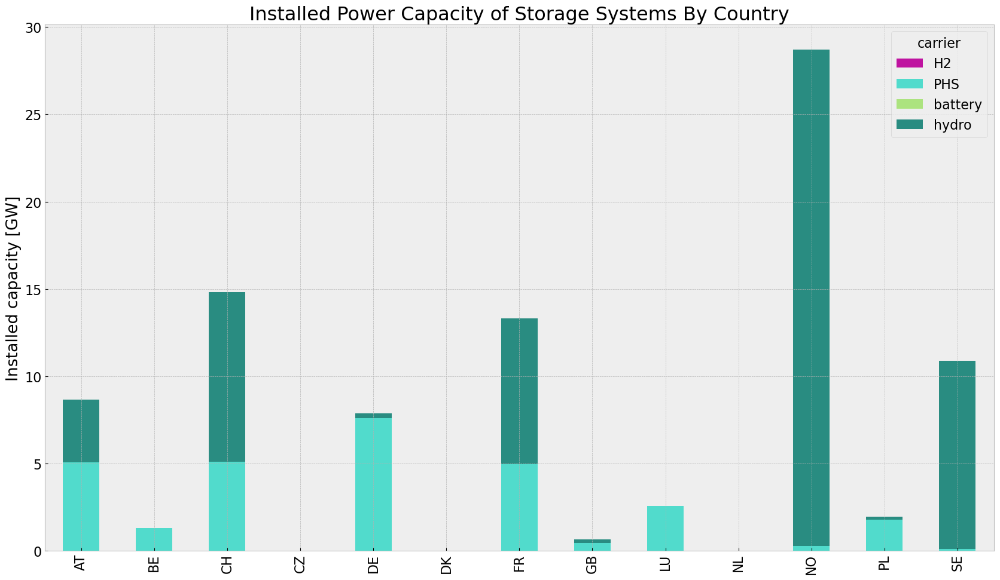

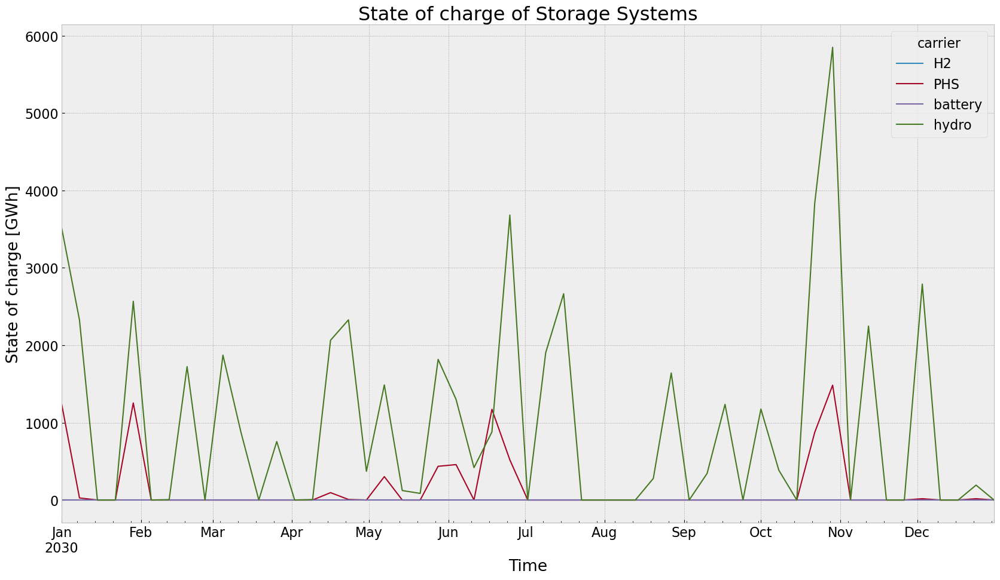

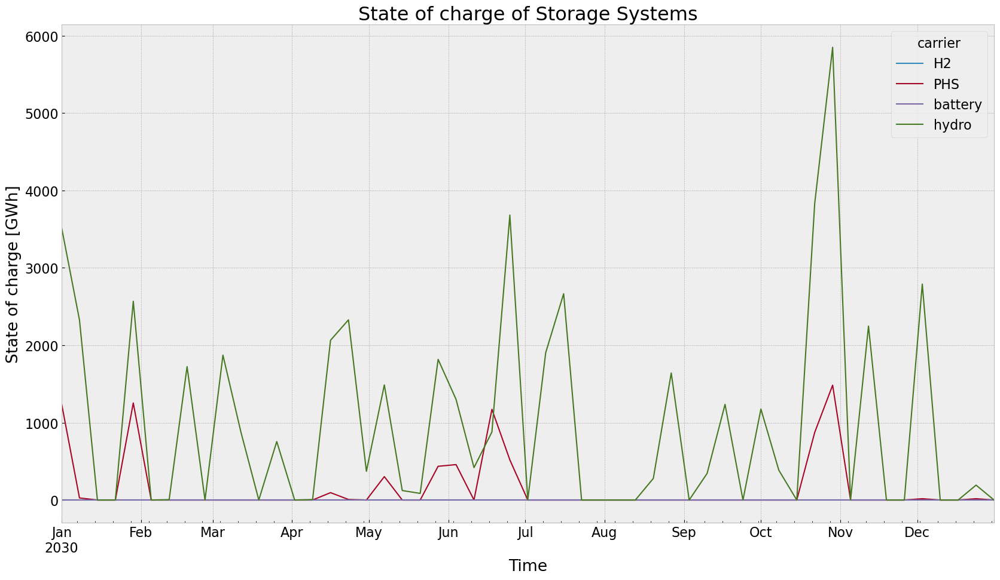

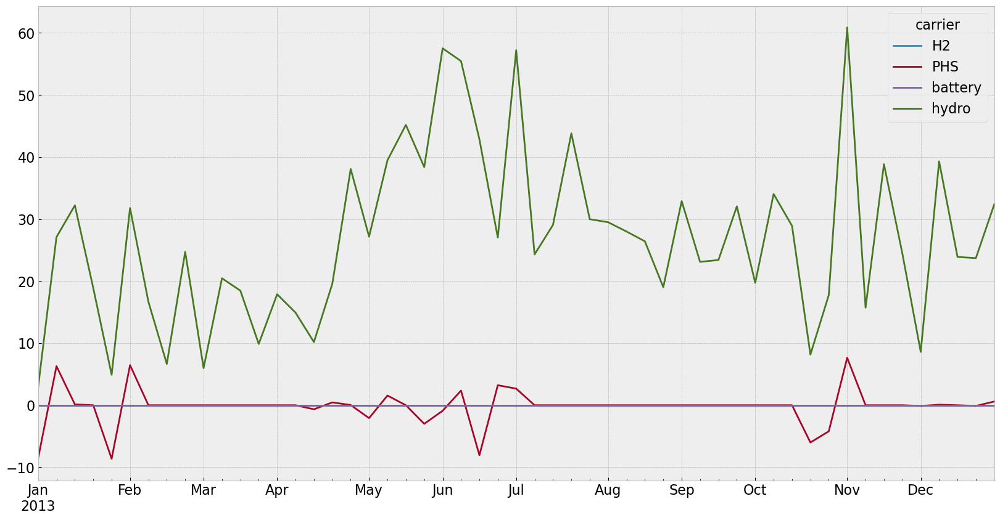

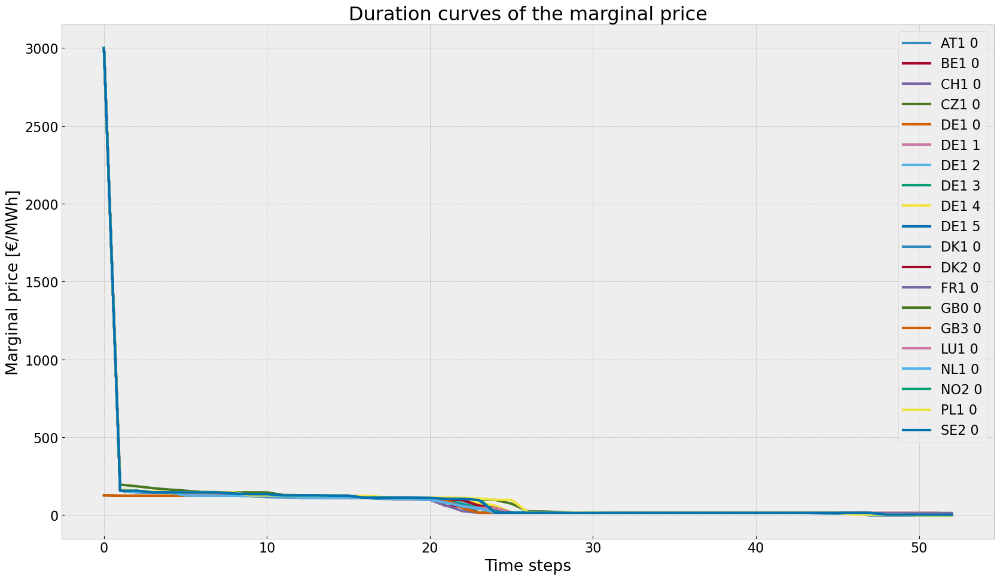

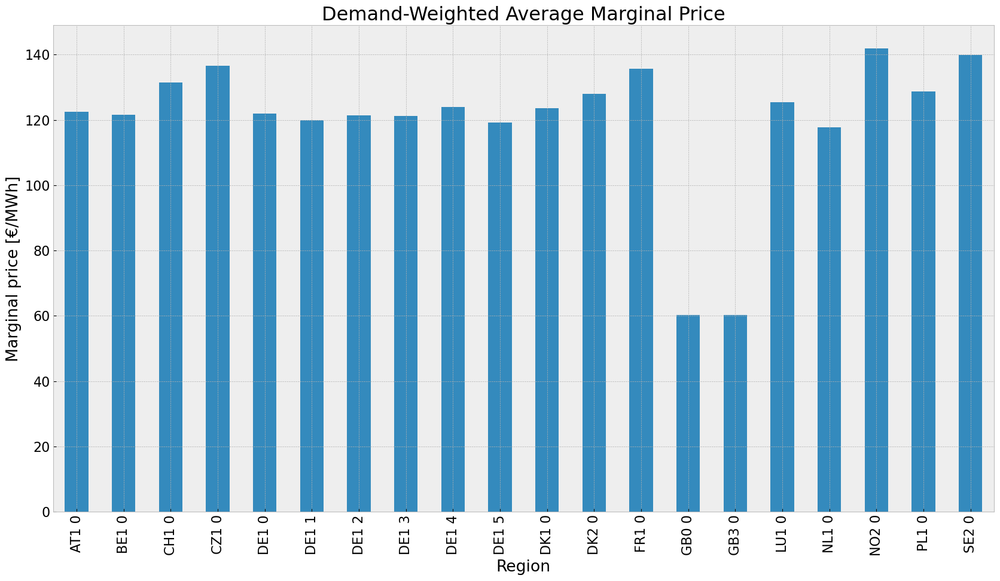

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


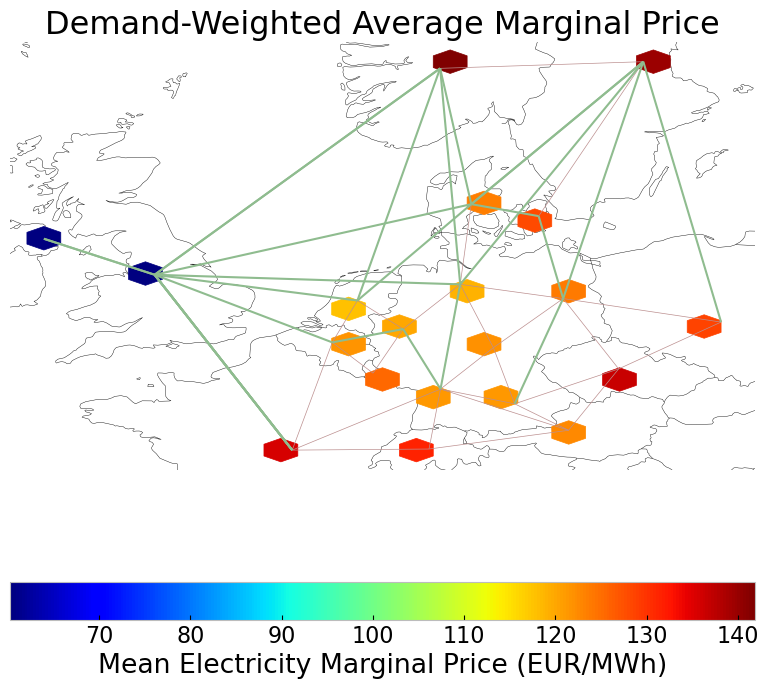

In [81]:

#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_inv_roll  = gen_power_table(n4)
gen_inv_roll_country = gen_power_table_country(n4)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n4, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [82]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

# Scenario Analysis

## Installed Capacity

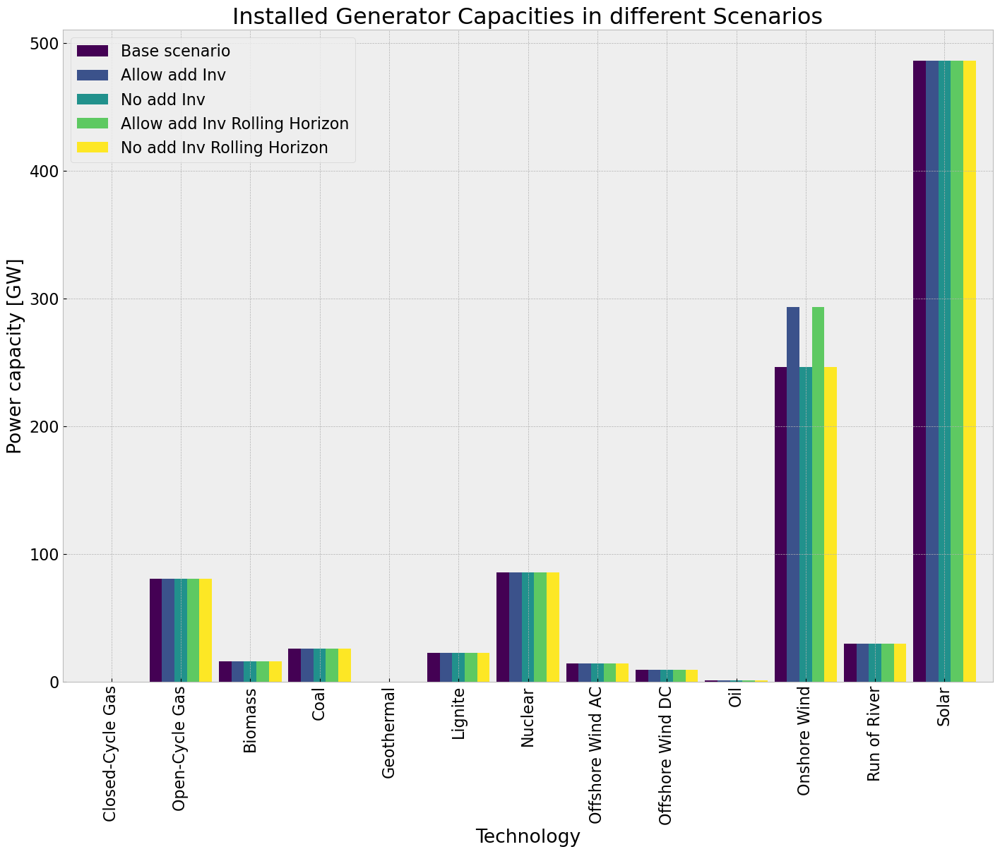

In [83]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

{'AC': '#70af1d', 'DC': '#8a1caf', 'oil': '#c9c9c9', 'CCGT': '#a85522', 'solar': '#f9d002', 'geothermal': '#ba91b1', 'coal': '#545454', 'offwind-ac': '#6895dd', 'onwind': '#235ebc', 'OCGT': '#e0986c', 'nuclear': '#ff8c00', 'lignite': '#826837', 'offwind-dc': '#74c6f2', 'biomass': '#baa741', 'hydro': '#298c81', 'PHS': '#51dbcc', 'ror': '#3dbfb0', '': '', 'battery': '#ace37f', 'H2': '#bf13a0', 'load': '#dd2e23'}


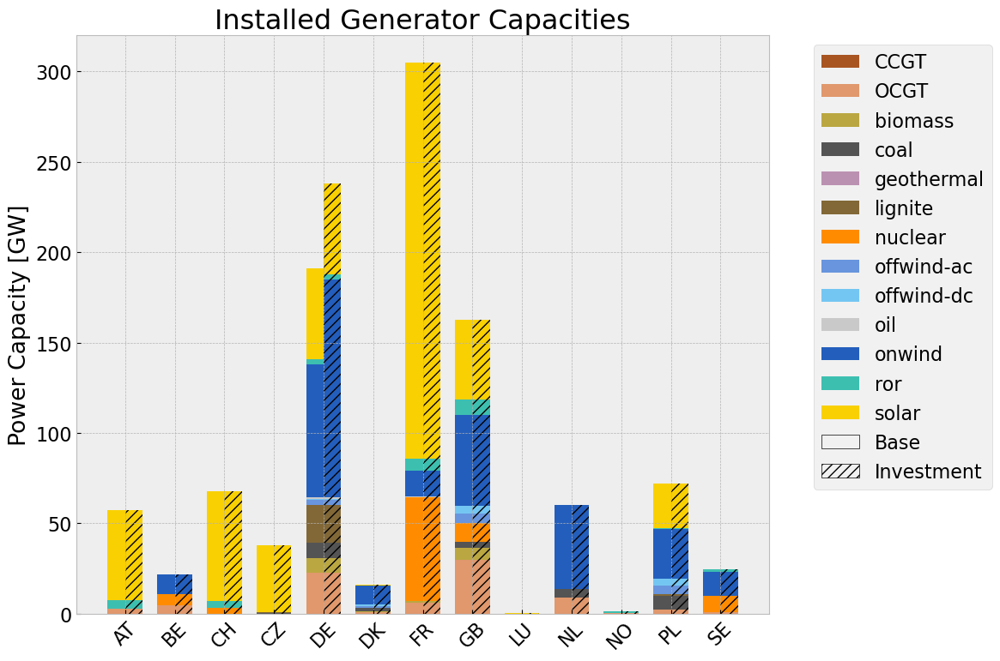

In [84]:
from matplotlib.patches import Patch

color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
print(color_map)

base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

## Power Generation

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2988850123.py:34: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  comp_gen_electr.fillna(0, inplace=True)


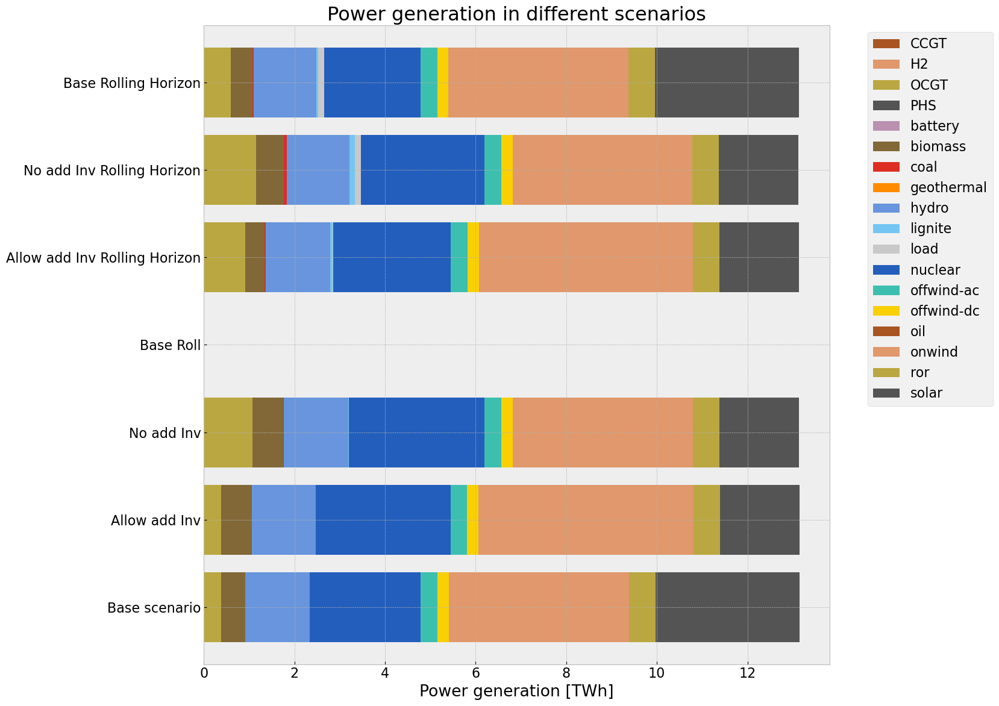

In [85]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Roll","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = gen_base.columns.tolist())

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Base Rolling Horizon"] = gen_base_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

#define color dict for tech
color_dict = {}

for index, row in n.carriers.iterrows():
    key = index
    value = row['color']
    color_dict[key] = value

#color list
colors = [color_dict[cat] for cat in gen_base.columns]

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Installed Storage Capacities

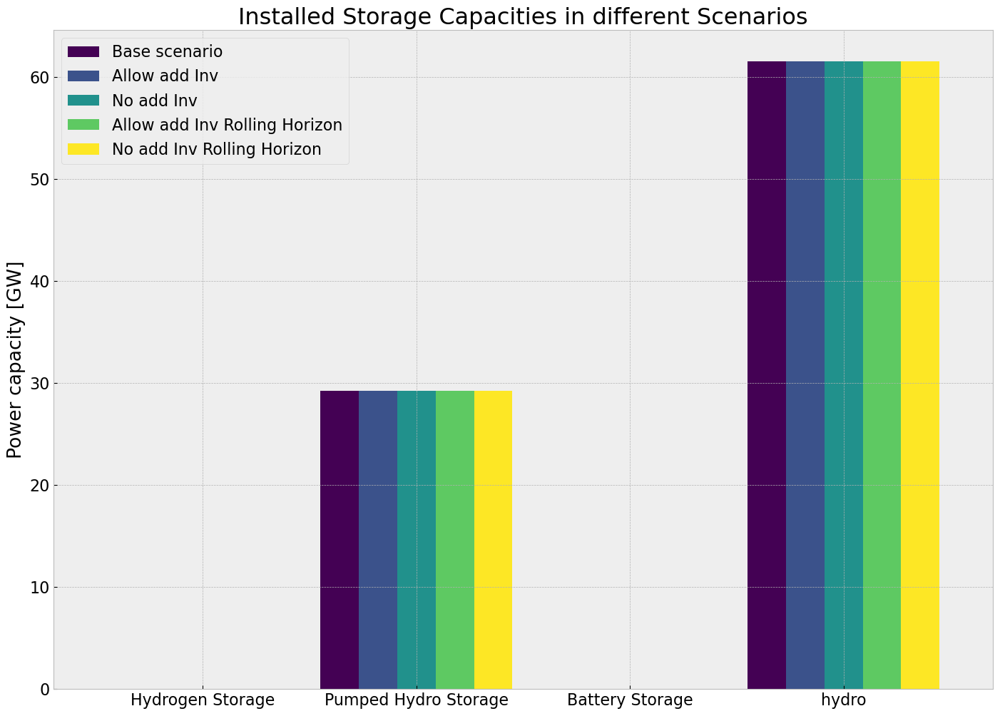

In [86]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

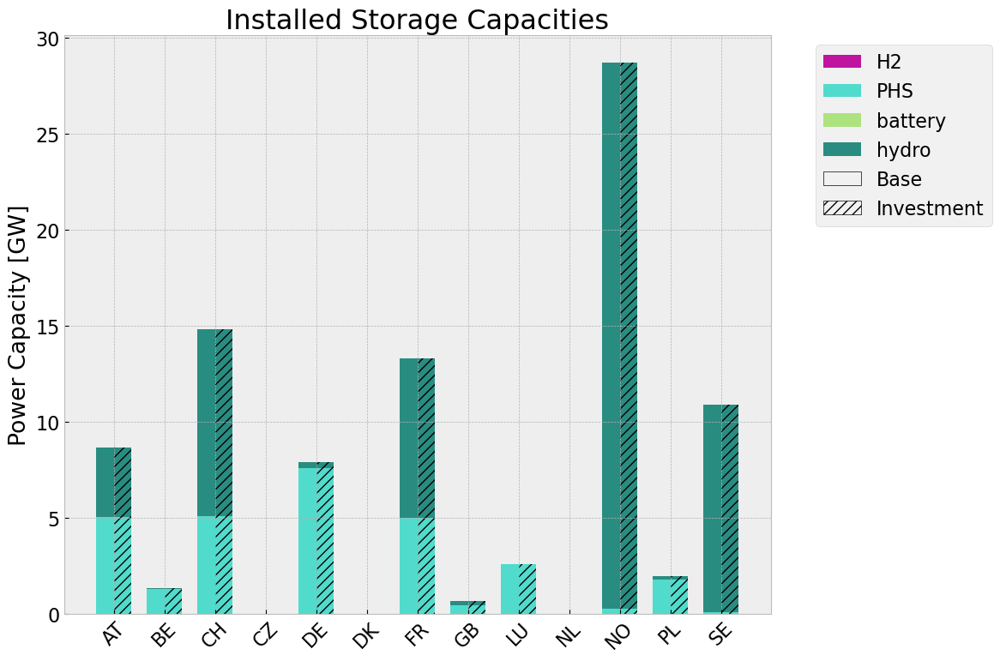

In [87]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [88]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =n.carriers.index)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a
#if tot_cost_0_PV > 0: 
#    comp_system_cost.loc["0% PV potential"] = system_cost_0_PV # Million €/a
#else: comp_system_cost.loc["0% PV potential"] = 0.0
#if tot_cost_20_PV > 0: 
#    comp_system_cost.loc["20% PV potential"] = system_cost_20_PV # Million €/a
#else: comp_system_cost.loc["20% PV potential"] = 0.0
comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Base Rolling Horizon"] = system_cost_base_roll # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'load'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\273893423.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


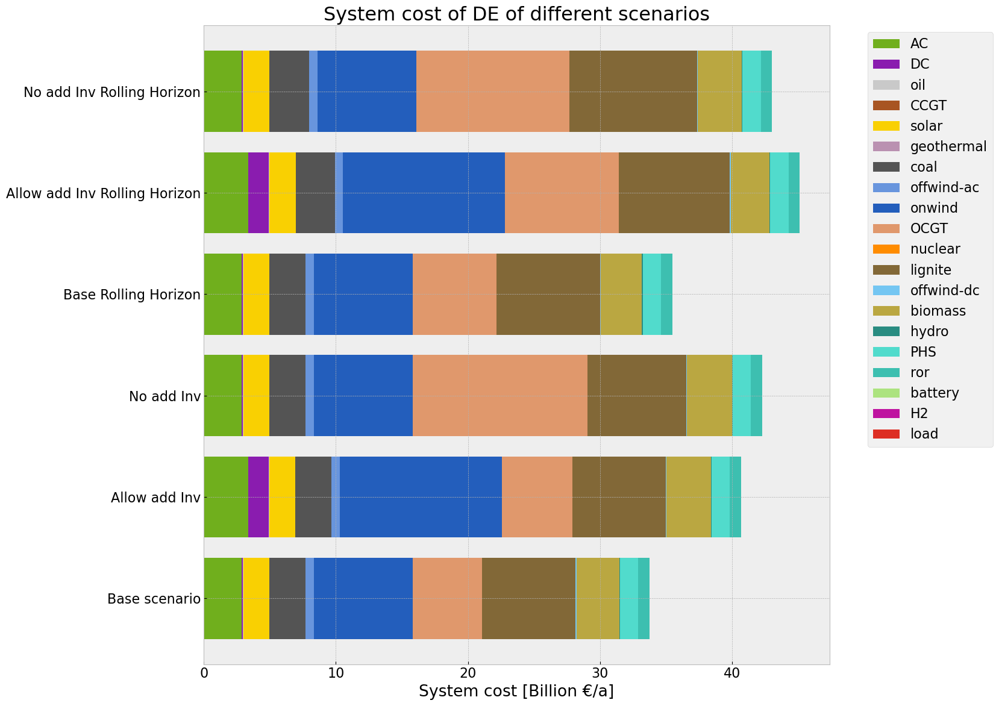

In [89]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_cost.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of {country_cost} of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_system_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Curtailment

In [90]:
comp_curtailment = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = stat_base.loc["Generator"].index)

comp_curtailment.loc["Base scenario"] = stat_base.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv"] = stat_inv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv"] = stat_noinv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Base Rolling Horizon"] = stat_base_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv Rolling Horizon"] = stat_inv_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv Rolling Horizon"] = stat_noinv_roll.loc["Generator"].Curtailment.div(1e6) # TWh

comp_curtailment.fillna(0, inplace=True)

In [91]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3109801822.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3109801822.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_curtailment.append(n.carriers.color[j])


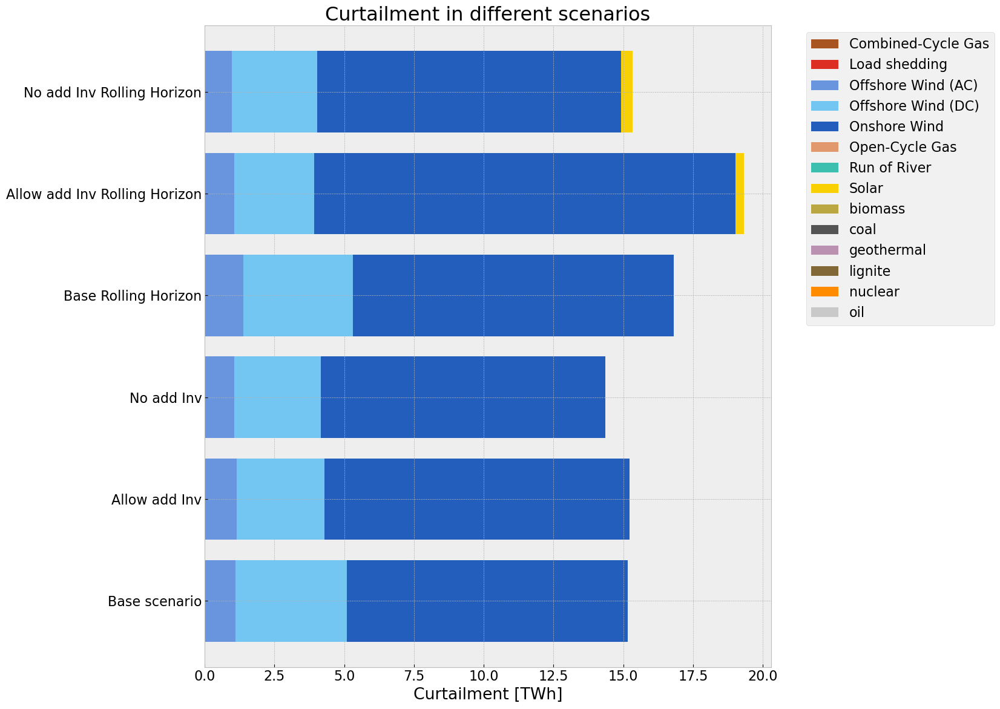

In [92]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Emission

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3480178836.py:21: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


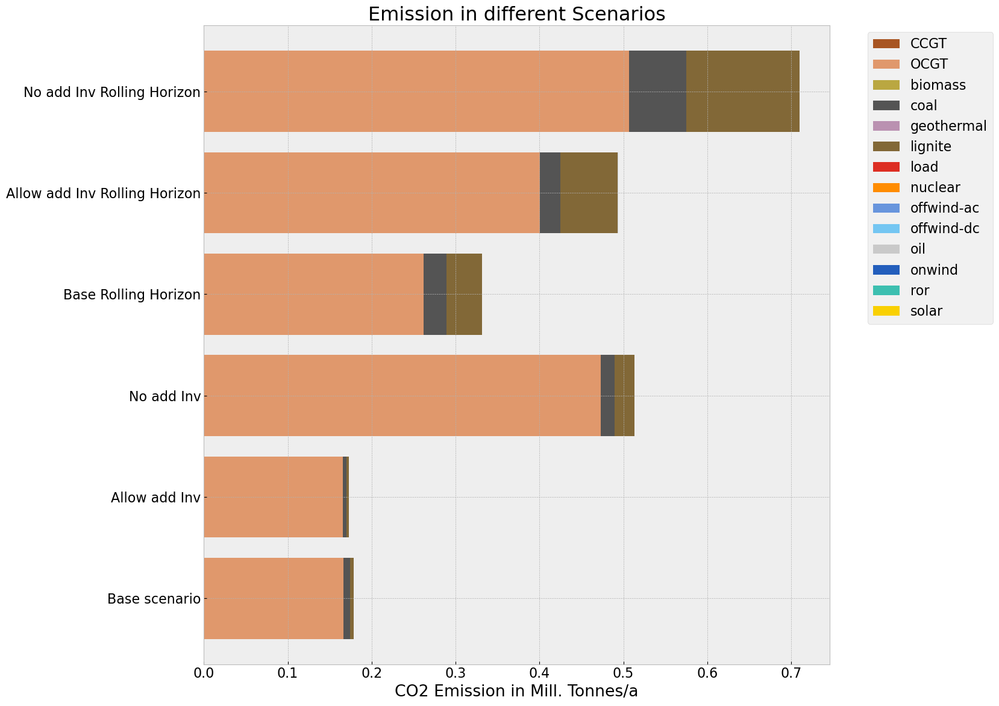

In [93]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Base Rolling Horizon"] = em_base_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Transmission Lines

In [94]:
models = [n, n1, n2, n4]

In [95]:
model_trans = [n,n1]
for m in model_trans:
    #create empty df
    trans_df = {
        'Country' : cap_base_country.index,
        'AC': np.zeros(len(cap_base_country.index)),
        'DC': np.zeros(len(cap_base_country.index))
    }

    trans_df = pd.DataFrame(trans_df)
    trans_df.set_index('Country', inplace=True)
    
    #AC
    ac_df = m.lines
    ac_df['country'] = ac_df['bus0'].str[:2]
    ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
    ac_df.fillna(0, inplace=True)
    ac_df = ac_df.unstack().div(1e3) #GVA
            
    #DC
    dc_df = m.links
    dc_df['country'] = dc_df['bus0'].str[:2]
    dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
    dc_df.fillna(0, inplace=True)
    dc_df = dc_df.unstack().div(1e3) #GW

    #fill empty df with AC Cap
    for index, row in trans_df.iterrows():
        if index in ac_df.index:
            try:
                trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
            except KeyError: 
                trans_df.loc[index, 'AC'] = 0

    #fill empty df with DC Cap
    for index, row in trans_df.iterrows():
        if index in dc_df.index:
            try:
                trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
            except KeyError: 
                trans_df.loc[index, 'DC'] = 0


    #trans_df = pd.concat([ac_df, dc_df], axis=1)
    #trans_df.fillna(0, inplace=True)
    globals()[f'trans_{m.name}'] = trans_df

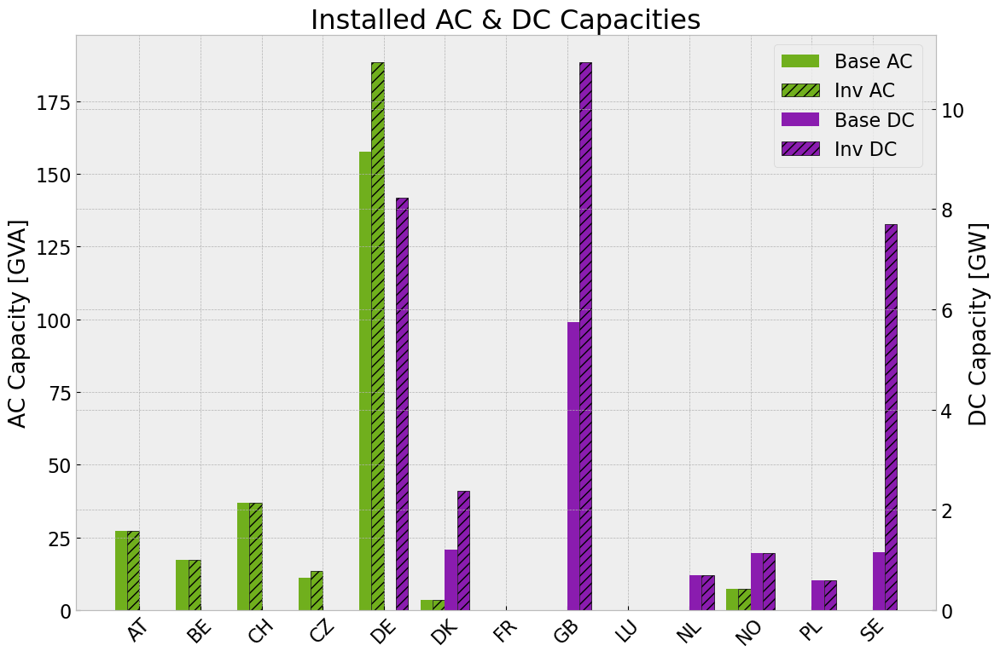

In [96]:
# Setting up bar plot parameters
bar_width = 0.2
indices = np.arange(len(trans_base_pv.index))
base_ac_indices = indices - bar_width * 1.5  # Shift slightly to the left
inv_ac_indices = indices - bar_width * 0.5  # Shift slightly to the right
base_dc_indices = indices + bar_width * 0.5
inv_dc_indices = indices + bar_width * 1.5

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Create secondary axis
ax2 = ax.twinx()

# Plot the base DataFrame (no hatching)
ax.bar(base_ac_indices, trans_base_pv.AC, bar_width, color = n.carriers.loc['AC','color'], label='Base AC')
ax2.bar(base_dc_indices, trans_base_pv.DC, bar_width, color = n.carriers.loc['DC','color'], label='Base DC')

# Plot the inv DataFrame (with hatching)
ax.bar(inv_ac_indices, trans_inv_pv.AC, bar_width, label='Inv AC', edgecolor = 'black', color = n.carriers.loc['AC','color'], hatch='///')
ax2.bar(inv_dc_indices, trans_inv_pv.DC, bar_width, label='Inv DC', edgecolor = 'black', color = n.carriers.loc['DC','color'], hatch='///')


# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + ax2.get_legend_handles_labels()[0]

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(0.8, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed AC & DC Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(trans_base_pv.index, rotation=45)
ax.set_ylabel('AC Capacity [GVA]')
ax2.set_ylabel('DC Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_trans_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

In [97]:
for index, row in n.links.iterrows():
    pnomoptn = n.links.at[index,'p_nom_opt']
    pnomoptn1 = n1.links.at[index,'p_nom_opt']
    bus0 = row['bus0']
    bus1 = row['bus1']
    if 'DE' in bus0 or 'DE' in bus1:
        print(f'{bus0},{bus1}: {index}, p_nom_opt: {pnomoptn}, {pnomoptn1}')

DE1 1,BE1 0: 14801, p_nom_opt: 0.0, 1234.1569438363342
DK2 0,DE1 4: 14824, p_nom_opt: 600.0, 1780.93810926015
SE2 0,DE1 5: 5601, p_nom_opt: 600.0, 1373.4685633913132
DE1 5,NO2 0: 14848, p_nom_opt: 0.0, 6987.360120926
DE1 4,DE1 2: T10, p_nom_opt: 0.0, 0.0
SE2 0,DE1 4: T16, p_nom_opt: 0.0, 5770.6848823140235
DE1 5,DE1 3: T18, p_nom_opt: 0.0, 0.0
DE1 1,DE1 3: T20, p_nom_opt: 0.0, 0.0
GB0 0,DE1 5: T22, p_nom_opt: 0.0, 5171.76956223703


# Sensitivity Analysis

In [98]:
sens_reductionto = [0.5, reductionto,0]

sens_duration = [
    int(duration-(0.5*duration)),
    duration,
    int(duration+(0.5*duration)) 
]

#### Create and Solve Models

In [99]:
def sanitize_variable_name(name):
    """
    Sanitize a string to be used as a valid Python variable name.

    Args:
    name (str): The name to sanitize.

    Returns:
    str: A sanitized name.
    """
    # Replace periods and hyphens with underscores
    return name.replace('.', '_').replace('-', '_')

In [100]:
# Assuming sens_reductionto and sens_duration are defined and iterable

for red in sens_reductionto:
    for dur in sens_duration:
        name = f'n_{red}_{dur}'

        # Skip iteration if both conditions are met
        if red == reductionto and dur == duration:
            continue

        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        # Variable names for models
        inv_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv'
        inv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'
        noinv_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
        noinv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'

        # Create inv model with perfect foresight
        globals()[inv_model_name] = pvscenario(n, cut_start, dur, red)
        allow_inv(globals()[inv_model_name], n, country)
        globals()[inv_model_name].name = inv_model_name
        print(globals()[inv_model_name].name)

        # Solve and export
        filename = f'{globals()[inv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[inv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[inv_model_name].name}.nc does not exist in current wd')
            globals()[inv_model_name].export_to_netcdf(output_path)
        

        # Create inv model rolling horizon
        globals()[inv_roll_model_name] = globals()[inv_model_name].copy()
        no_inv(globals()[inv_roll_model_name], globals()[inv_model_name])
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[inv_roll_model_name].name = inv_roll_model_name
        print(globals()[inv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[inv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[inv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[inv_roll_model_name].name}.nc does not exist in current wd')
            globals()[inv_roll_model_name].export_to_netcdf(output_path)

        # Create noinv model perfect foresight
        globals()[noinv_model_name] = pvscenario(n, cut_start, dur, red)
        no_inv(globals()[noinv_model_name], n)
        globals()[noinv_model_name].name = noinv_model_name
        print(globals()[noinv_model_name].name)

        # Solve and export
        filename = f'{globals()[noinv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[noinv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[noinv_model_name].name}.nc does not exist in current wd')
            globals()[noinv_model_name].export_to_netcdf(output_path)

        # Create noinv model rolling horizon
        globals()[noinv_roll_model_name] = globals()[noinv_model_name].copy()
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[noinv_roll_model_name].name = noinv_roll_model_name
        print(globals()[noinv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[noinv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[noinv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[noinv_roll_model_name].name}.nc does not exist in current wd')
            globals()[noinv_roll_model_name].export_to_netcdf(output_path)

n_0_5_90_inv


INFO:pypsa.io:Imported network n_0_5_90_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_5_90_inv_roll


INFO:pypsa.io:Imported network n_0_5_90_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_5_90_noinv


INFO:pypsa.io:Imported network n_0_5_90_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_90_noinv_roll


INFO:pypsa.io:Imported network n_0_5_90_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_180_inv


INFO:pypsa.io:Imported network n_0_5_180_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_5_180_inv_roll


INFO:pypsa.io:Imported network n_0_5_180_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_5_180_noinv


INFO:pypsa.io:Imported network n_0_5_180_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_180_noinv_roll


INFO:pypsa.io:Imported network n_0_5_180_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_270_inv


INFO:pypsa.io:Imported network n_0_5_270_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_5_270_inv_roll


INFO:pypsa.io:Imported network n_0_5_270_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_5_270_noinv


INFO:pypsa.io:Imported network n_0_5_270_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_270_noinv_roll


INFO:pypsa.io:Imported network n_0_5_270_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_90_inv


INFO:pypsa.io:Imported network n_0_25_90_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_25_90_inv_roll


INFO:pypsa.io:Imported network n_0_25_90_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_25_90_noinv


INFO:pypsa.io:Imported network n_0_25_90_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_90_noinv_roll


INFO:pypsa.io:Imported network n_0_25_90_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_270_inv


INFO:pypsa.io:Imported network n_0_25_270_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_25_270_inv_roll


INFO:pypsa.io:Imported network n_0_25_270_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_25_270_noinv


INFO:pypsa.io:Imported network n_0_25_270_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_270_noinv_roll


INFO:pypsa.io:Imported network n_0_25_270_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_90_inv


INFO:pypsa.io:Imported network n_0_90_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_90_inv_roll


INFO:pypsa.io:Imported network n_0_90_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_90_noinv


INFO:pypsa.io:Imported network n_0_90_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_90_noinv_roll


INFO:pypsa.io:Imported network n_0_90_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_180_inv


INFO:pypsa.io:Imported network n_0_180_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_180_inv_roll


INFO:pypsa.io:Imported network n_0_180_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_180_noinv


INFO:pypsa.io:Imported network n_0_180_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_180_noinv_roll


INFO:pypsa.io:Imported network n_0_180_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_270_inv


INFO:pypsa.io:Imported network n_0_270_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_270_inv_roll


INFO:pypsa.io:Imported network n_0_270_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_270_noinv


INFO:pypsa.io:Imported network n_0_270_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_270_noinv_roll


INFO:pypsa.io:Imported network n_0_270_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [101]:
# import initial models and give uniformed name
models =['inv', 'inv_roll', 'noinv', 'noinv_roll']

for red in sens_reductionto:
    for dur in sens_duration:
        for mod in models:
            
            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))
            
            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 
            
            # copy model from intial model
            if red == reductionto and dur == duration:
                if mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv':
                    filename = 'inv_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv':
                    filename = 'noinv_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv_roll':
                    filename = 'noinv_roll_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv_roll':
                    filename = 'inv_roll_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'

INFO:pypsa.io:Imported network inv_pv.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network inv_roll_pv.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_pv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_roll_pv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Saved Cost by Investing

In [102]:
#create senscost df and addcost df
senscost_df = pd.DataFrame(index = sens_reductionto)
addcost_df = pd.DataFrame(index = sens_reductionto)
for i in sens_duration:
    senscost_df[f'saved cost (dur: {i} days)'] = pd.NA
    addcost_df[f'added cost (dur: {i} days)'] = pd.NA

In [103]:
 #cost saved by investment
#senscost_df.reindex(columns=sens_duration)
#addcost_df = pd.DataFrame(index = sens_reductionto) #cost saved by investment
#addcost_df.reindex(columns=sens_duration)

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            #model as variable
            model =  globals()[mod_name]

            #create cost data frame
            globals()[f'tot_cost_{mod_name}'] = model.objective/1e9 # billion €
            globals()[f'system_cost_{mod_name}'] = system_cost(model, country_cost) #million€/a
            globals()[f'marg_price_{mod_name}'] = model.buses_t.marginal_price.mean()
            globals()[f'stat_{mod_name}']= model.statistics()

            if mod == 'inv_roll' or mod == 'noinv_roll':
                try:
                    # calc tot system cost for noinv_roll and inv_roll models
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_inv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_noinv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
                except KeyError as e:
                    print(f"KeyError: {e} not found in globals()")

            #calculate cost saved in the rolling horizon models
            #if f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum' in globals() and f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum' in globals():
                #globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']
                #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
                
            #else:
                #continue

column_order = []

for red in sens_reductionto:
    for dur in sens_duration:
        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
        #calc saved cost
        globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])/1e3 #Bill€/a
        
        #calc additional investment cost
        globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']-system_cost_base_roll.sum())/1e3 #Bill€/a -
        #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
        
        #addcost_df.loc[]
        
        addcost_df.loc[red,f'added cost (dur: {dur} days)'] = globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a

        senscost_df.loc[red,f'saved cost (dur: {dur} days)'] = globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a
        

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)


KeyError: 'system_cost_n_0_5_90_noinv_roll' not found in globals()


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, se

KeyError: 'system_cost_n_0_5_180_noinv_roll' not found in globals()


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, se

KeyError: 'system_cost_n_0_5_270_noinv_roll' not found in globals()


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, se

KeyError: 'system_cost_n_0_25_90_noinv_roll' not found in globals()


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, se

KeyError: 'system_cost_n_0_25_180_noinv_roll' not found in globals()


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, se

KeyError: 'system_cost_n_0_25_270_noinv_roll' not found in globals()


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, se

KeyError: 'system_cost_n_0_90_noinv_roll' not found in globals()


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, se

KeyError: 'system_cost_n_0_180_noinv_roll' not found in globals()


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, se

KeyError: 'system_cost_n_0_270_noinv_roll' not found in globals()


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\785937434.py:33: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cost_df = cost_df.fillna(0)


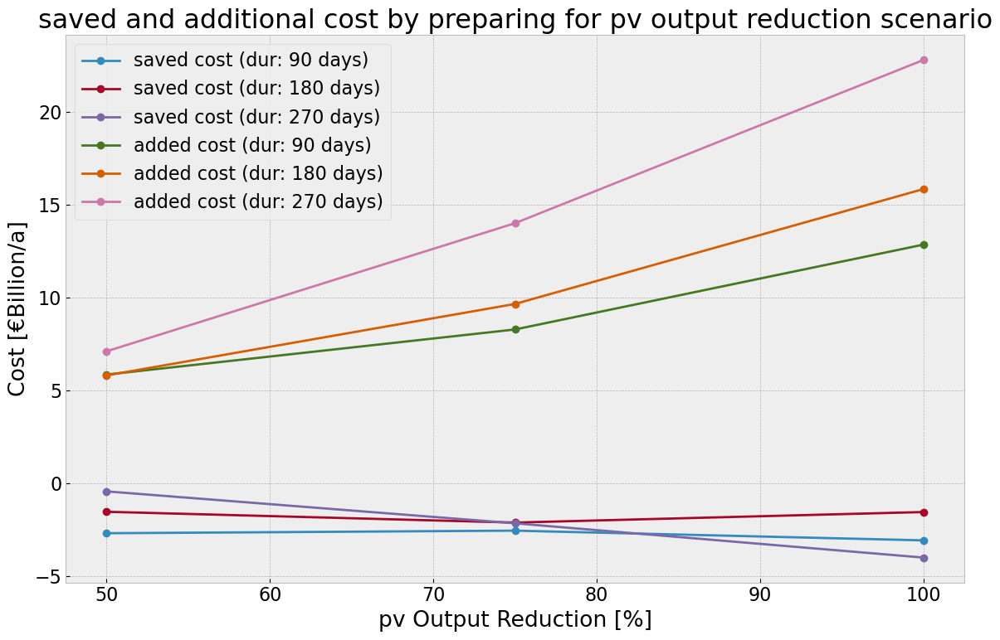

In [104]:
#rename index
cost_df = pd.concat([senscost_df, addcost_df], axis=1)

new_index = [(x - 1) * -100 for x in sens_reductionto]
cost_df.index = new_index


# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Plot each column in the DataFrame
for column in cost_df.columns:
    ax.plot(cost_df.index, cost_df[column], marker='o', label=column)

# Add labels and legend
ax.set_xlabel(f'{contingency} Output Reduction [%]')
ax.set_ylabel('Cost [€Billion/a]')
ax.set_title(f'saved and additional cost by preparing for {contingency} output reduction scenario')
ax.legend()

# Show the plot
plt.xticks()  # Rotate x-axis labels if necessary
plt.tight_layout()  # Adjust layout to make room for labels

# Save plot to the current working directory
filename = f"sens_saved_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()



### Built Generator & Storage Capacities

In [105]:
#create a country based generator capacity df for every investment models 
modname_iteration = []
red_iteration = []
dur_iteration = []

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            
            #model as variable
            model =  globals()[mod_name]

            if mod == 'inv_roll':
                #append modname list
                modname_iteration.append(f'n_{red_sanitized}_{dur_sanitized}_inv_roll')
                red_iteration.append(red)
                dur_iteration.append(dur)

                # cap table
                capacities = model.generators
                capacities['country'] = capacities['bus'].str[:2]
                capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
                capacities.fillna(0, inplace=True)
                #print(capacities)
                globals()[f'{mod_name}_cap_country'] = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
                globals()[f'{mod_name}_cap_country'].fillna(0, inplace=True)

                #sto table
                storage = n.storage_units
                storage['country'] = storage['bus'].str[:2]

                globals()[f'{mod_name}_sto_country'] = (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000) #GW
                globals()[f'{mod_name}_sto_country'].fillna(0, inplace=True)


                #create empty df for transmission
                trans_df = {
                    'Country' : cap_base_country.index,
                    'AC': np.zeros(len(cap_base_country.index)),
                    'DC': np.zeros(len(cap_base_country.index))
                }

                trans_df = pd.DataFrame(trans_df)
                trans_df.set_index('Country', inplace=True)
    
                #AC
                ac_df = model.lines
                ac_df['country'] = ac_df['bus0'].str[:2]
                ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
                ac_df.fillna(0, inplace=True)
                ac_df = ac_df.unstack().div(1e3) #GVA
            
                #DC
                dc_df = model.links
                dc_df['country'] = dc_df['bus0'].str[:2]
                dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
                dc_df.fillna(0, inplace=True)
                dc_df = dc_df.unstack().div(1e3) #GW

                #fill empty df with AC Cap
                for index, row in trans_df.iterrows():
                    if index in ac_df.index:
                        try:
                            trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
                        except KeyError: 
                            trans_df.loc[index, 'AC'] = 0

                #fill empty df with DC Cap
                for index, row in trans_df.iterrows():
                    if index in dc_df.index:
                        try:
                            trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
                        except KeyError: 
                            trans_df.loc[index, 'DC'] = 0


                #trans_df = pd.concat([ac_df, dc_df], axis=1)
                #trans_df.fillna(0, inplace=True)
                globals()[f'{mod_name}_trans'] = trans_df
                #globals()[f'{mod_name}_trans_country'] = trans_df
                

#### Bar Plot

In [106]:
# Define a color map using a color palette with 12 contrasting colors
colors = sns.color_palette("tab20", 13)  # 12 contrasting colors

# Mapping countries to colors
country_colors = {
    'AT': colors[0],
    'BE': colors[1],
    'CH': colors[2],
    'CZ': colors[3],
    'DE': colors[4],
    'DK': colors[5],
    'FR': colors[6],
    'GB': colors[7],
    'LU': colors[8],
    'NL': colors[9],
    'NO': colors[10],
    'PL': colors[11],
    'SE': colors[12]  # Reusing the first color for 'SE' to ensure there are 12 colors
}

In [107]:
extendables = ['OCGT', 'solar','onwind', 'offwind-dc', 'offwind-ac']

for e in extendables:

    e_sanitized = sanitize_variable_name(str(e))

    #Cap Sensitivity df
    globals()[f'sens_{e_sanitized}'] = {
        'Scenario' : ['Base Roll'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_sens_df'] = pd.DataFrame(globals()[f'sens_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if index != 'Base Roll':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_cap_country']

            for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_sens_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_sens_df'].drop(columns = ['Days', 'Reductionto'])
    

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2.8192' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '4.5323' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.1514492675412664' has dtype incompa

In [108]:
extendables_plot = {'OCGT', 'solar', 'onwind', 'offwind'}
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

element_to_ax

{'OCGT': 0, 'solar': 1, 'onwind': 2, 'offwind': 3}

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=

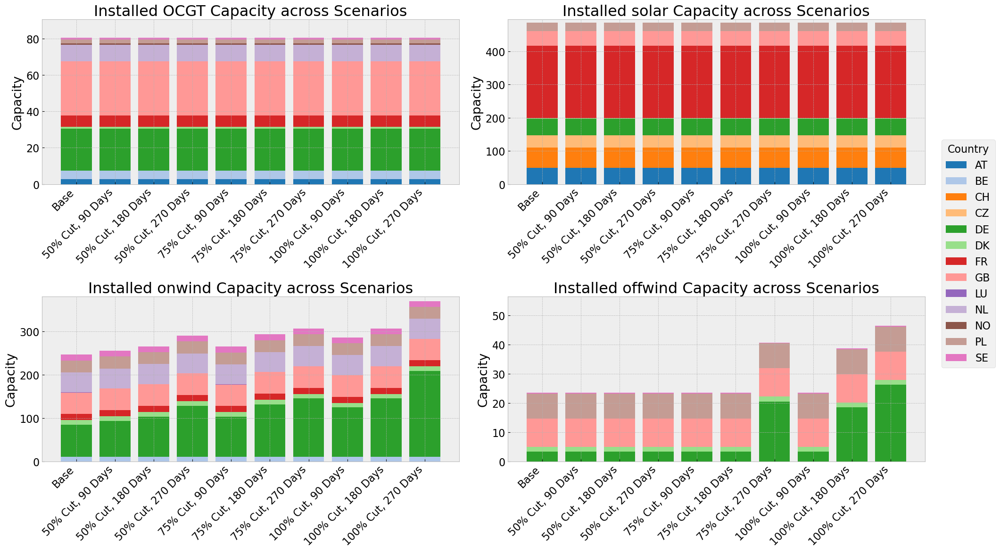

In [109]:
# combine offwind ac and dc
offwind_pivot_df = offwind_ac_pivot_df.select_dtypes(include='number') + offwind_dc_pivot_df.select_dtypes(include='number')
offwind_pivot_df

extendables_plot = ['OCGT', 'solar', 'onwind', 'offwind']

# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()


### Built Storage Capacities

In [110]:
sto_type = n.storage_units.carrier.unique() 

for e in sto_type:

    #e_sanitized = sanitize_variable_name(str(e))

    #sto Sensitivity df
    globals()[f'sens_{e}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e}_sens_df'] = pd.DataFrame(globals()[f'sens_{e}'])

    #add column countries
    for country in store_base_df.index:
        globals()[f'{e}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in store_base_df.index:
        globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e}_sens_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            sto_df =  globals()[f'{mod_name}_sto_country']

            for index, row in globals()[f'{e}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e}_sens_df'].loc[index, i] = sto_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e}_pivot_df'] = globals()[f'{e}_sens_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.057300000000001' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.308' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.089549999999999' has dtype incompatible with int64, please explicitly c

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=

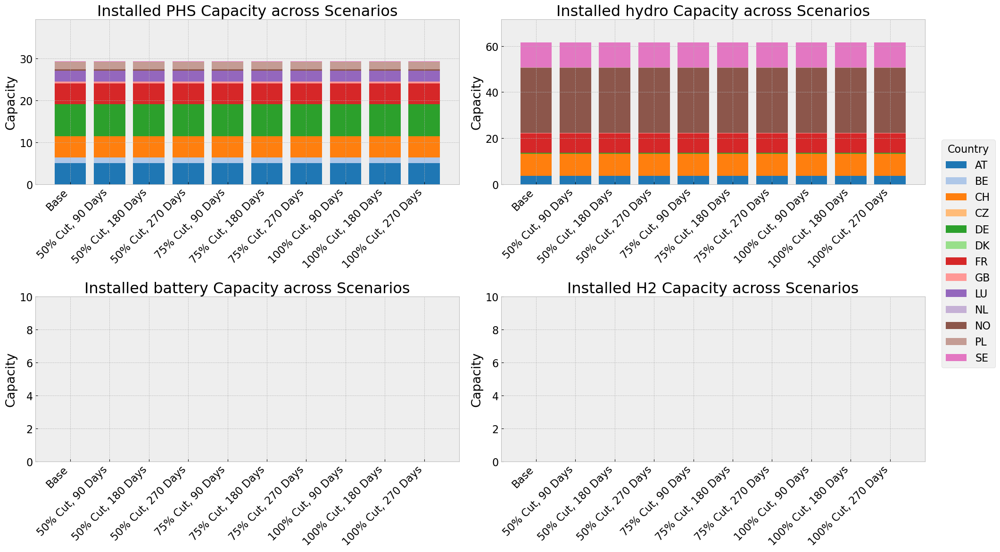

In [111]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(sto_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()

### Transmission Cap

In [112]:
line_type = ['AC', 'DC']

for e in line_type:

    e_sanitized = sanitize_variable_name(str(e))

    #trans Sensitivity df
    globals()[f'trans_{e_sanitized}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_trans_df'] = pd.DataFrame(globals()[f'trans_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_trans_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_trans_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_trans']

            for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_trans_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_trans_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '27.214328698683715' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '17.249147582416935' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '36.91138834993883' has dtype incom

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16244\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')


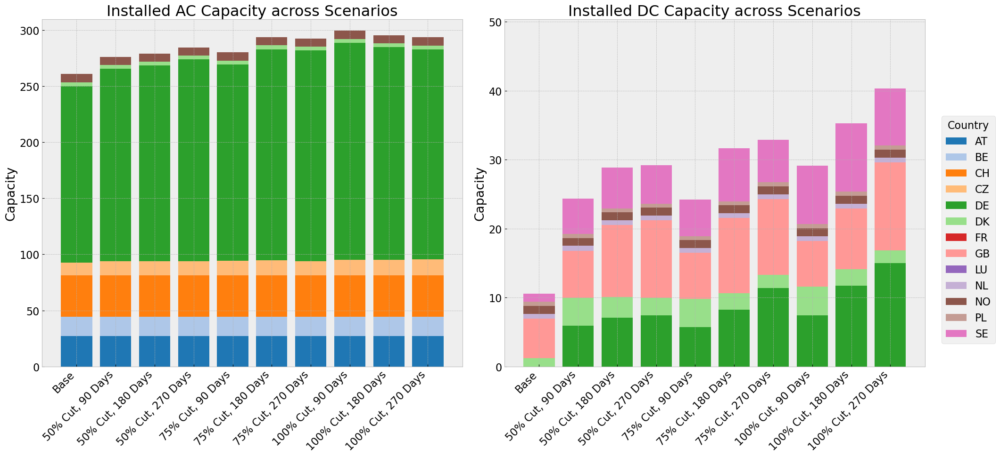

In [113]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20,10))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(line_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()